# Computer Vision final poject  2023-2024 / Weather Classification

In [22]:
import cv2
import os
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import precision_recall_fscore_support
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV

In [23]:
def load_and_preprocess_data(folder_path, target_size=(64, 64)):
    images = []
    labels = []

    #train folder path
    split_path = os.path.join(folder_path, 'train')

    #skip non-directory entries
    if not os.path.exists(split_path):
        print(f"No 'train' folder found in: {folder_path}")
        return np.array(images), np.array(labels)

    #check if the dataset has class folders inside the 'train' folder
    if any(os.path.isdir(os.path.join(split_path, class_name)) for class_name in os.listdir(split_path)):
        # Iterate over classes inside 'train'
        for class_name in os.listdir(split_path):
            class_path = os.path.join(split_path, class_name)

            #skip non-directory entries
            if not os.path.isdir(class_path):
                continue

            #check if the class folder has images(png,jpg,jpeg)
            class_images = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            if not class_images:
                print(f"No images found in class folder: {class_path}")
                continue

            #iterate over images inside class
            for filename in class_images:
                img_path = os.path.join(class_path, filename)

                #load the image
                img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

                #check if the image is loaded successfully
                if img is not None:
                    #Resize to a consistent size
                    img = cv2.resize(img, target_size)

                    #extract label from the image name (excluding numbers and underscores)
                    label = ''.join(filter(str.isalpha, os.path.splitext(filename)[0]))
                    labels.append(label)

                    #flatten the image as a feature vector and append to the list
                    images.append(img.flatten())

    else:
        #iterate over images inside train folder
        for filename in os.listdir(split_path):
            img_path = os.path.join(split_path, filename)

            #skip non-image files
            if not img_path.lower().endswith(('.png', '.jpg', '.jpeg')):
                continue

            #loading the image
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

            #check if the image is loaded successfully
            if img is not None:
                #resize to a consistent size
                img = cv2.resize(img, target_size)

                #extract label from the image name (excluding numbers and underscores)
                label = ''.join(filter(str.isalpha, os.path.splitext(filename)[0]))
                labels.append(label)

                #Flatten the image as a feature vector and append to the list
                images.append(img.flatten())

    return np.array(images), np.array(labels)


In [25]:
#provide the paths to datasets

#dataset1_path = 'MWD'
#dataset2_path = 'ACDC'
dataset3_path = 'syndrone'
#dataset4_path = 'UAVid'

# Load and preprocess each dataset's train samples
#images1, labels1 = load_and_preprocess_data(dataset1_path)
#images2, labels2 = load_and_preprocess_data(dataset2_path)
images3, labels3 = load_and_preprocess_data(dataset3_path)
#images4, labels4 = load_and_preprocess_data(dataset4_path)

# Check the size of each dataset
#print("Size of MWD dataset train samples:", images1.shape, labels1.shape)
#print("Size of  ACDC dataset train samples:", images2.shape, labels2.shape)
print("Size of syndrone dataset train samples:", images3.shape, labels3.shape)
#print("Size of UAVid dataset train samples:", images4.shape, labels4.shape)

# Check if datasets loaded successfully
if images1.size == 0 :#or images2.size == 0 or images3.size == 0 or images4.size == 0:
    print("Error: One or more datasets did not load successfully.")
else:
    print("All datasets loaded successfully.")

# Print unique labels for each dataset
#print("MWD labels :", np.unique(labels1))
#print("ACDC labels :", np.unique(labels2))
print("syndrone labels:", np.unique(labels3))
#print("UAVid labels:", np.unique(labels4))


Size of syndrone dataset train samples: (800, 4096) (800,)
All datasets loaded successfully.
syndrone labels: ['ClearNight' 'ClearNoon' 'HardRainNoon' 'MidFoggyNoon']


In [26]:
#concatenate all training datasets if you want to try it on all uncomment the followings:

#all_images_train = np.concatenate([images1, images2, images3, images4], axis=0)
#all_labels_train = np.concatenate([labels1, labels2, labels3, labels4], axis=0)
#flat_images_train = all_images_train.reshape(all_images_train.shape[0], -1)
#label_encoder_train = LabelEncoder()
#encoded_labels_train = label_encoder_train.fit_transform(all_labels_train)


#in case you want to use one data set for example syndrone run following
#standardize the feature values
# Flatten the training images

flat_images_train = images3.reshape(images3.shape[0], -1)
# Encode labels
label_encoder_train = LabelEncoder()
encoded_labels_train = label_encoder_train.fit_transform(labels3)

scaler = StandardScaler()
flat_images_train_scaled = scaler.fit_transform(flat_images_train)

#create and train the SVM model with an RBF kernel
svm_model_rbf = SVC(kernel='rbf', C=1)
svm_model_rbf.fit(flat_images_train_scaled, encoded_labels_train)

#make predictions on the training set
predictions_train_rbf = svm_model_rbf.predict(flat_images_train_scaled)
accuracy_train_rbf = accuracy_score(encoded_labels_train, predictions_train_rbf)
print(f'Training accuracy (RBF kernel): {accuracy_train_rbf}')

Training accuracy (RBF kernel): 1.0


In [27]:
#create and train the SVM model with different kernel
svm_model_poly = SVC(kernel='poly', degree=1, C=0.1)
svm_model_poly.fit(flat_images_train_scaled, encoded_labels_train)
# Make predictions on the training set
predictions_train_poly = svm_model_poly.predict(flat_images_train_scaled)
accuracy_train_poly = accuracy_score(encoded_labels_train, predictions_train_poly)
print(f'Training accuracy (Poly kernel): {accuracy_train_poly}')
#perform grid search for optimal hyperparameters
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10], 'degree': [1, 2, 3, 4, 5]}
grid_search = GridSearchCV(SVC(kernel='linear'), param_grid, cv=5)
grid_search.fit(flat_images_train_scaled, encoded_labels_train)
best_model = grid_search.best_estimator_
print(best_model)

Training accuracy (Poly kernel): 0.93
SVC(C=0.001, degree=1, kernel='linear')


In [28]:
# Create a Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(flat_images_train_scaled, encoded_labels_train)

# Make predictions on the training set
predictions_train_rf = rf_model.predict(flat_images_train_scaled)
accuracy_train_rf = accuracy_score(encoded_labels_train, predictions_train_rf)
print(f'Training accuracy (Random Forest): {accuracy_train_rf}')

Training accuracy (Random Forest): 1.0


In [29]:
#the load_and_preprocess_data function to use the test folder
def load_and_preprocess_data_test(folder_path, target_size=(64, 64)):
    images = []
    labels = []

    #specify the test folder path
    split_path = os.path.join(folder_path, 'test')

    #skip non-directory entries
    if not os.path.exists(split_path):
        print(f"No 'test' folder found in: {folder_path}")
        return np.array(images), np.array(labels)

    #check if the dataset has class folders inside the 'test' folder
    if any(os.path.isdir(os.path.join(split_path, class_name)) for class_name in os.listdir(split_path)):
        # Iterate over classes inside 'test'
        for class_name in os.listdir(split_path):
            class_path = os.path.join(split_path, class_name)

            #skip non-directory entries
            if not os.path.isdir(class_path):
                continue

            #check if the class folder has images
            class_images = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            if not class_images:
                print(f"No images found in class folder: {class_path}")
                continue

            #Iterate over images inside class
            for filename in class_images:
                img_path = os.path.join(class_path, filename)

                #load the image
                img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

                #check if the image is loaded successfully
                if img is not None:
                    #resize to a consistent size
                    img = cv2.resize(img, target_size)

                    #extract label from the image name (excluding numbers and underscores)
                    label = ''.join(filter(str.isalpha, os.path.splitext(filename)[0]))
                    labels.append(label)

                    #flatten the image as a feature vector and append to the list
                    images.append(img.flatten())

    else:
        #Iterate over images inside 'test'
        for filename in os.listdir(split_path):
            img_path = os.path.join(split_path, filename)

            #Skip non-image files
            if not img_path.lower().endswith(('.png', '.jpg', '.jpeg')):
                continue

            #loading the image
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

            #check if the image is loaded successfully
            if img is not None:
                # Resize to a consistent size
                img = cv2.resize(img, target_size)

                #extract label from the image name (excluding numbers and underscores)
                label = ''.join(filter(str.isalpha, os.path.splitext(filename)[0]))
                labels.append(label)

                #Flatten the image as a feature vector and append to the list
                images.append(img.flatten())

    return np.array(images), np.array(labels)

In [30]:
#provide the paths to your four datasets
#dataset1_path = 'MWD'
#dataset2_path = 'ACDC'
dataset3_path = 'syndrone'
#dataset4_path = 'UAVid'

#load and preprocess each dataset from 'test' folder only

#images1_test, labels1_test = load_and_preprocess_data_test(os.path.join(dataset1_path))
#images2_test, labels2_test = load_and_preprocess_data_test(os.path.join(dataset2_path))
images3_test, labels3_test = load_and_preprocess_data_test(os.path.join(dataset3_path))
#images4_test, labels4_test = load_and_preprocess_data_test(os.path.join(dataset4_path))

In [33]:
# Check the size of each dataset
#print("Size of test samples in MWD dataset:", images1_test.shape, labels1_test.shape)
#print("Size of test samples in ACDC dataset:", images2_test.shape, labels2_test.shape)
print("Size of test samples in syndrone dataset:", images3_test.shape, labels3_test.shape)
#print("Size of test samples in UAVid dataset:", images4_test.shape, labels4_test.shape)

# Check if datasets loaded successfully
if images3_test.size == 0 : #or images2_test.size == 0 or images3_test.size == 0 or images4_test.size == 0:
    print("Error: One or more datasets did not load successfully.")
else:
    print("All datasets loaded successfully.")

# Print unique labels for each dataset
#print("MWD labels:", np.unique(labels1))
#print("ACDC labels:", np.unique(labels2))
print("syndrone labels:", np.unique(labels3))
#print("UAVid labels:", np.unique(labels4))


Size of test samples in syndrone dataset: (400, 4096) (400,)
All datasets loaded successfully.
syndrone labels: ['ClearNight' 'ClearNoon' 'HardRainNoon' 'MidFoggyNoon']


In [36]:
# Concatenate test dataset (only Dataset 3)
all_images_test = np.concatenate([images3_test], axis=0)
all_labels_test = np.concatenate([labels3_test], axis=0)

# Flatten the test images
flat_images_test = all_images_test.reshape(all_images_test.shape[0], -1)

# Encode test labels using the same label encoder as in the training set
encoded_labels_test = label_encoder_train.transform(all_labels_test)

# Standardize the test set features using the same scaler as in the training set
flat_images_test_scaled = scaler.transform(flat_images_test)

# Make predictions on the test set using the already trained model
predictions_test_rbf = svm_model_rbf.predict(flat_images_test_scaled)
accuracy_test_rbf = accuracy_score(encoded_labels_test, predictions_test_rbf)
print(f'Test accuracy of RBF kernel on Dataset 3: {accuracy_test_rbf}')


Test accuracy of RBF kernel on Dataset 3: 0.9975


In [37]:
# Make predictions on the test set using the svm_model_poly
predictions_test_poly = svm_model_poly.predict(flat_images_test_scaled)
accuracy_test_poly = accuracy_score(encoded_labels_test, predictions_test_poly)
print(f'Test accuracy of Polynomial kernel: {accuracy_test_poly}')


Test accuracy of Polynomial kernel: 0.9125


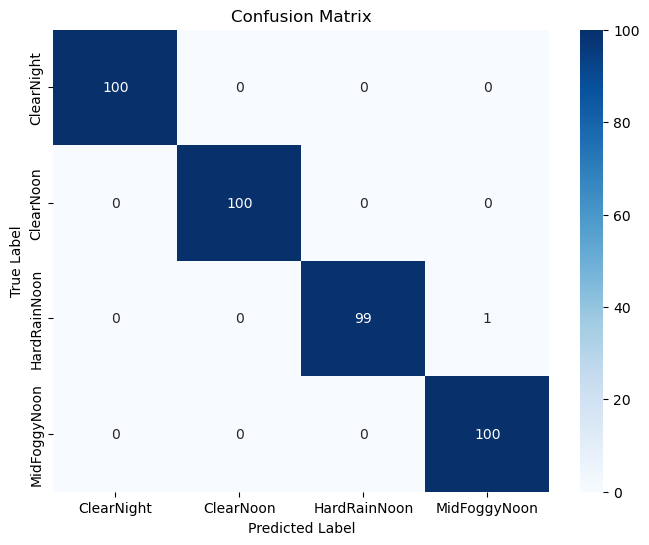

Classification Report :
               precision    recall  f1-score   support

  ClearNight       1.00      1.00      1.00       100
   ClearNoon       1.00      1.00      1.00       100
HardRainNoon       1.00      0.99      0.99       100
MidFoggyNoon       0.99      1.00      1.00       100

    accuracy                           1.00       400
   macro avg       1.00      1.00      1.00       400
weighted avg       1.00      1.00      1.00       400



In [38]:
#Compute the confusion matrix for rbf kernel
conf_matrix = confusion_matrix(encoded_labels_test, predictions_test_rbf)

# Display the confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder_train.classes_, yticklabels=label_encoder_train.classes_)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

# Display the classification report with zero_division parameter
class_report = classification_report(encoded_labels_test, predictions_test_rbf, target_names=label_encoder_train.classes_, zero_division=1)
print("Classification Report :\n", class_report)


In [39]:
#Calculate precision, recall, and F1-score per class
precision, recall, f1_score, _ = precision_recall_fscore_support(encoded_labels_test, predictions_test_rbf, zero_division=1)
#Display the results
for i, class_name in enumerate(label_encoder_train.classes_):
    print(f"Class: {class_name}")
    print(f"Precision: {precision[i]:.2f}")
    print(f"Recall: {recall[i]:.2f}")
    print(f"F1-score: {f1_score[i]:.2f}")
    print("***************************")

Class: ClearNight
Precision: 1.00
Recall: 1.00
F1-score: 1.00
***************************
Class: ClearNoon
Precision: 1.00
Recall: 1.00
F1-score: 1.00
***************************
Class: HardRainNoon
Precision: 1.00
Recall: 0.99
F1-score: 0.99
***************************
Class: MidFoggyNoon
Precision: 0.99
Recall: 1.00
F1-score: 1.00
***************************


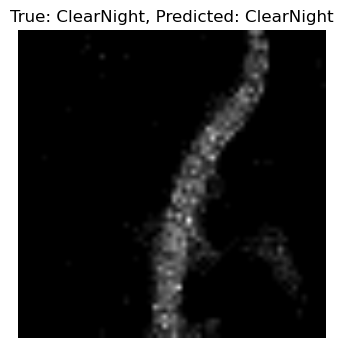

Sample Index: 0
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



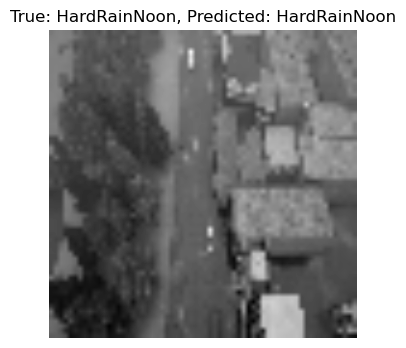

Sample Index: 1
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



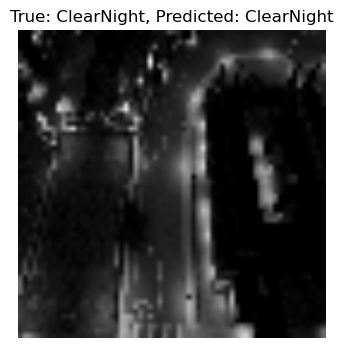

Sample Index: 2
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



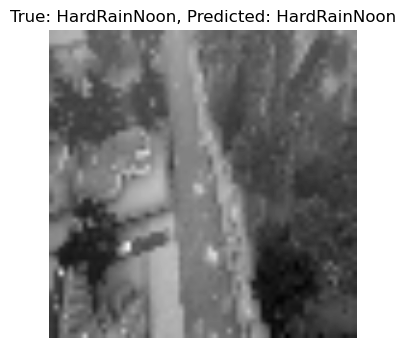

Sample Index: 3
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



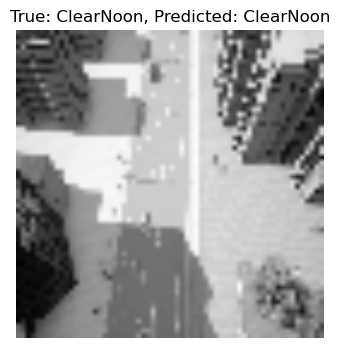

Sample Index: 4
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



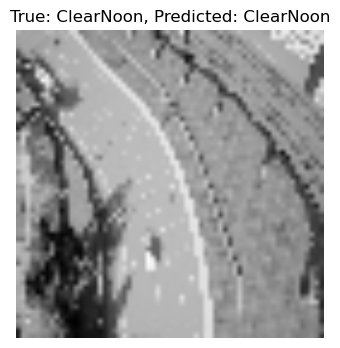

Sample Index: 5
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



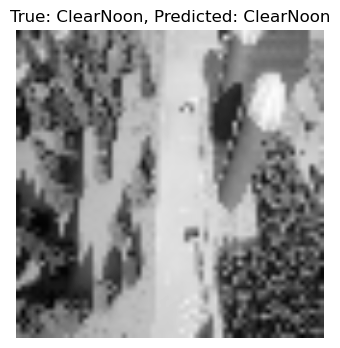

Sample Index: 6
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



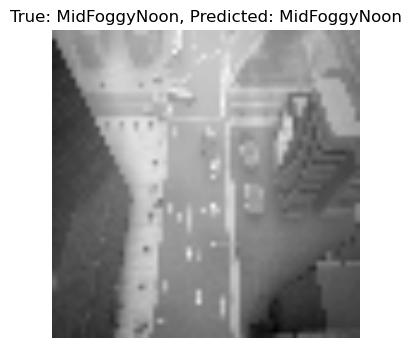

Sample Index: 7
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



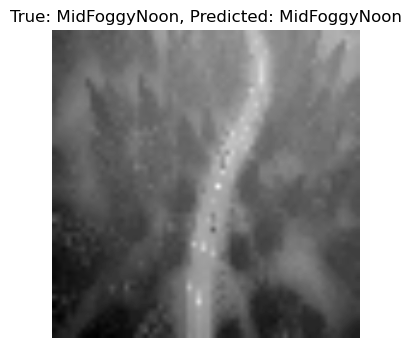

Sample Index: 8
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



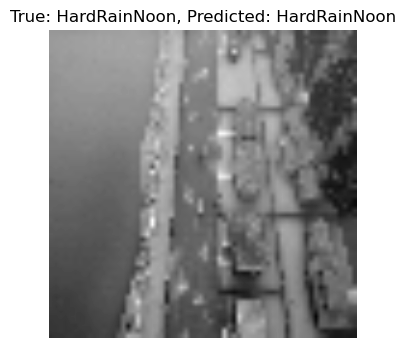

Sample Index: 9
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



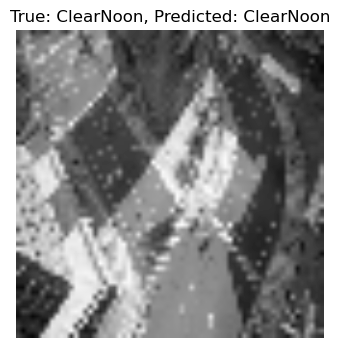

Sample Index: 10
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



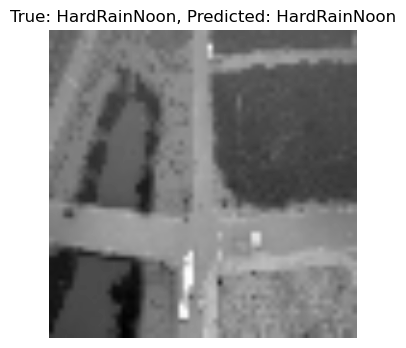

Sample Index: 11
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



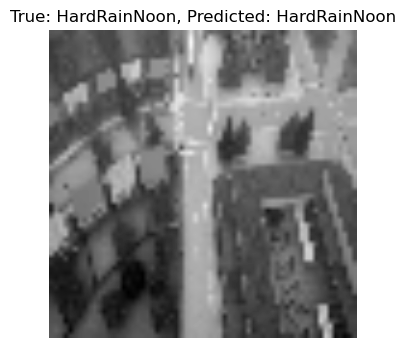

Sample Index: 12
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



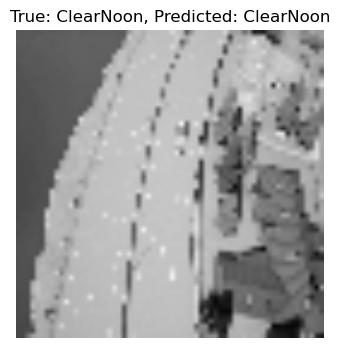

Sample Index: 13
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



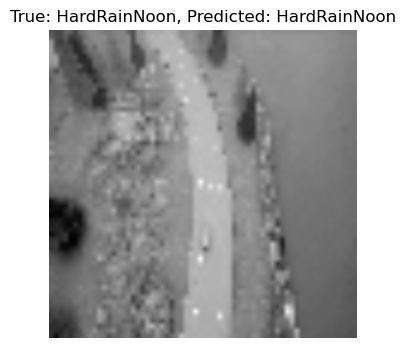

Sample Index: 14
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



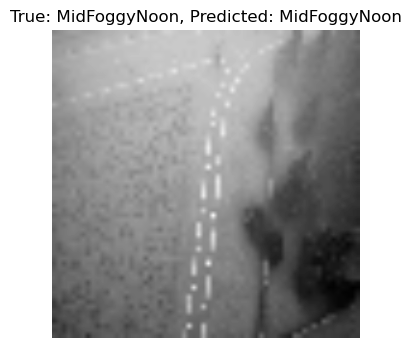

Sample Index: 15
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



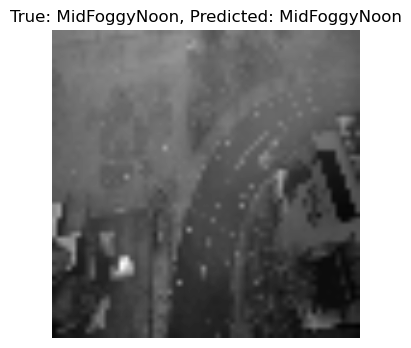

Sample Index: 16
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



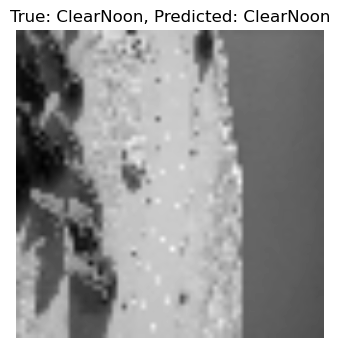

Sample Index: 17
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



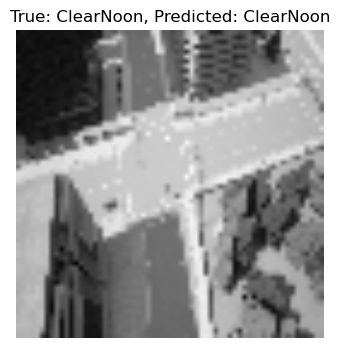

Sample Index: 18
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



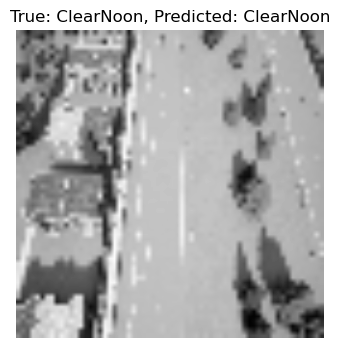

Sample Index: 19
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



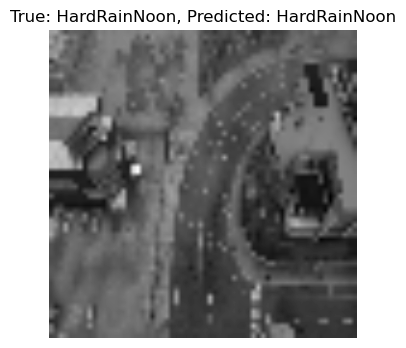

Sample Index: 20
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



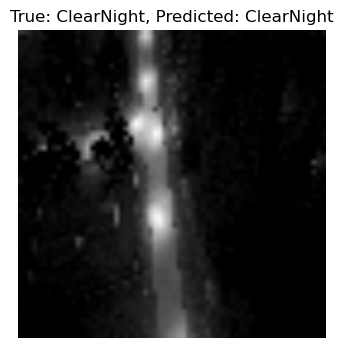

Sample Index: 21
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



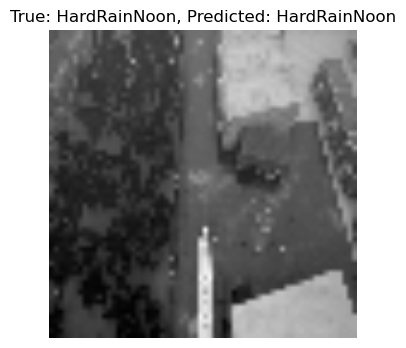

Sample Index: 22
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



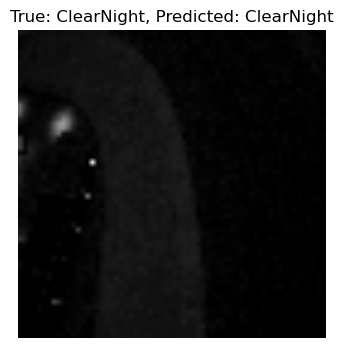

Sample Index: 23
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



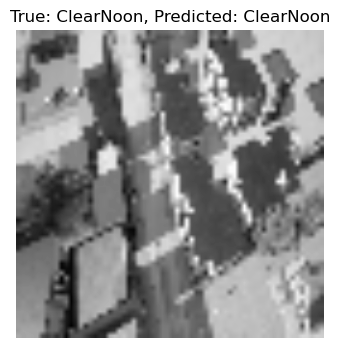

Sample Index: 24
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



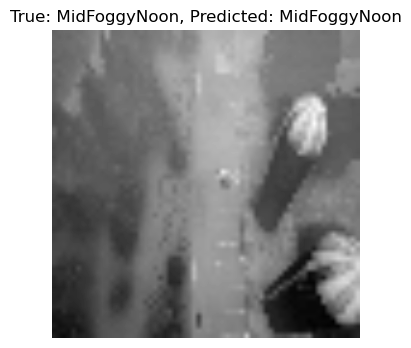

Sample Index: 25
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



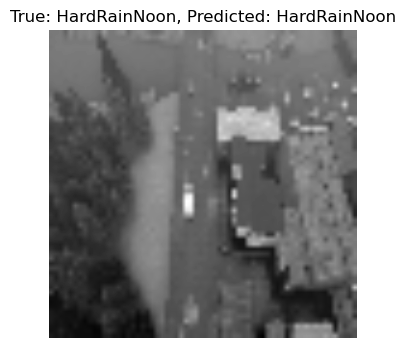

Sample Index: 26
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



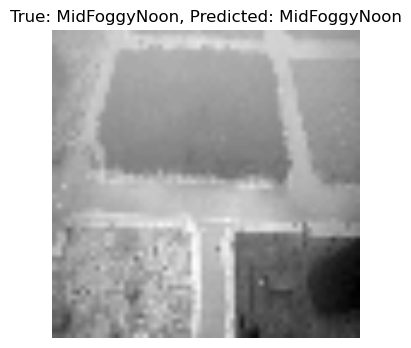

Sample Index: 27
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



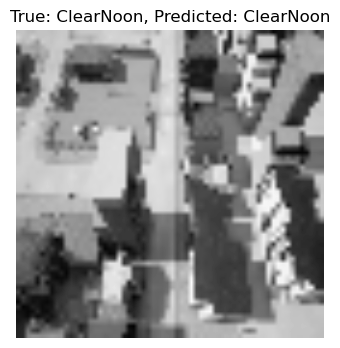

Sample Index: 28
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



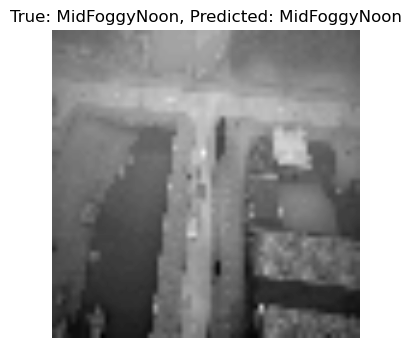

Sample Index: 29
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



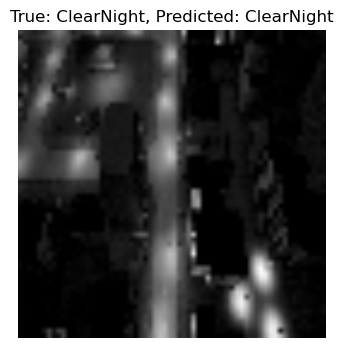

Sample Index: 30
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



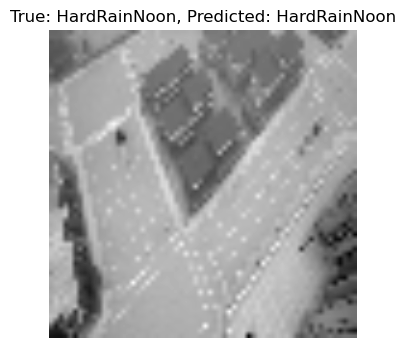

Sample Index: 31
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



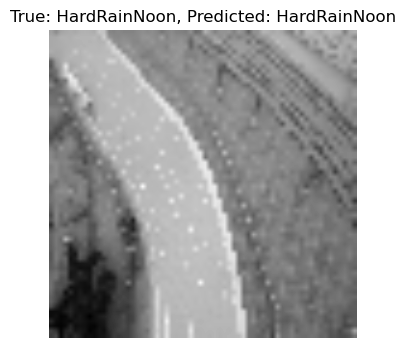

Sample Index: 32
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



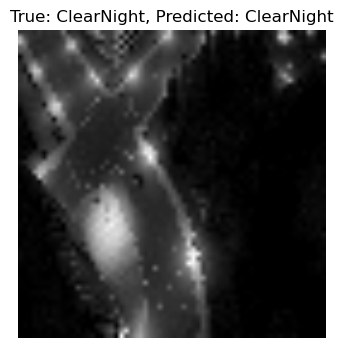

Sample Index: 33
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



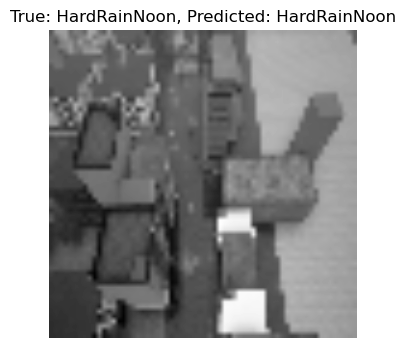

Sample Index: 34
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



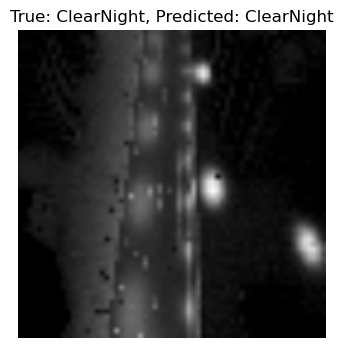

Sample Index: 35
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



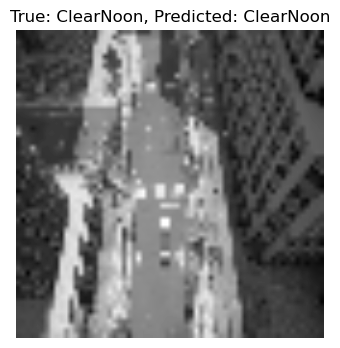

Sample Index: 36
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



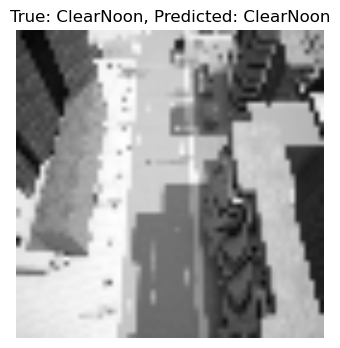

Sample Index: 37
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



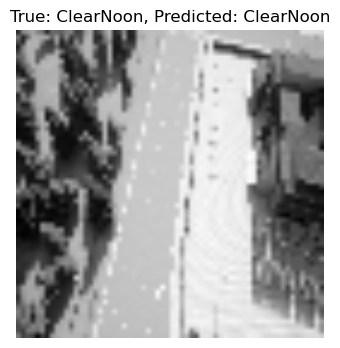

Sample Index: 38
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



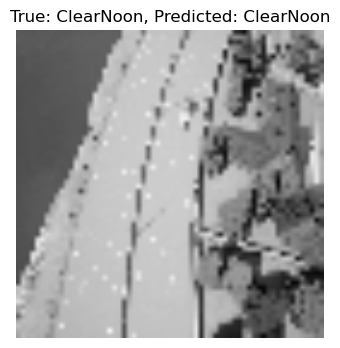

Sample Index: 39
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



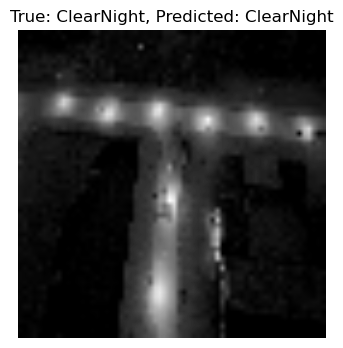

Sample Index: 40
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



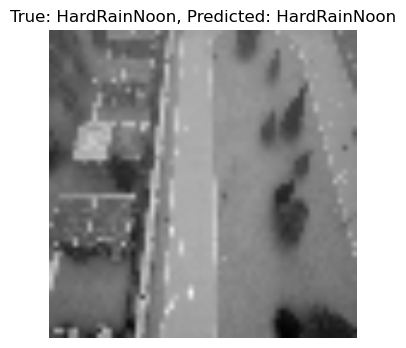

Sample Index: 41
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



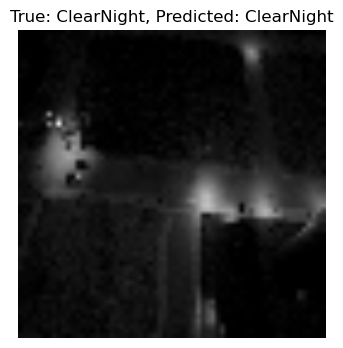

Sample Index: 42
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



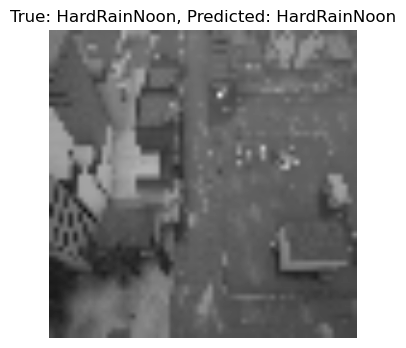

Sample Index: 43
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



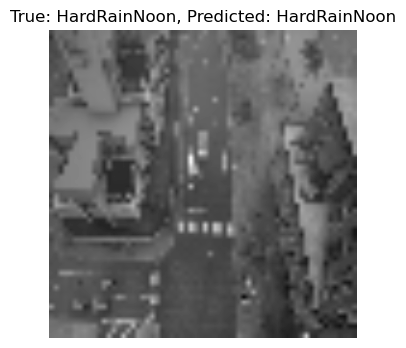

Sample Index: 44
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



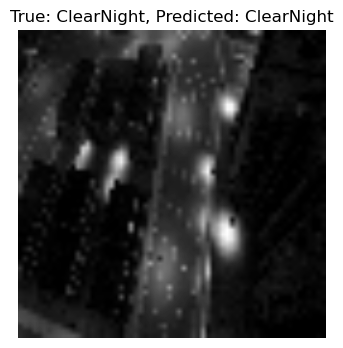

Sample Index: 45
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



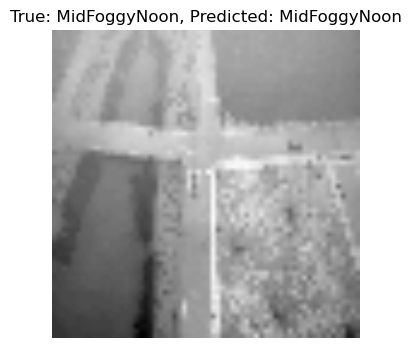

Sample Index: 46
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



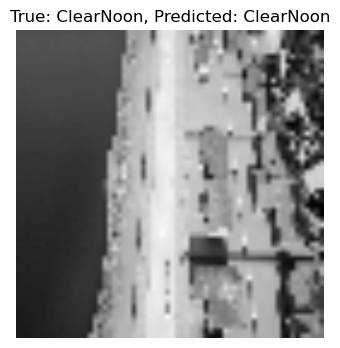

Sample Index: 47
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



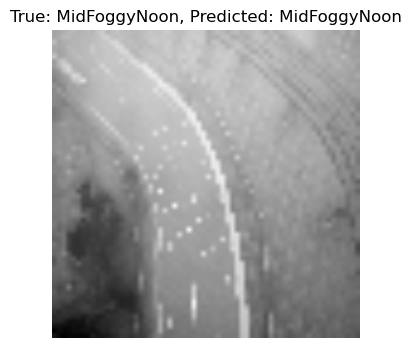

Sample Index: 48
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



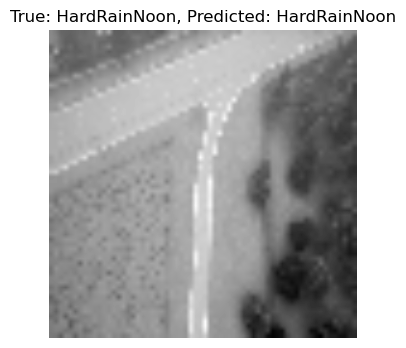

Sample Index: 49
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



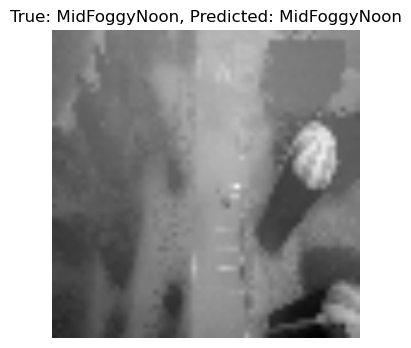

Sample Index: 50
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



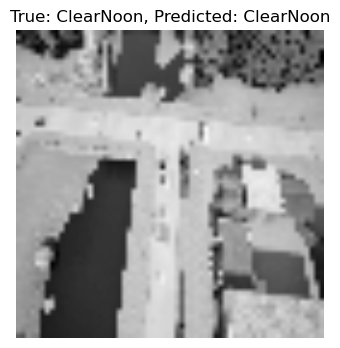

Sample Index: 51
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



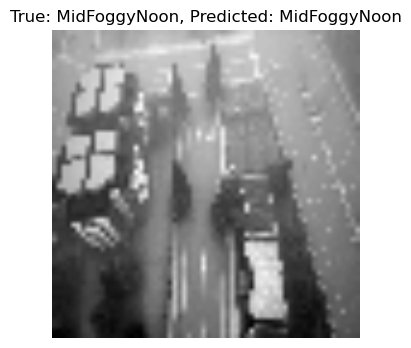

Sample Index: 52
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



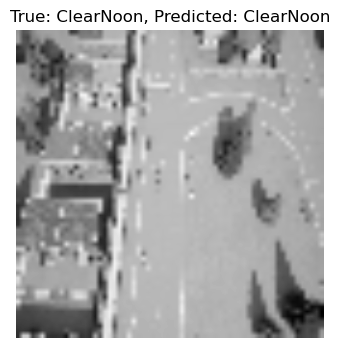

Sample Index: 53
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



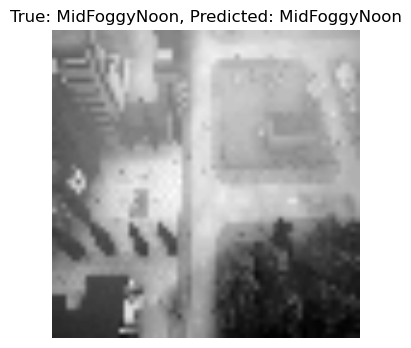

Sample Index: 54
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



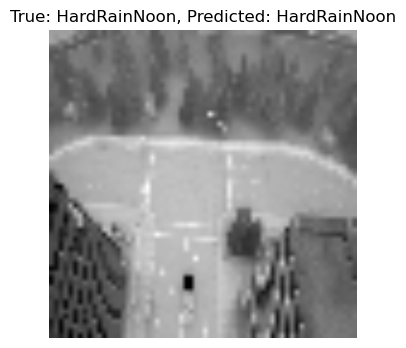

Sample Index: 55
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



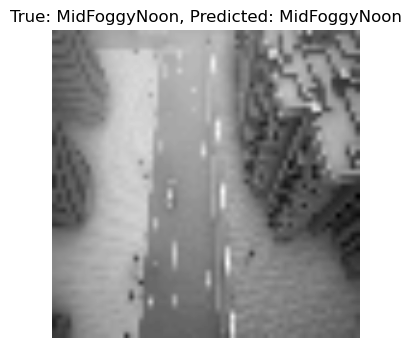

Sample Index: 56
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



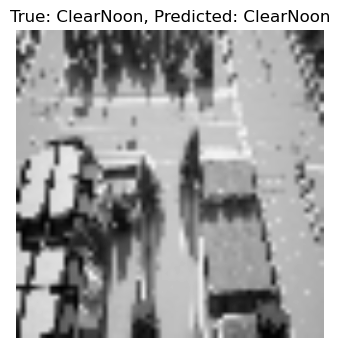

Sample Index: 57
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



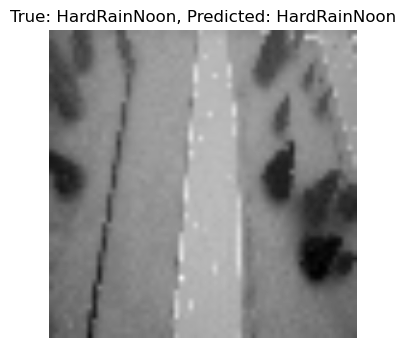

Sample Index: 58
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



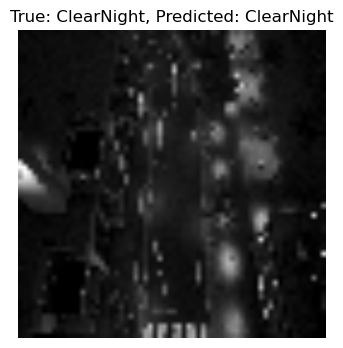

Sample Index: 59
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



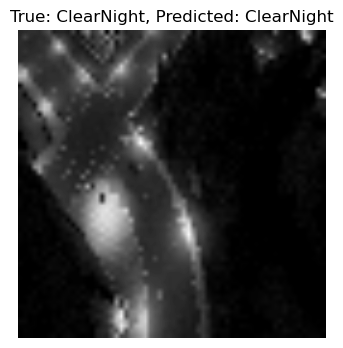

Sample Index: 60
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



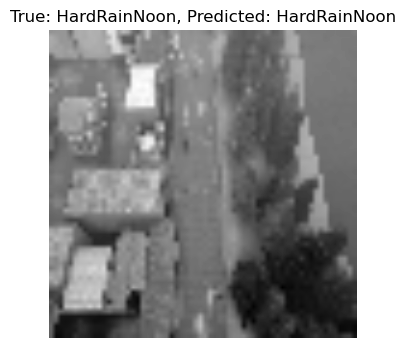

Sample Index: 61
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



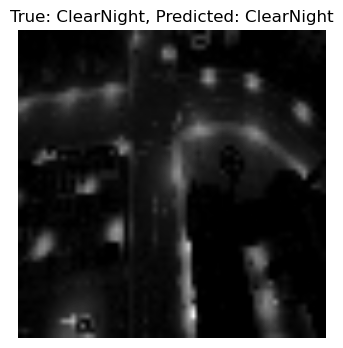

Sample Index: 62
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



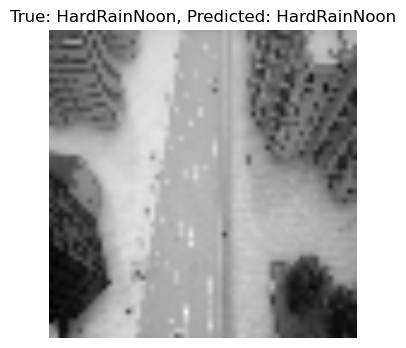

Sample Index: 63
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



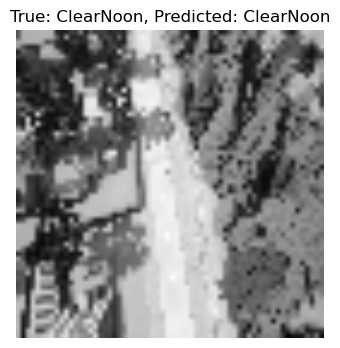

Sample Index: 64
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



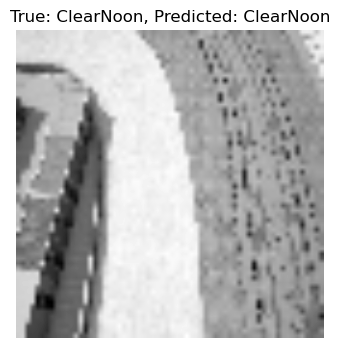

Sample Index: 65
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



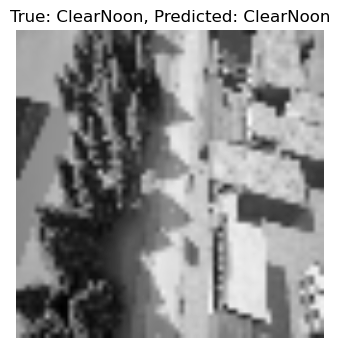

Sample Index: 66
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



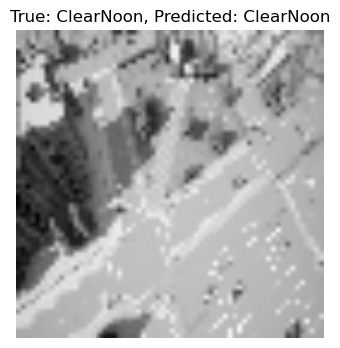

Sample Index: 67
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



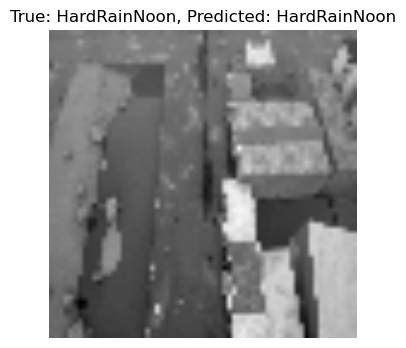

Sample Index: 68
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



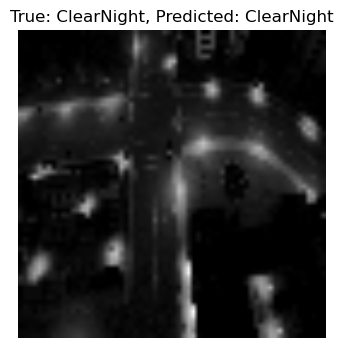

Sample Index: 69
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



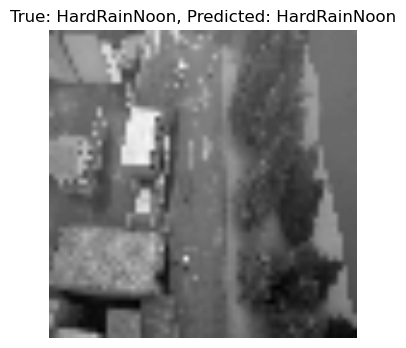

Sample Index: 70
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



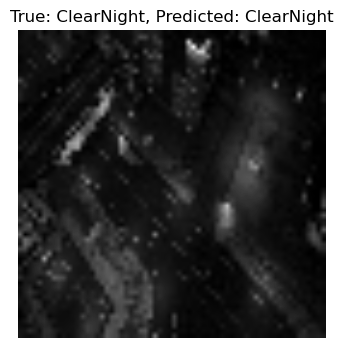

Sample Index: 71
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



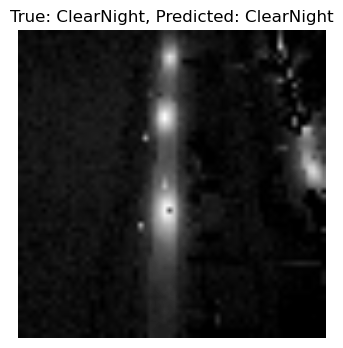

Sample Index: 72
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



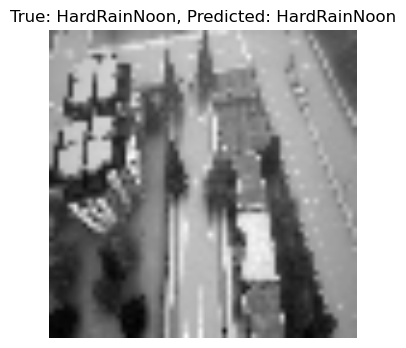

Sample Index: 73
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



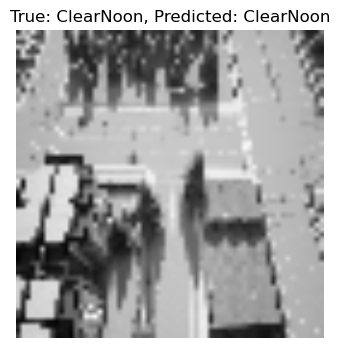

Sample Index: 74
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



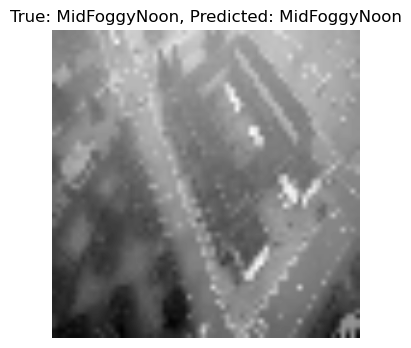

Sample Index: 75
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



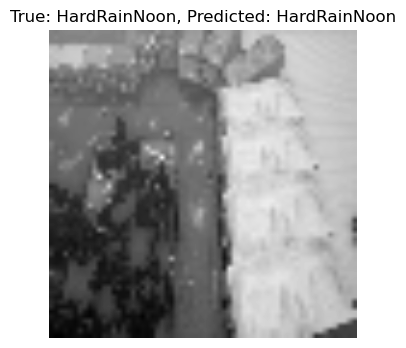

Sample Index: 76
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



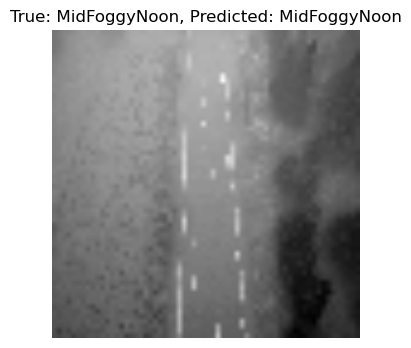

Sample Index: 77
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



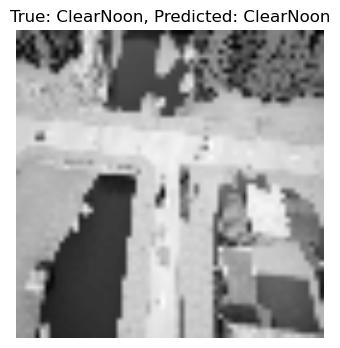

Sample Index: 78
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



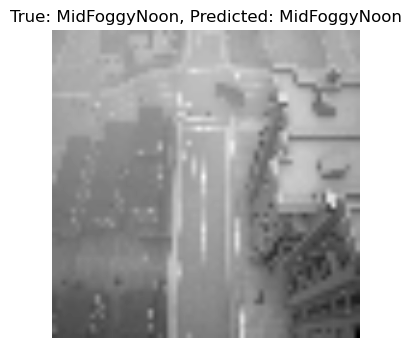

Sample Index: 79
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



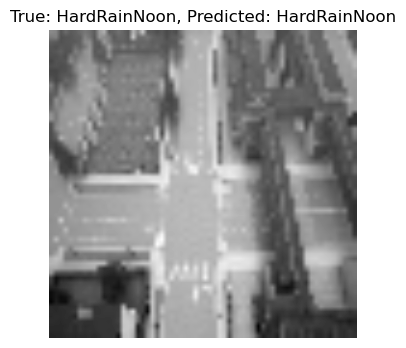

Sample Index: 80
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



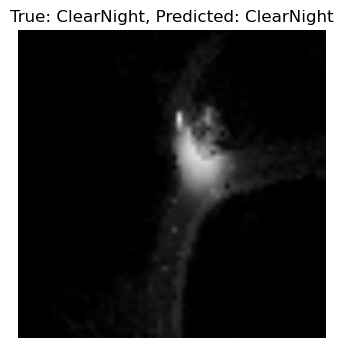

Sample Index: 81
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



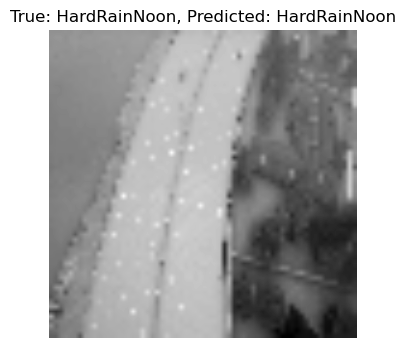

Sample Index: 82
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



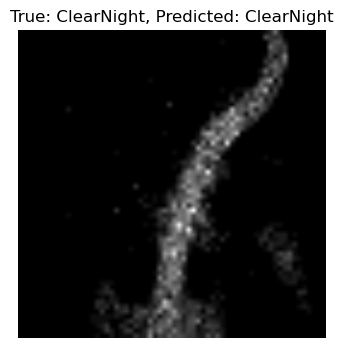

Sample Index: 83
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



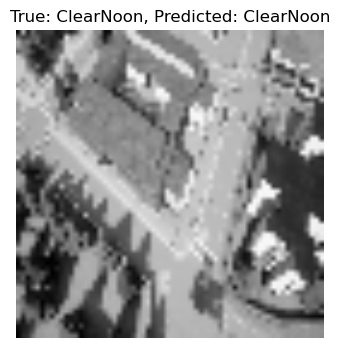

Sample Index: 84
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



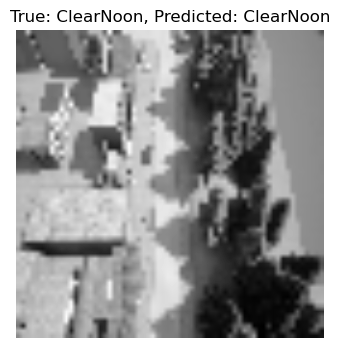

Sample Index: 85
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



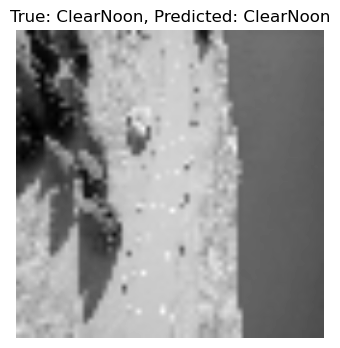

Sample Index: 86
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



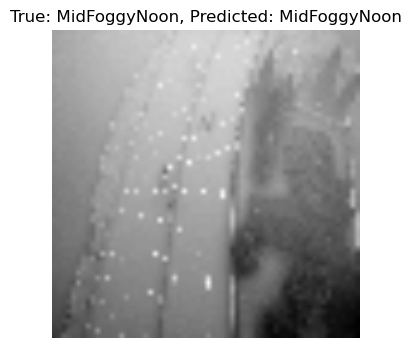

Sample Index: 87
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



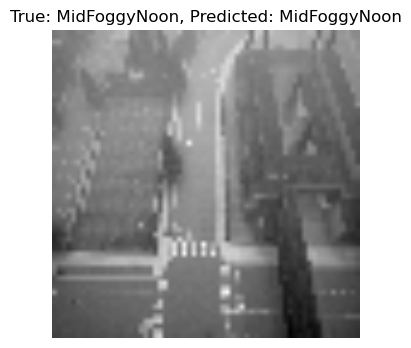

Sample Index: 88
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



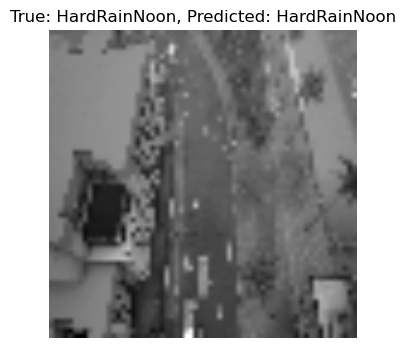

Sample Index: 89
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



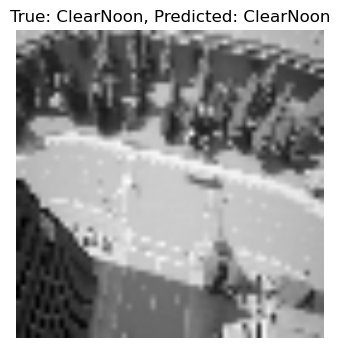

Sample Index: 90
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



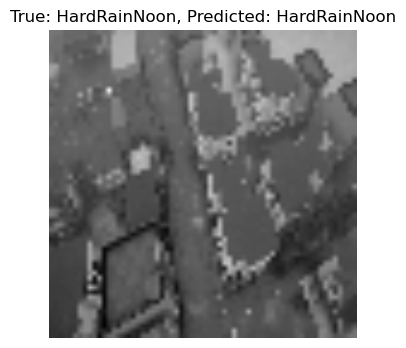

Sample Index: 91
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



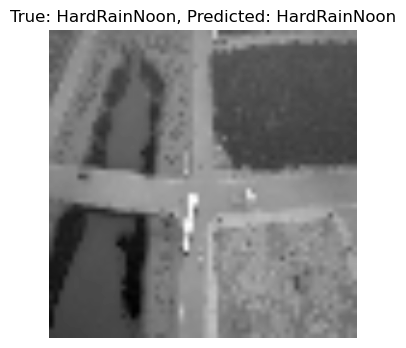

Sample Index: 92
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



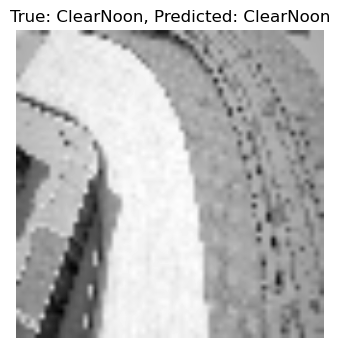

Sample Index: 93
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



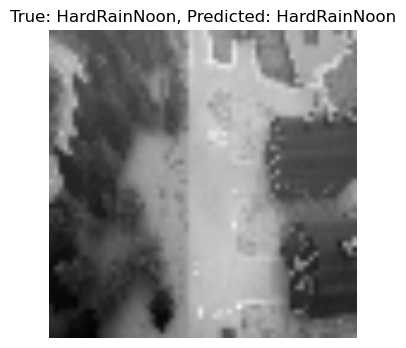

Sample Index: 94
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



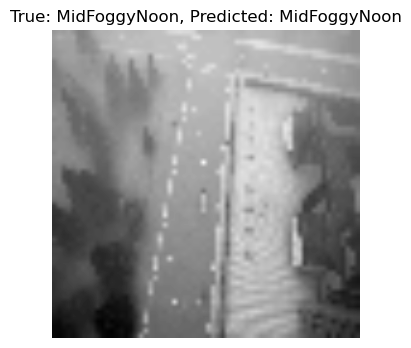

Sample Index: 95
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



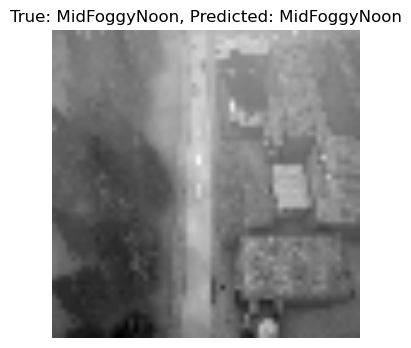

Sample Index: 96
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



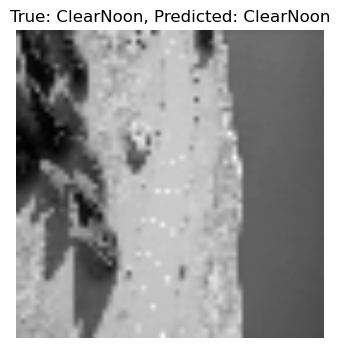

Sample Index: 97
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



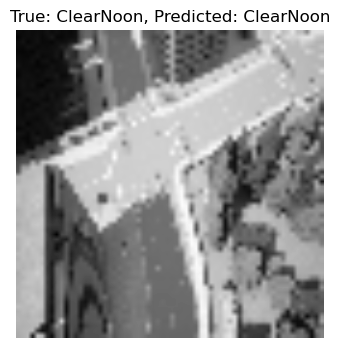

Sample Index: 98
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



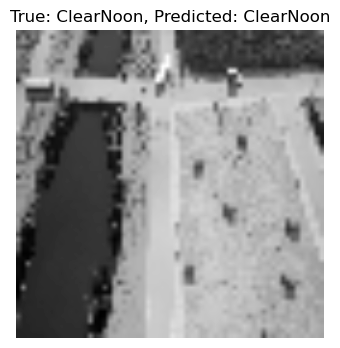

Sample Index: 99
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



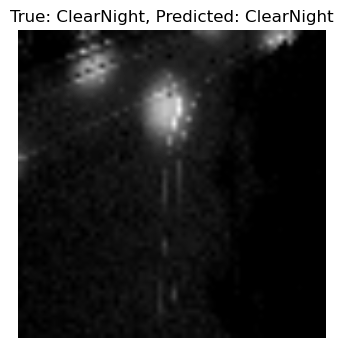

Sample Index: 100
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



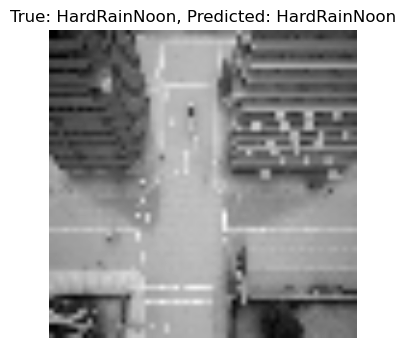

Sample Index: 101
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



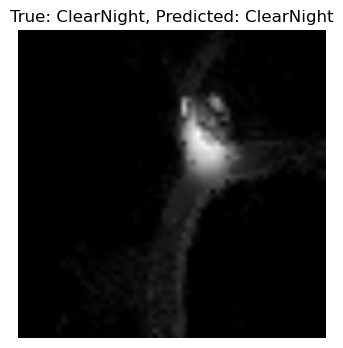

Sample Index: 102
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



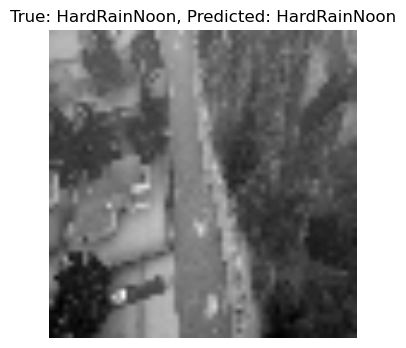

Sample Index: 103
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



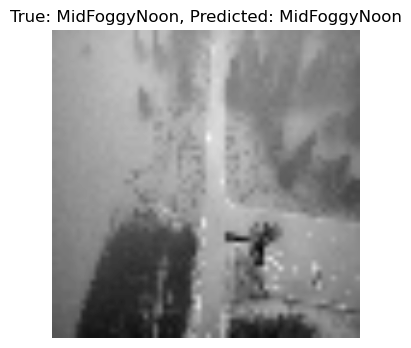

Sample Index: 104
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



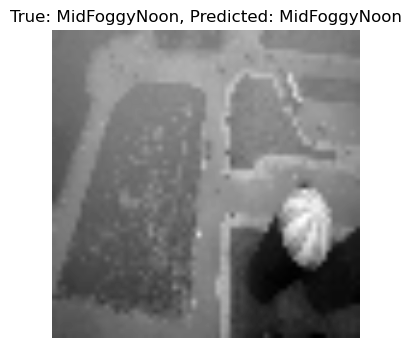

Sample Index: 105
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



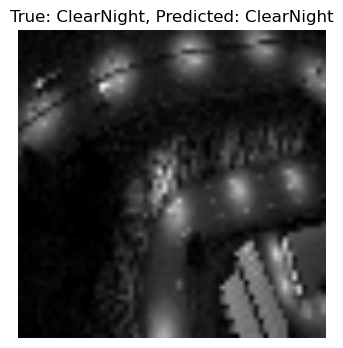

Sample Index: 106
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



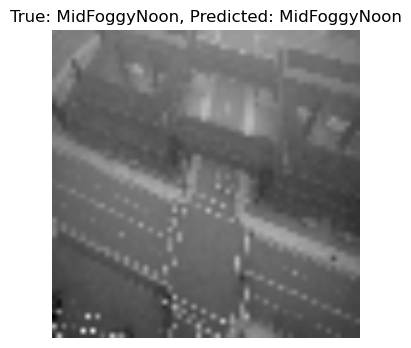

Sample Index: 107
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



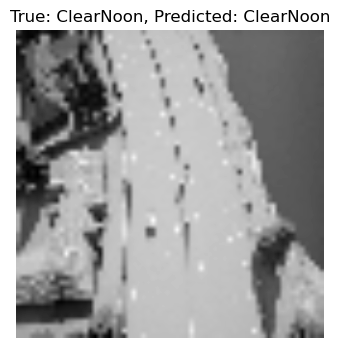

Sample Index: 108
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



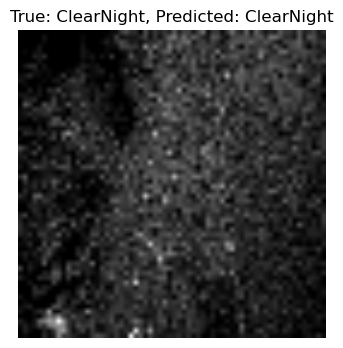

Sample Index: 109
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



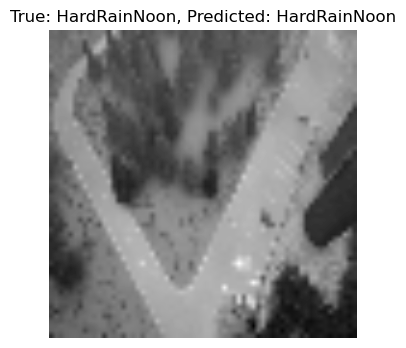

Sample Index: 110
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



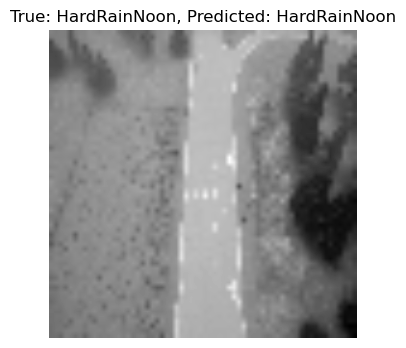

Sample Index: 111
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



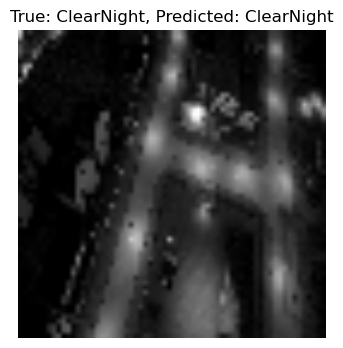

Sample Index: 112
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



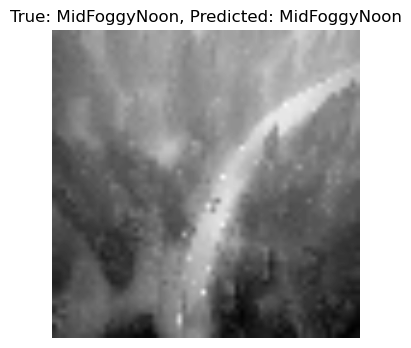

Sample Index: 113
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



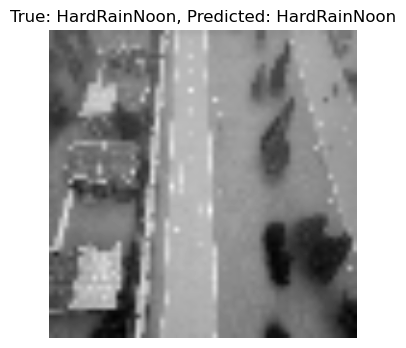

Sample Index: 114
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



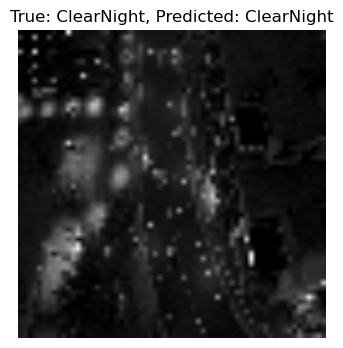

Sample Index: 115
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



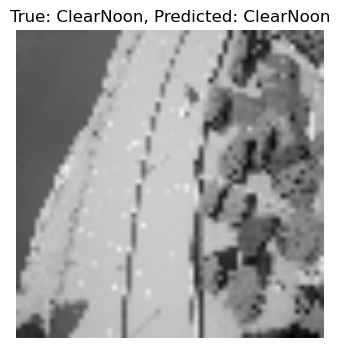

Sample Index: 116
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



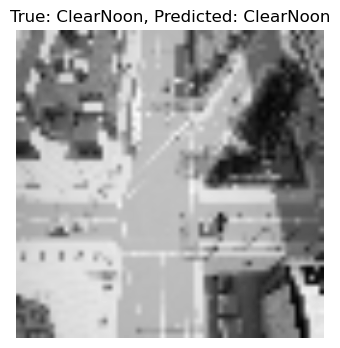

Sample Index: 117
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



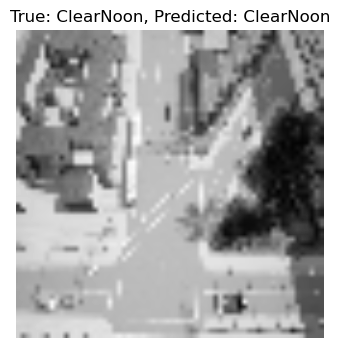

Sample Index: 118
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



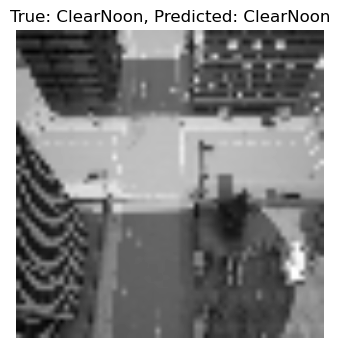

Sample Index: 119
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



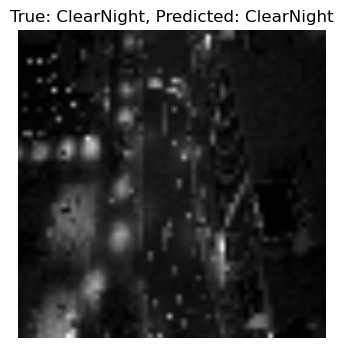

Sample Index: 120
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



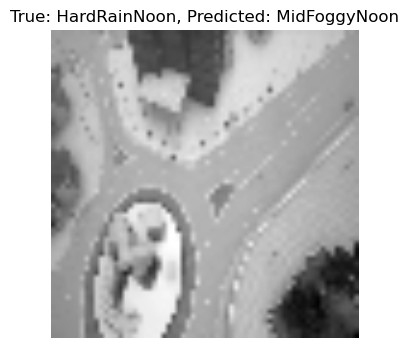

Sample Index: 121
True Label: HardRainNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



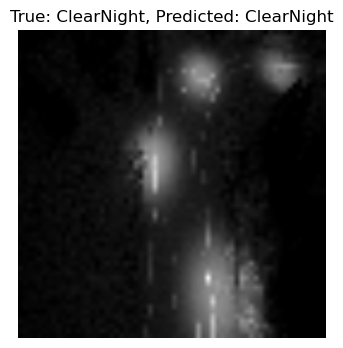

Sample Index: 122
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



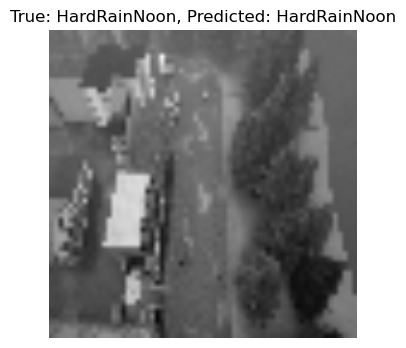

Sample Index: 123
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



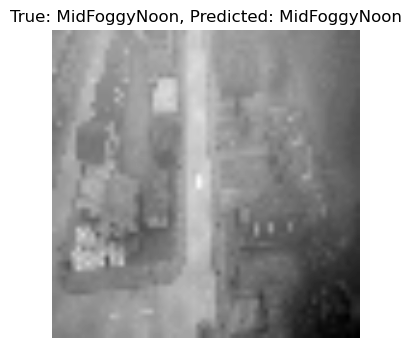

Sample Index: 124
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



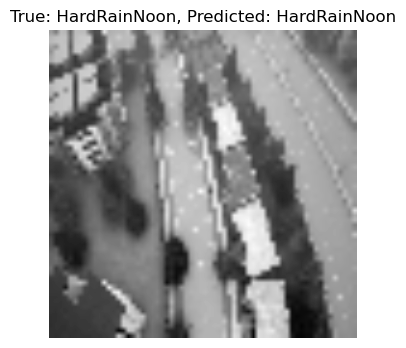

Sample Index: 125
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



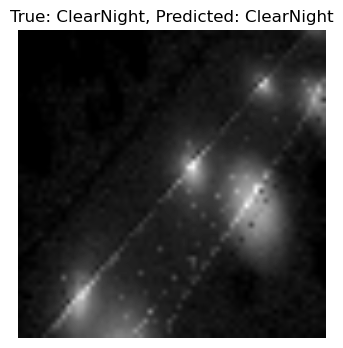

Sample Index: 126
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



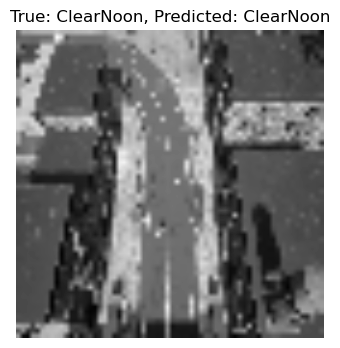

Sample Index: 127
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



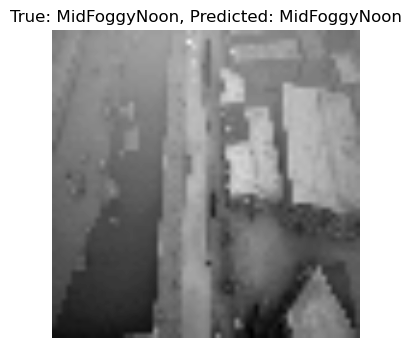

Sample Index: 128
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



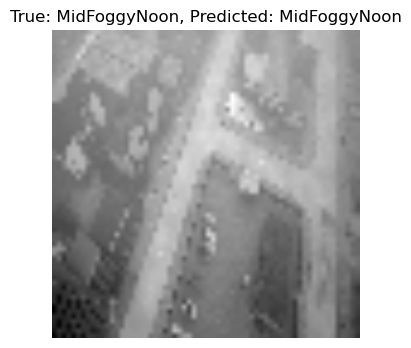

Sample Index: 129
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



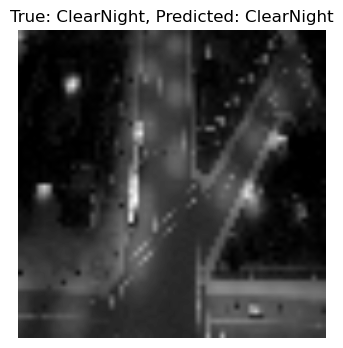

Sample Index: 130
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



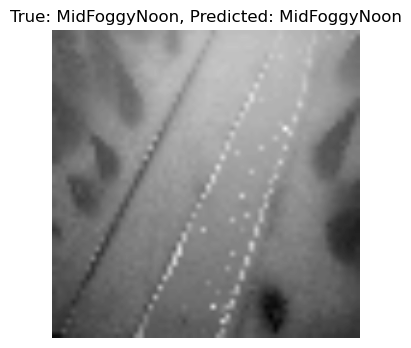

Sample Index: 131
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



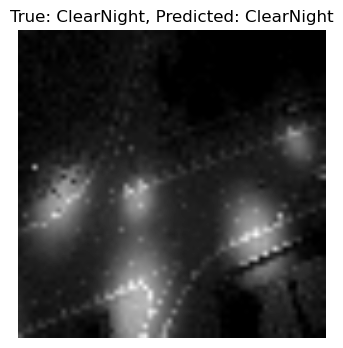

Sample Index: 132
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



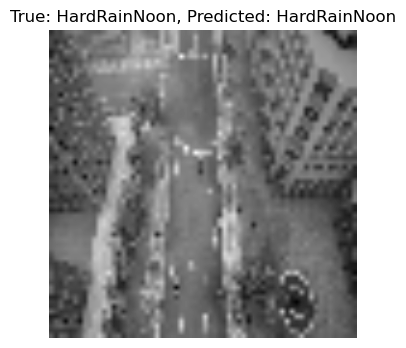

Sample Index: 133
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



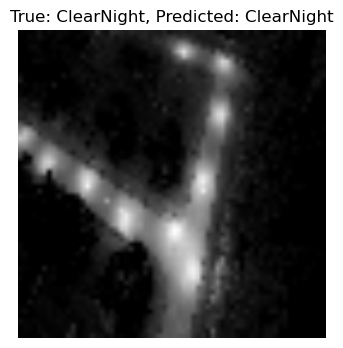

Sample Index: 134
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



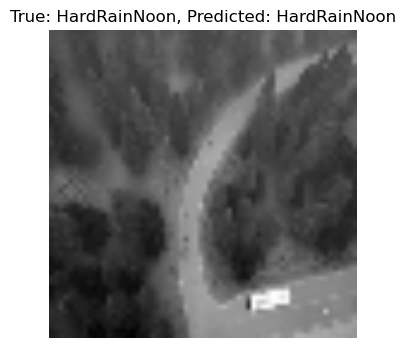

Sample Index: 135
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



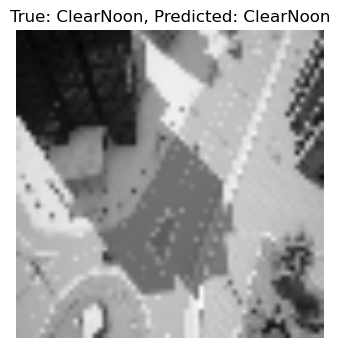

Sample Index: 136
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



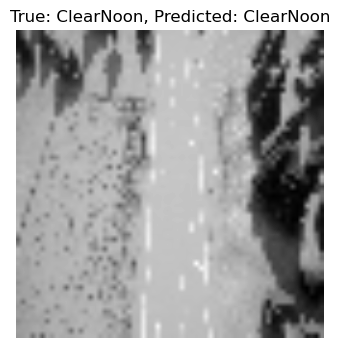

Sample Index: 137
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



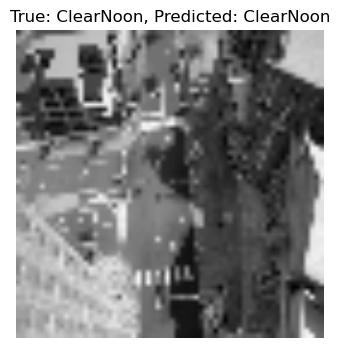

Sample Index: 138
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



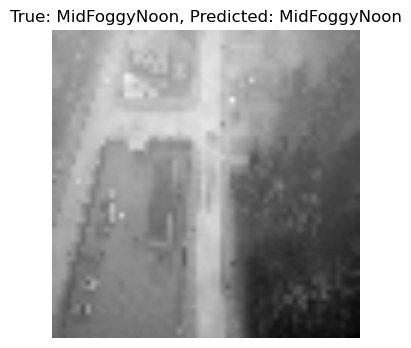

Sample Index: 139
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



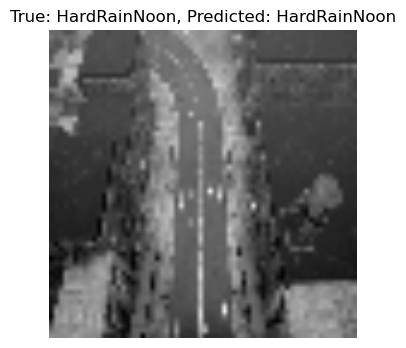

Sample Index: 140
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



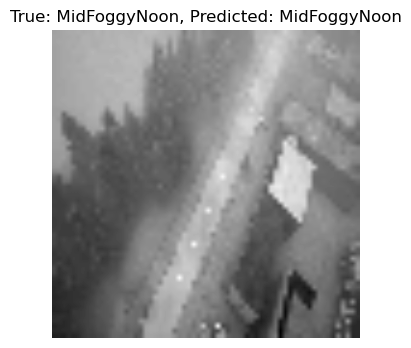

Sample Index: 141
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



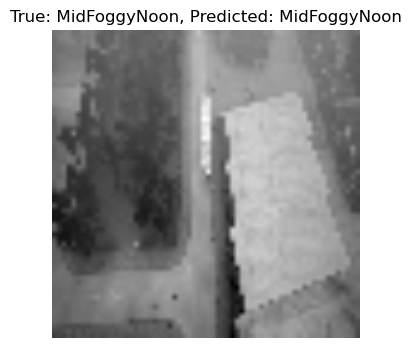

Sample Index: 142
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



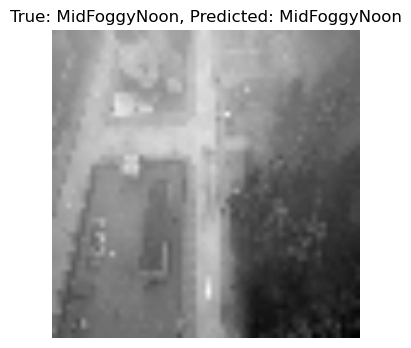

Sample Index: 143
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



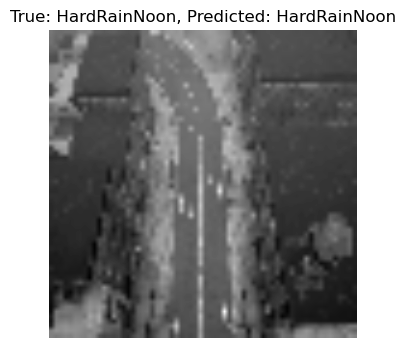

Sample Index: 144
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



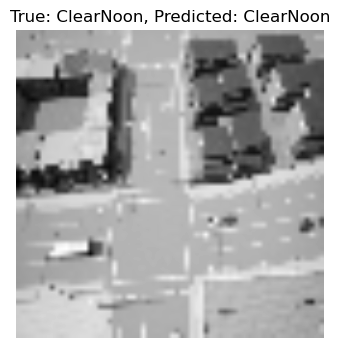

Sample Index: 145
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



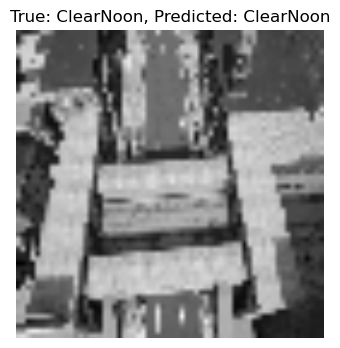

Sample Index: 146
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



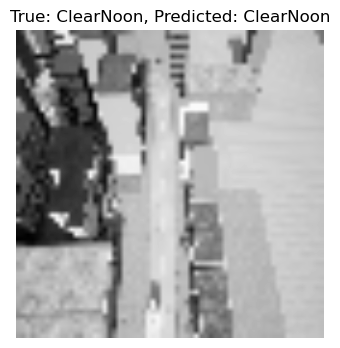

Sample Index: 147
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



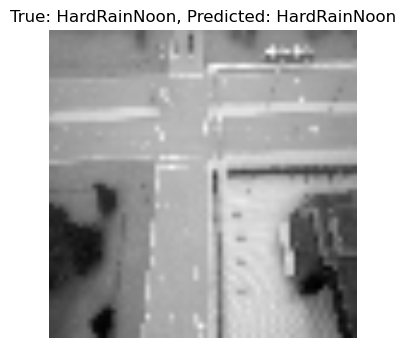

Sample Index: 148
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



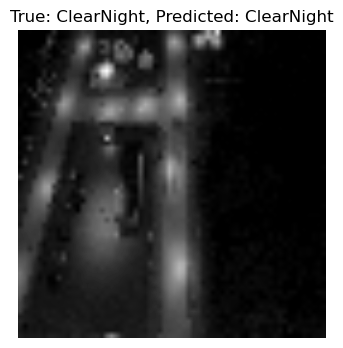

Sample Index: 149
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



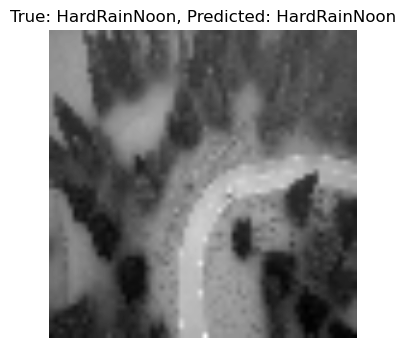

Sample Index: 150
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



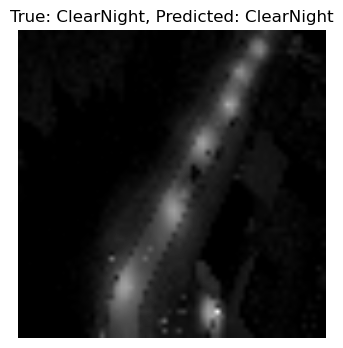

Sample Index: 151
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



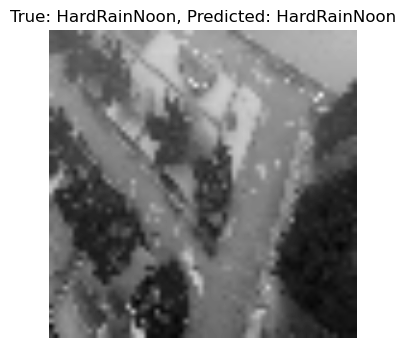

Sample Index: 152
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



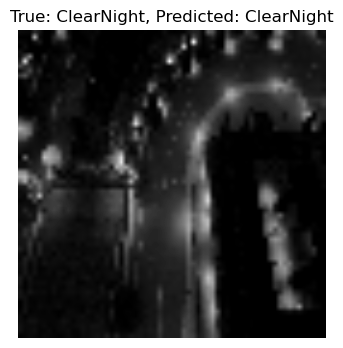

Sample Index: 153
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



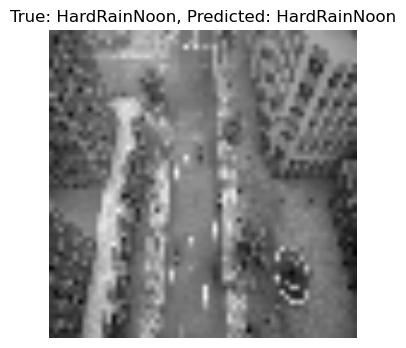

Sample Index: 154
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



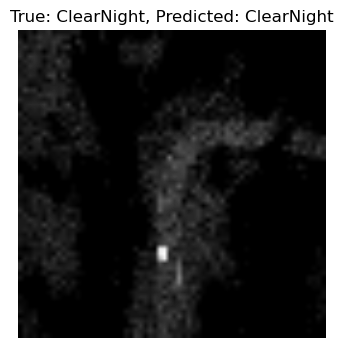

Sample Index: 155
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



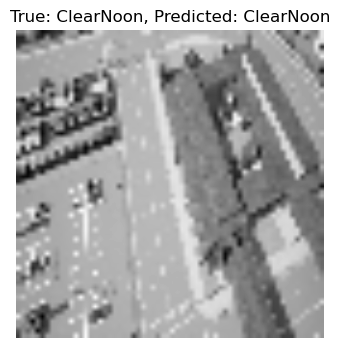

Sample Index: 156
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



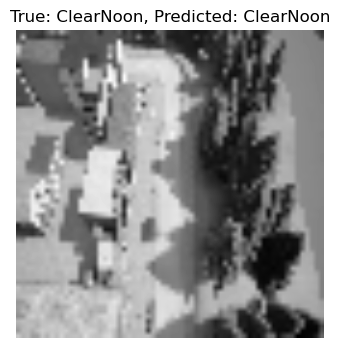

Sample Index: 157
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



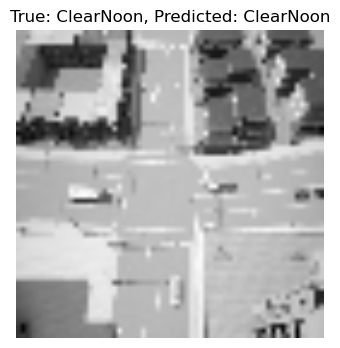

Sample Index: 158
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



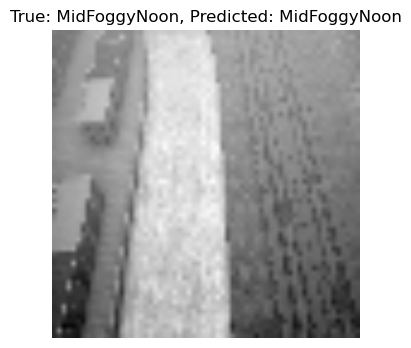

Sample Index: 159
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



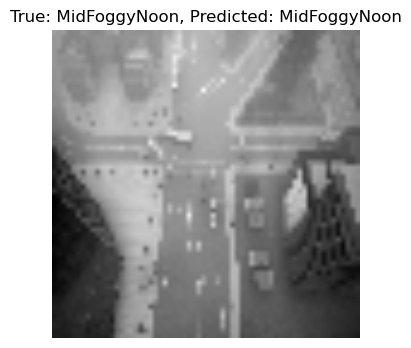

Sample Index: 160
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



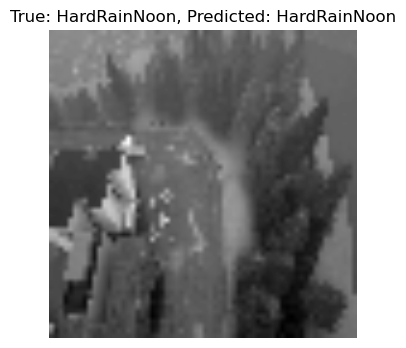

Sample Index: 161
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



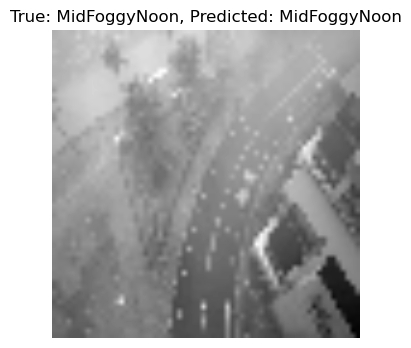

Sample Index: 162
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



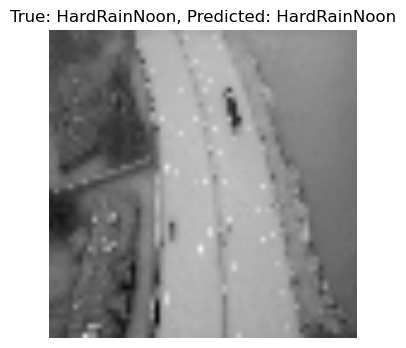

Sample Index: 163
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



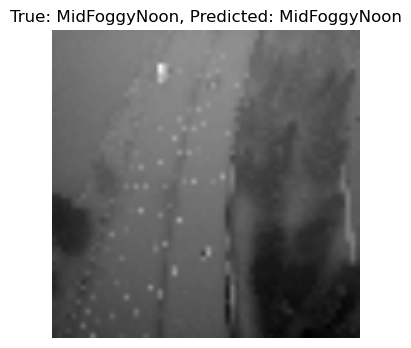

Sample Index: 164
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



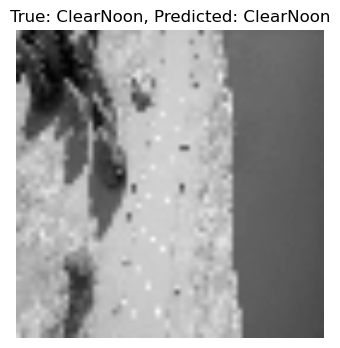

Sample Index: 165
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



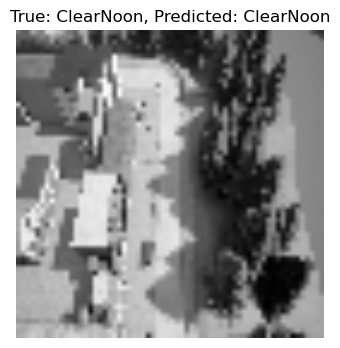

Sample Index: 166
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



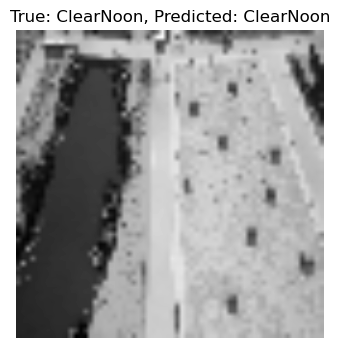

Sample Index: 167
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



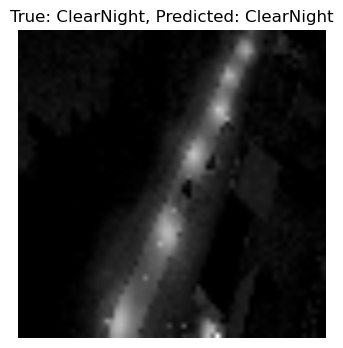

Sample Index: 168
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



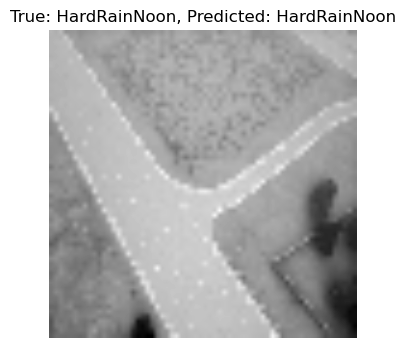

Sample Index: 169
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



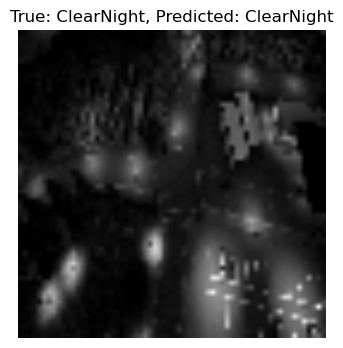

Sample Index: 170
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



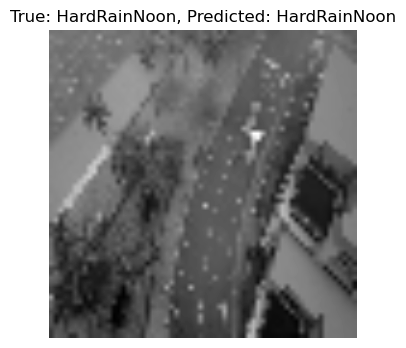

Sample Index: 171
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



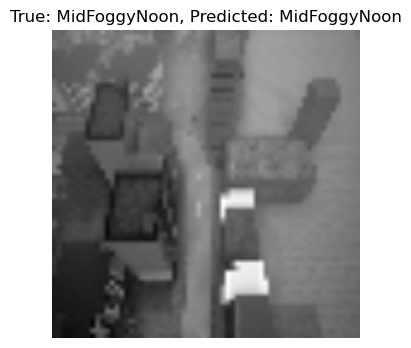

Sample Index: 172
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



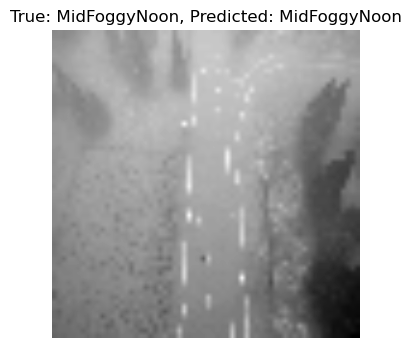

Sample Index: 173
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



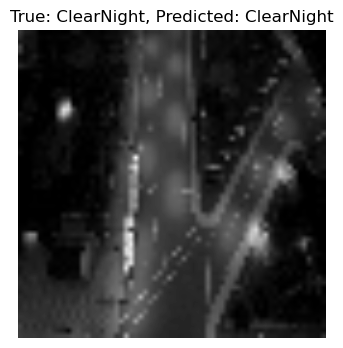

Sample Index: 174
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



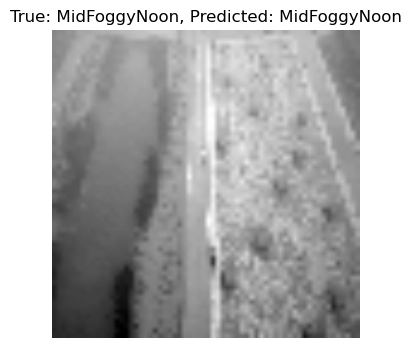

Sample Index: 175
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



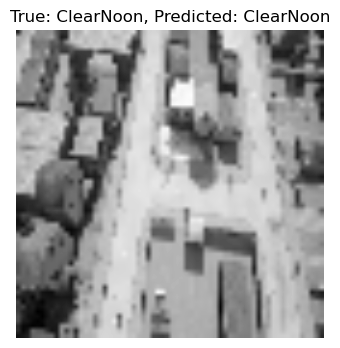

Sample Index: 176
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



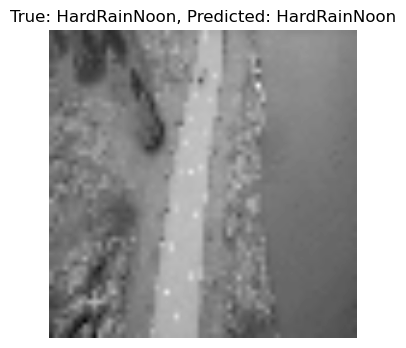

Sample Index: 177
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



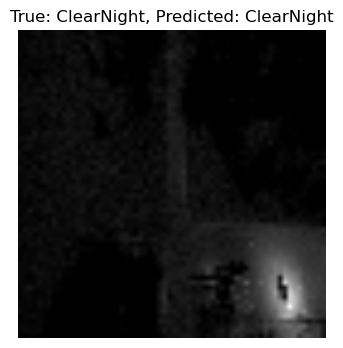

Sample Index: 178
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



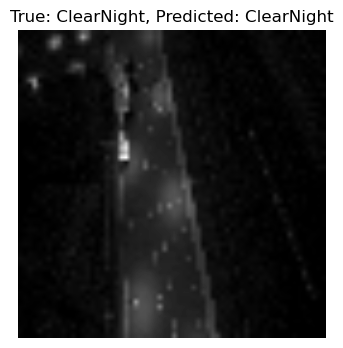

Sample Index: 179
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



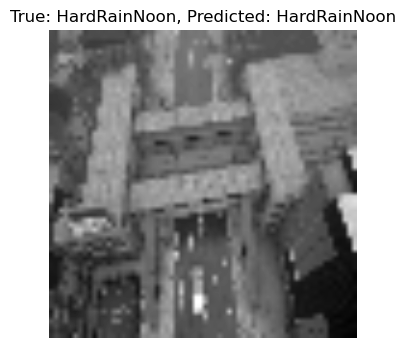

Sample Index: 180
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



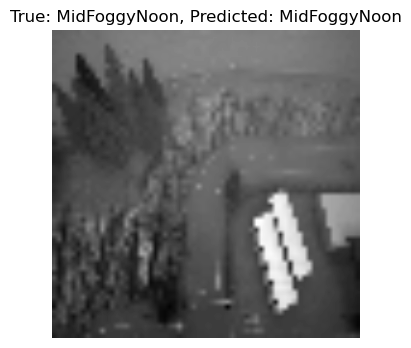

Sample Index: 181
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



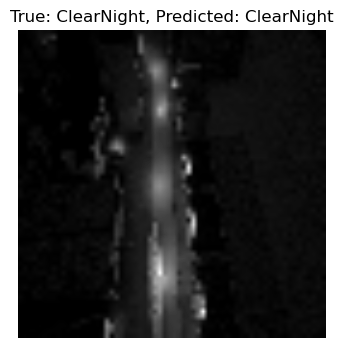

Sample Index: 182
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



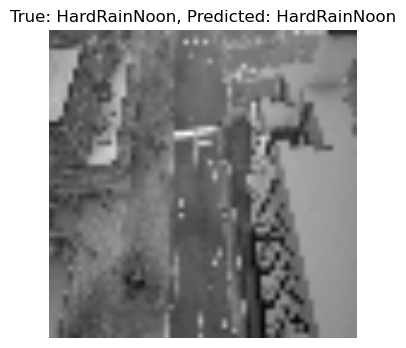

Sample Index: 183
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



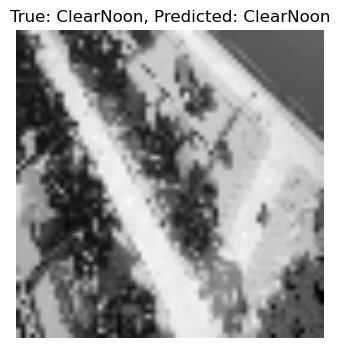

Sample Index: 184
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



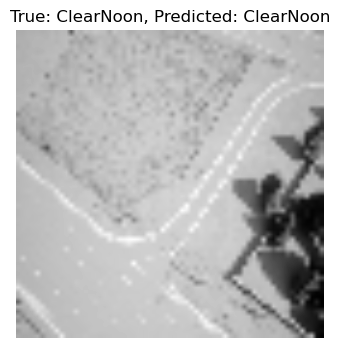

Sample Index: 185
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



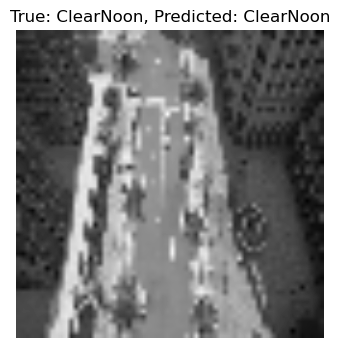

Sample Index: 186
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



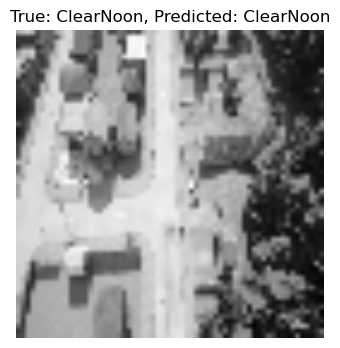

Sample Index: 187
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



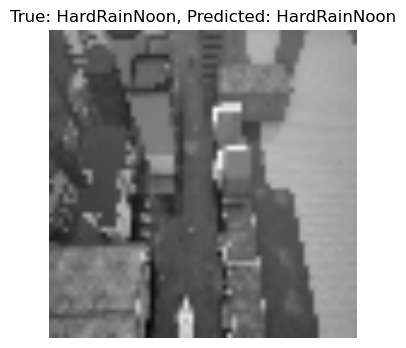

Sample Index: 188
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



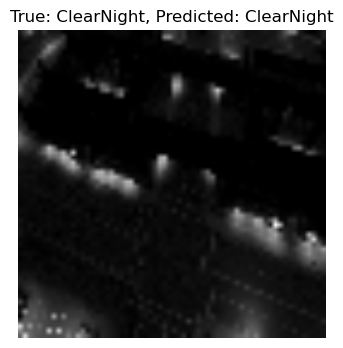

Sample Index: 189
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



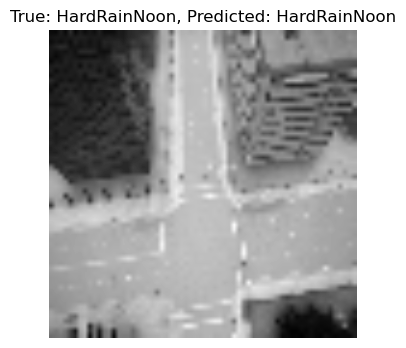

Sample Index: 190
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



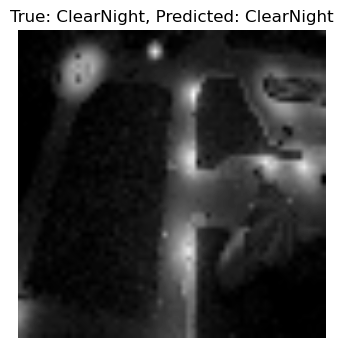

Sample Index: 191
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



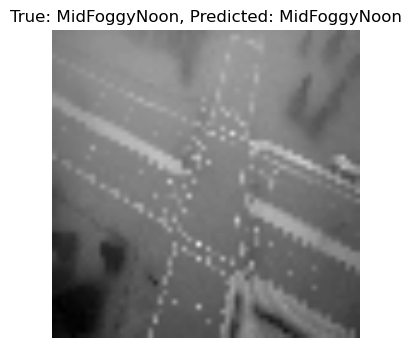

Sample Index: 192
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



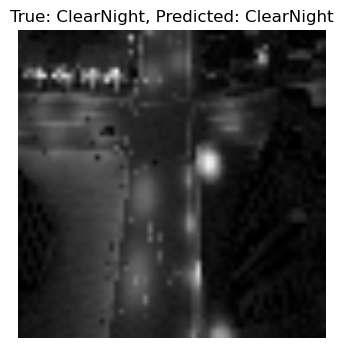

Sample Index: 193
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



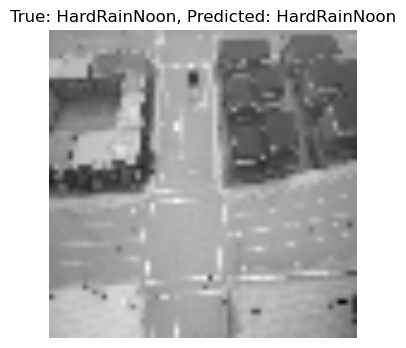

Sample Index: 194
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



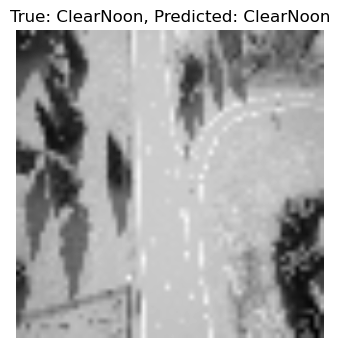

Sample Index: 195
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



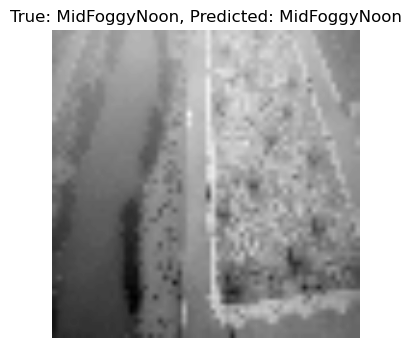

Sample Index: 196
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



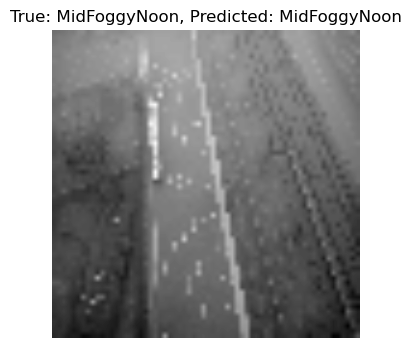

Sample Index: 197
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



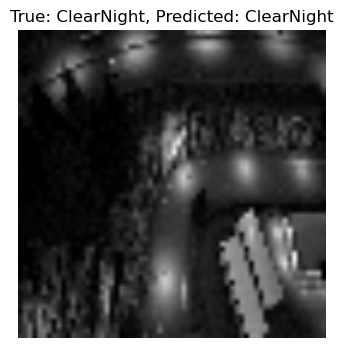

Sample Index: 198
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



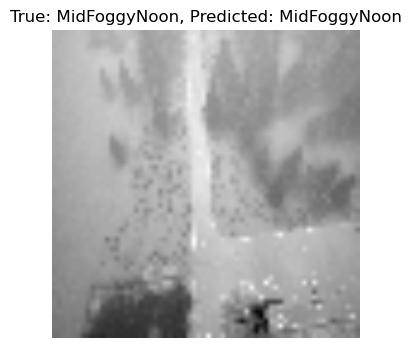

Sample Index: 199
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



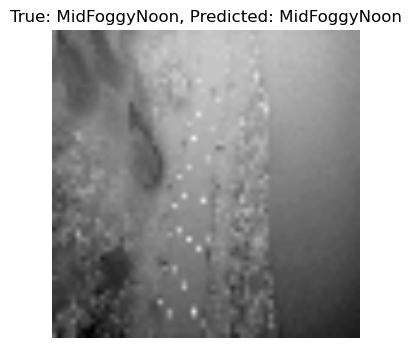

Sample Index: 200
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



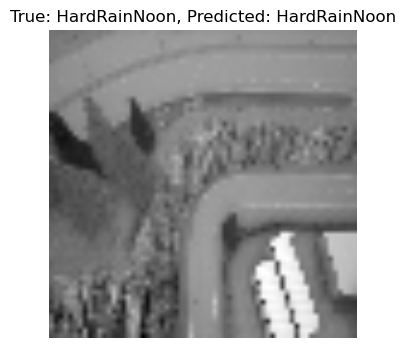

Sample Index: 201
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



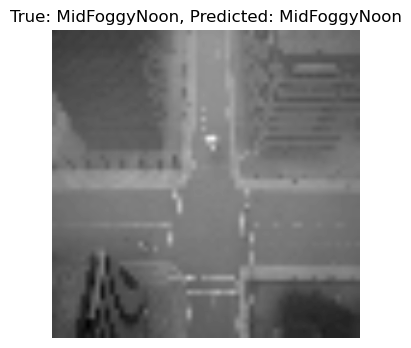

Sample Index: 202
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



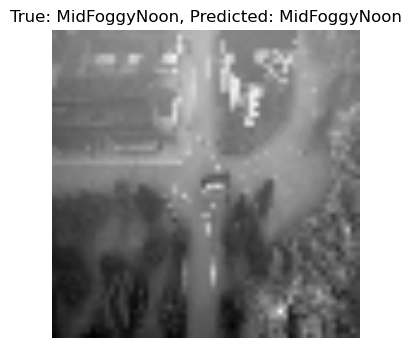

Sample Index: 203
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



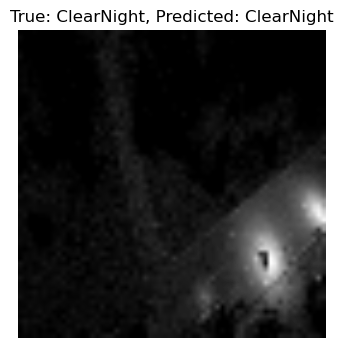

Sample Index: 204
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



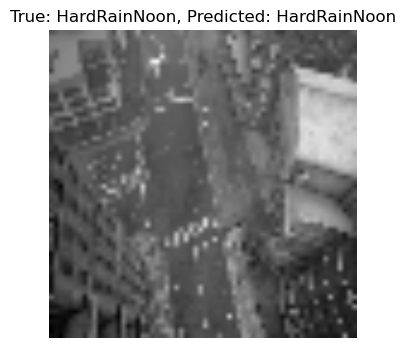

Sample Index: 205
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



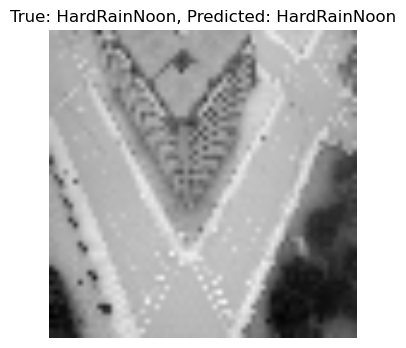

Sample Index: 206
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



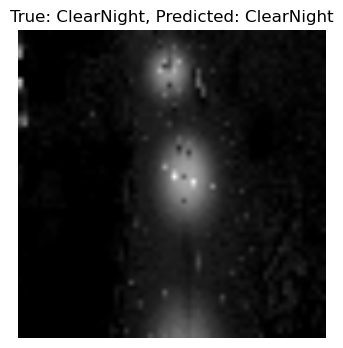

Sample Index: 207
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



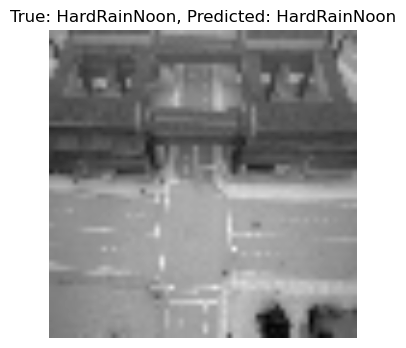

Sample Index: 208
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



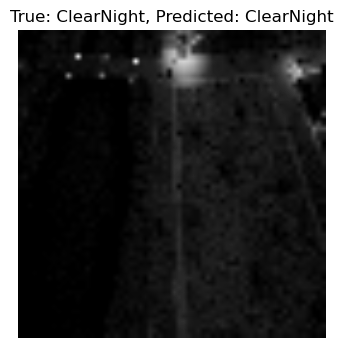

Sample Index: 209
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



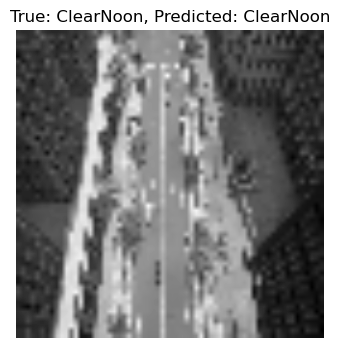

Sample Index: 210
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



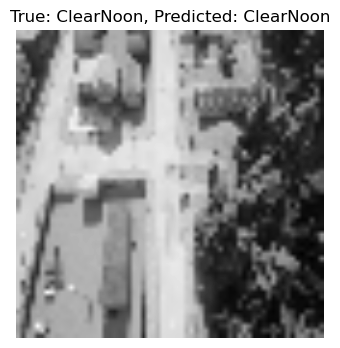

Sample Index: 211
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



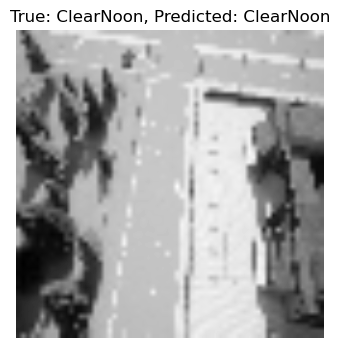

Sample Index: 212
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



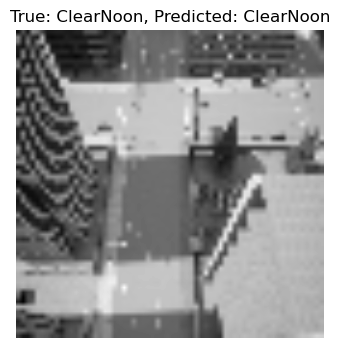

Sample Index: 213
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



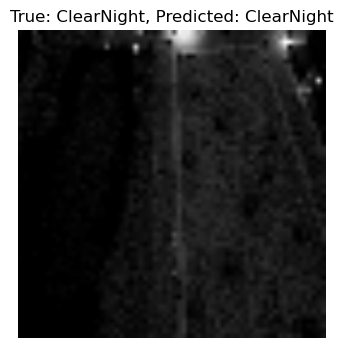

Sample Index: 214
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



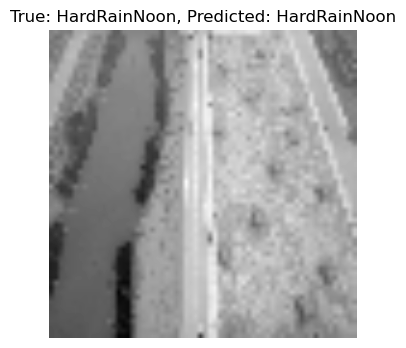

Sample Index: 215
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



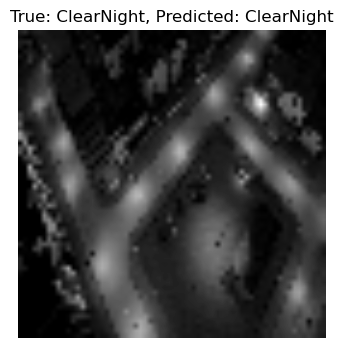

Sample Index: 216
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



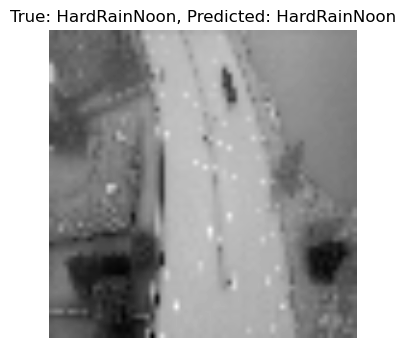

Sample Index: 217
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



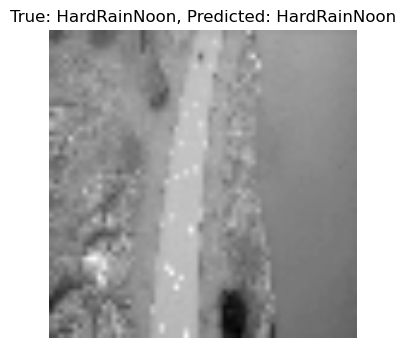

Sample Index: 218
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



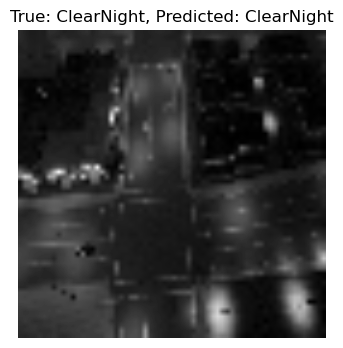

Sample Index: 219
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



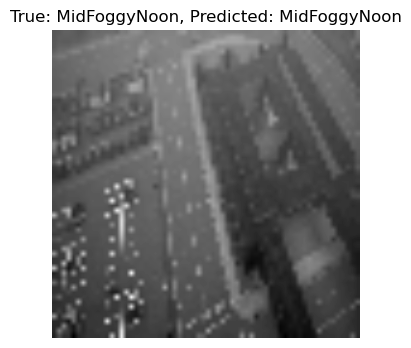

Sample Index: 220
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



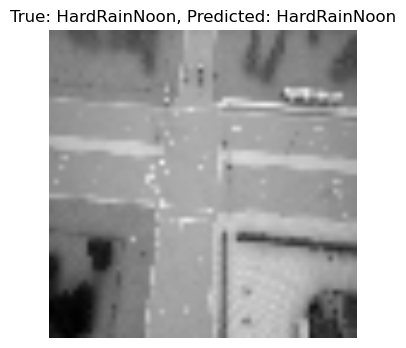

Sample Index: 221
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



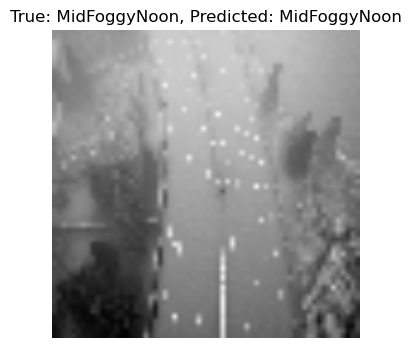

Sample Index: 222
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



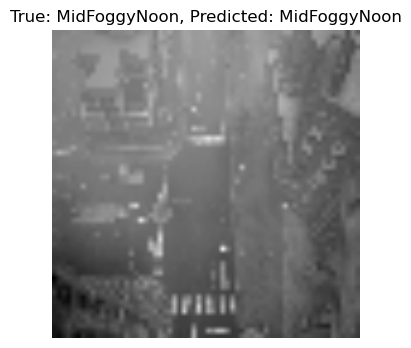

Sample Index: 223
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



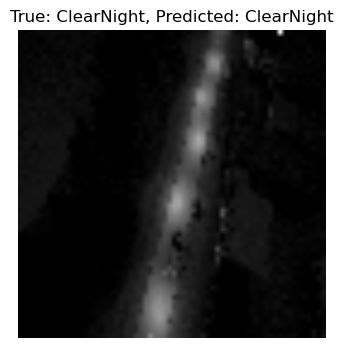

Sample Index: 224
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



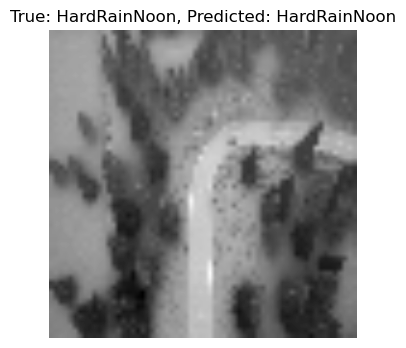

Sample Index: 225
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



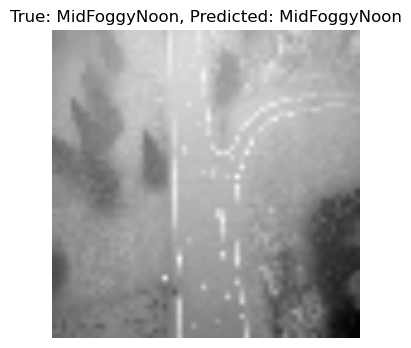

Sample Index: 226
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



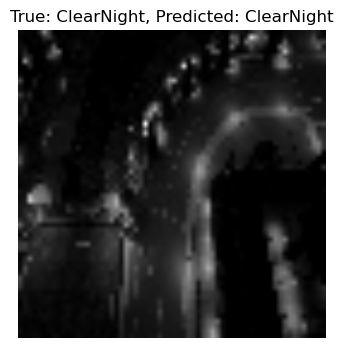

Sample Index: 227
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



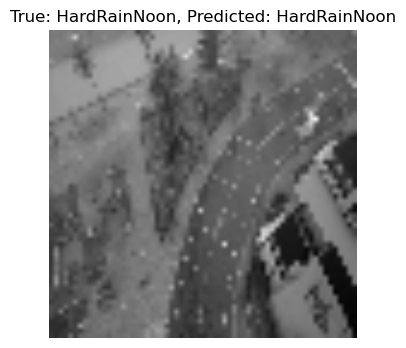

Sample Index: 228
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



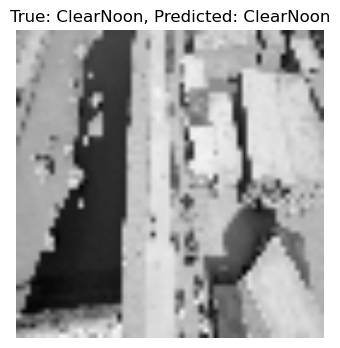

Sample Index: 229
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



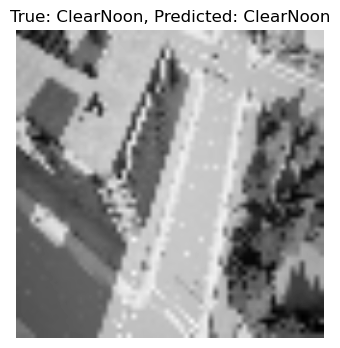

Sample Index: 230
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



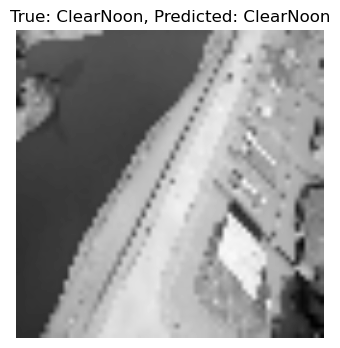

Sample Index: 231
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



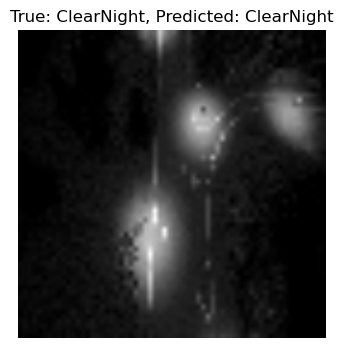

Sample Index: 232
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



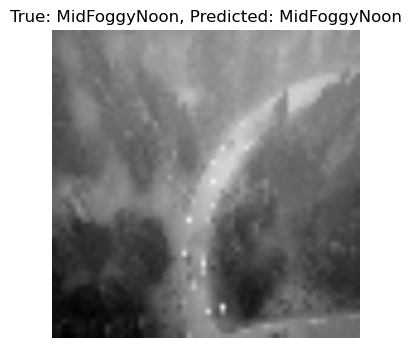

Sample Index: 233
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



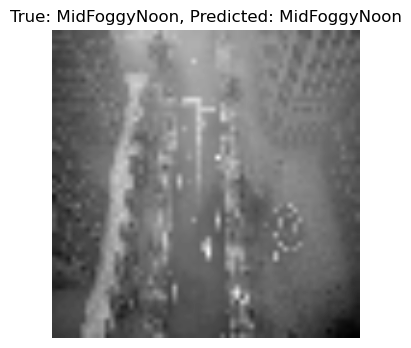

Sample Index: 234
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



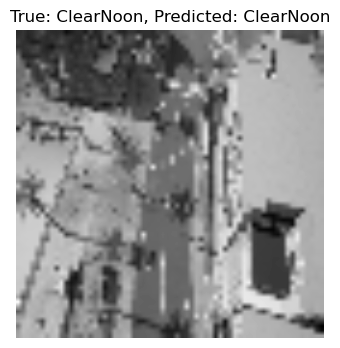

Sample Index: 235
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



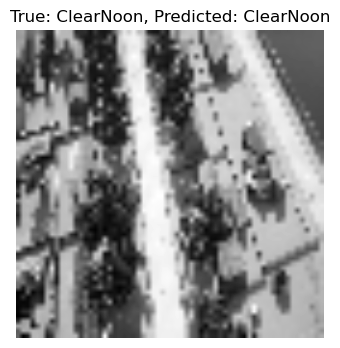

Sample Index: 236
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



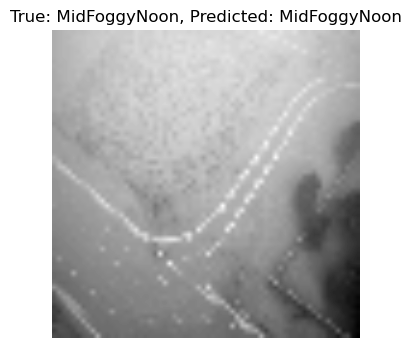

Sample Index: 237
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



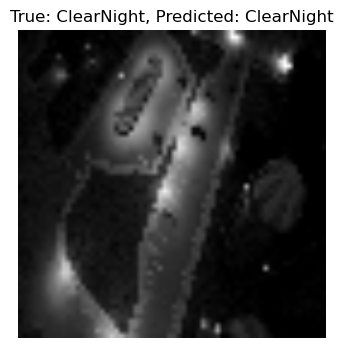

Sample Index: 238
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



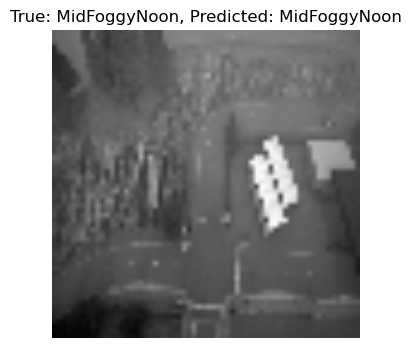

Sample Index: 239
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



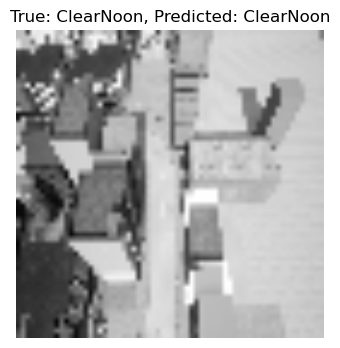

Sample Index: 240
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



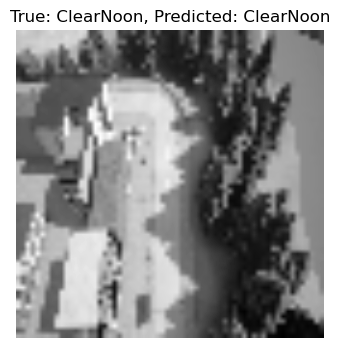

Sample Index: 241
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



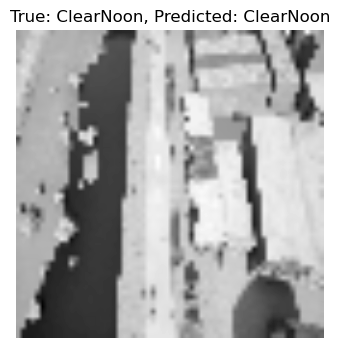

Sample Index: 242
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



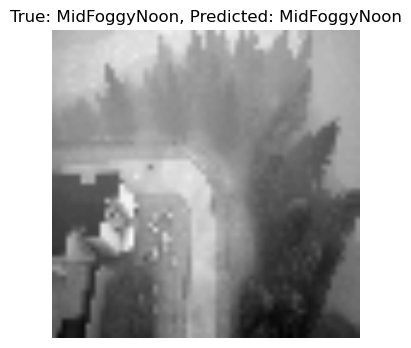

Sample Index: 243
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



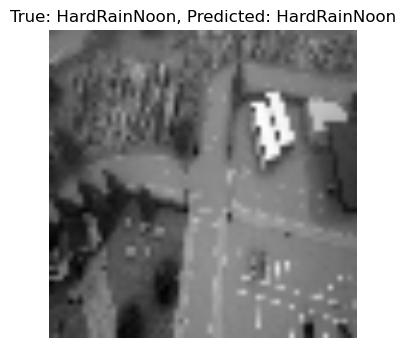

Sample Index: 244
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



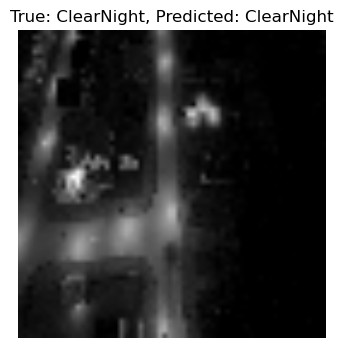

Sample Index: 245
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



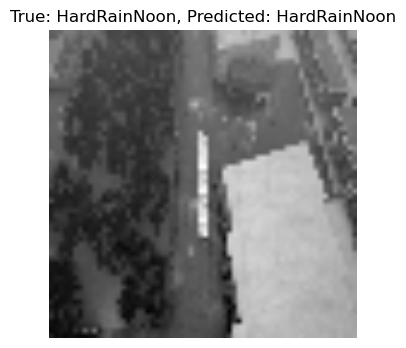

Sample Index: 246
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



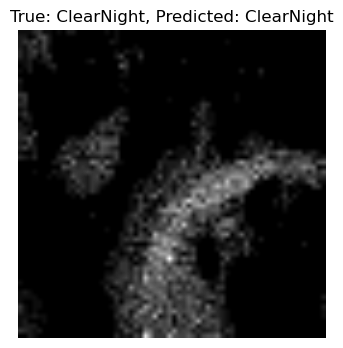

Sample Index: 247
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



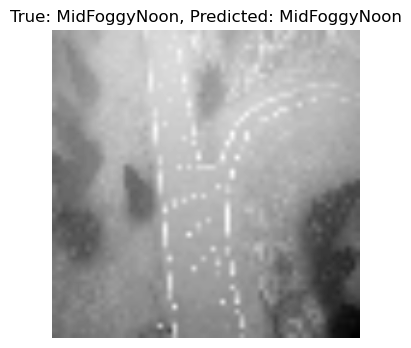

Sample Index: 248
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



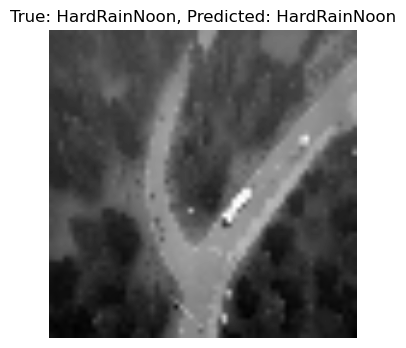

Sample Index: 249
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



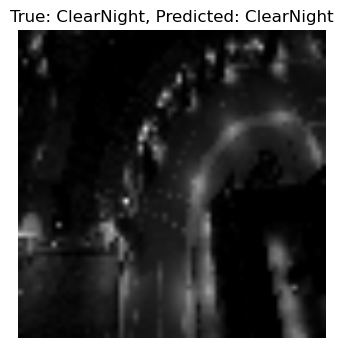

Sample Index: 250
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



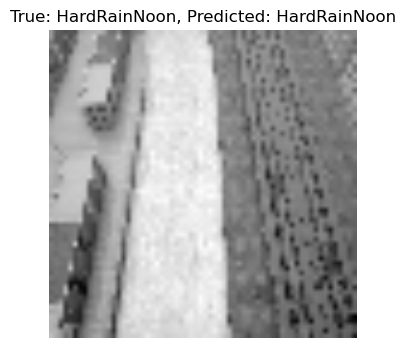

Sample Index: 251
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



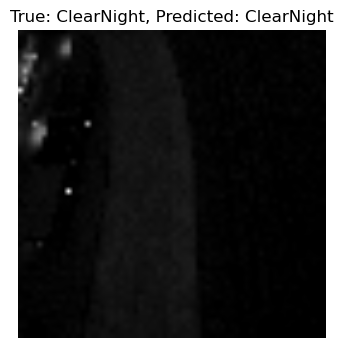

Sample Index: 252
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



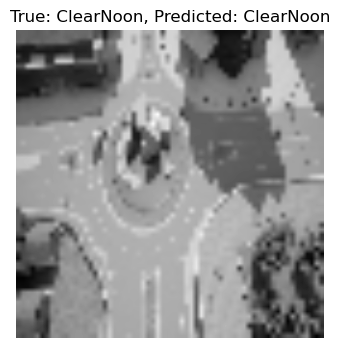

Sample Index: 253
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



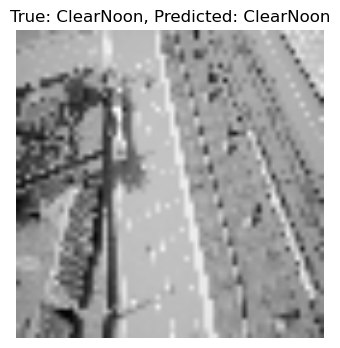

Sample Index: 254
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



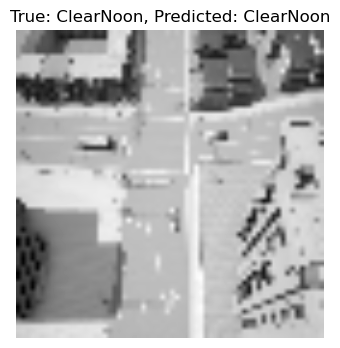

Sample Index: 255
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



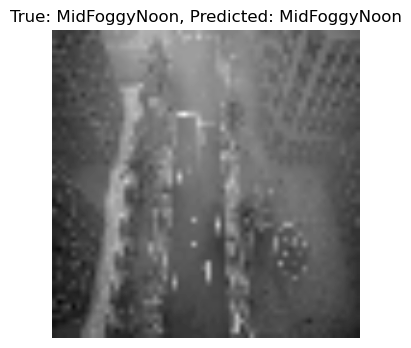

Sample Index: 256
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



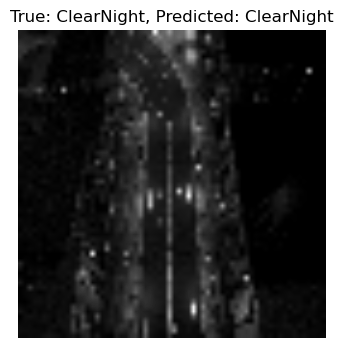

Sample Index: 257
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



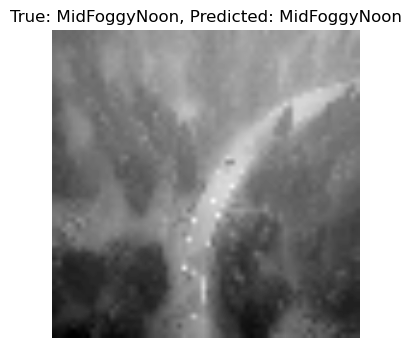

Sample Index: 258
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



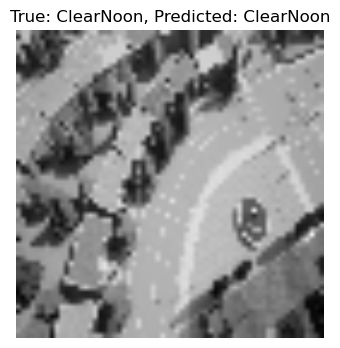

Sample Index: 259
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



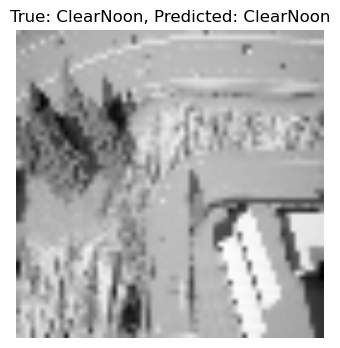

Sample Index: 260
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



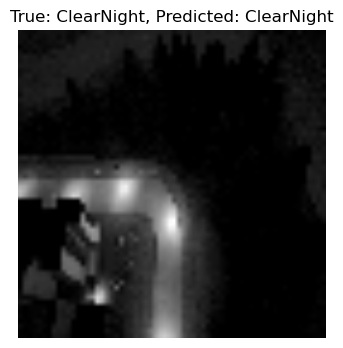

Sample Index: 261
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



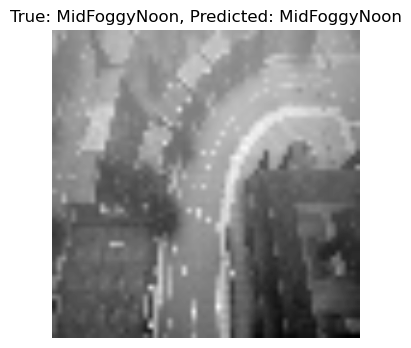

Sample Index: 262
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



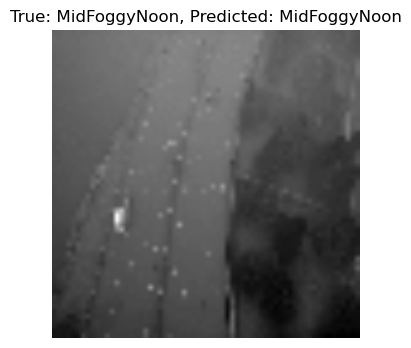

Sample Index: 263
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



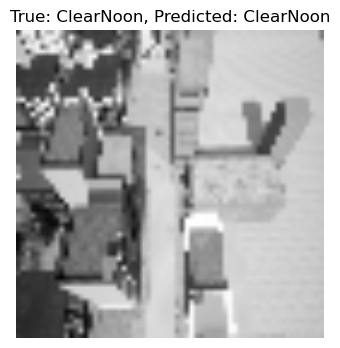

Sample Index: 264
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



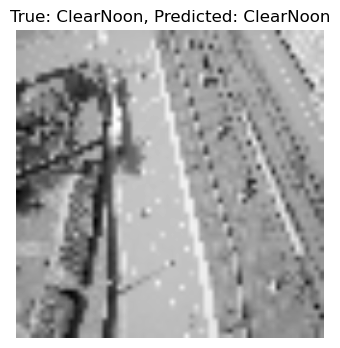

Sample Index: 265
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



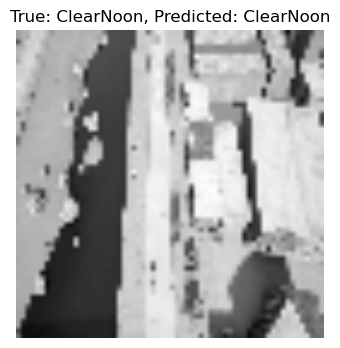

Sample Index: 266
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



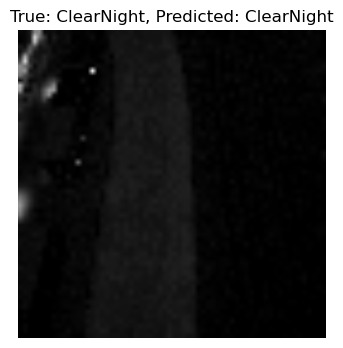

Sample Index: 267
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



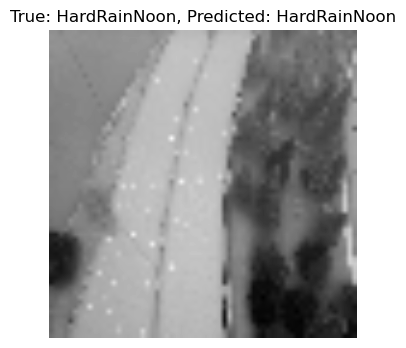

Sample Index: 268
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



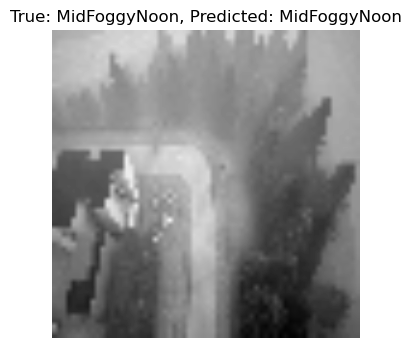

Sample Index: 269
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



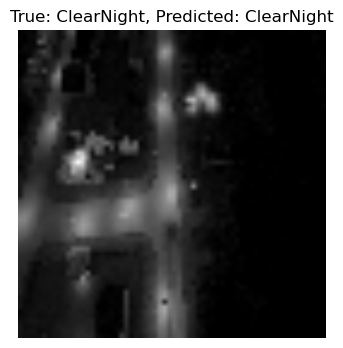

Sample Index: 270
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



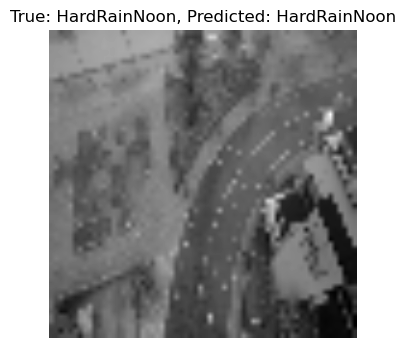

Sample Index: 271
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



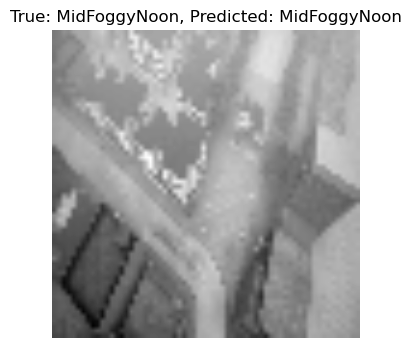

Sample Index: 272
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



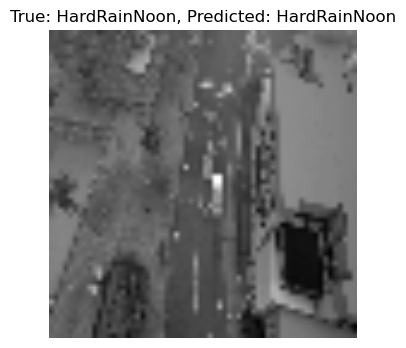

Sample Index: 273
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



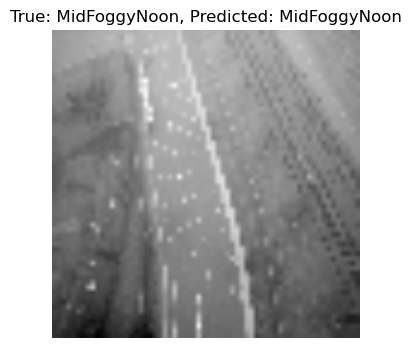

Sample Index: 274
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



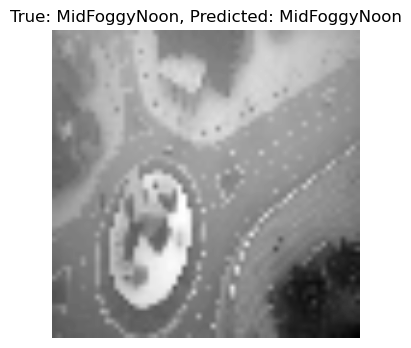

Sample Index: 275
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



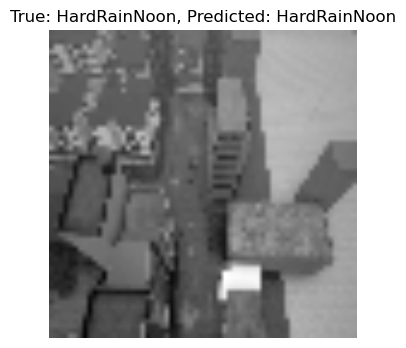

Sample Index: 276
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



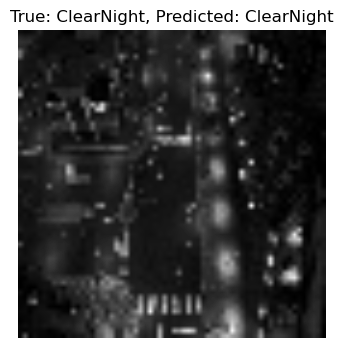

Sample Index: 277
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



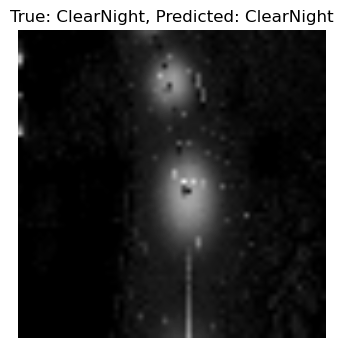

Sample Index: 278
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



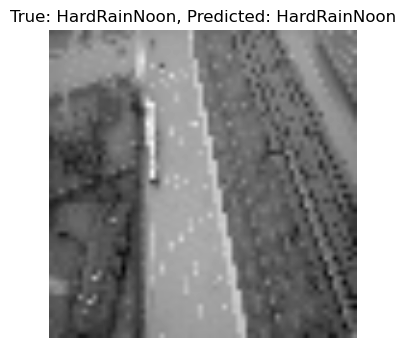

Sample Index: 279
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



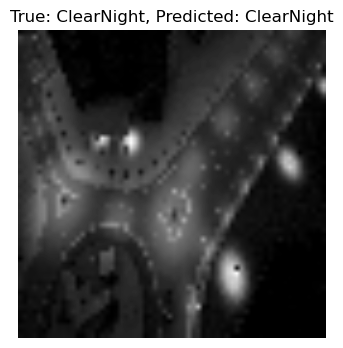

Sample Index: 280
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



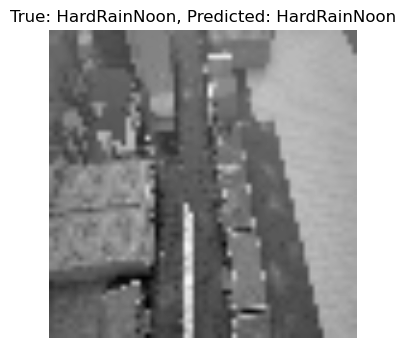

Sample Index: 281
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



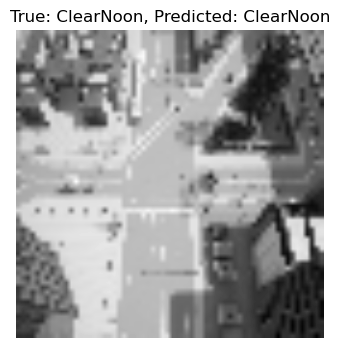

Sample Index: 282
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



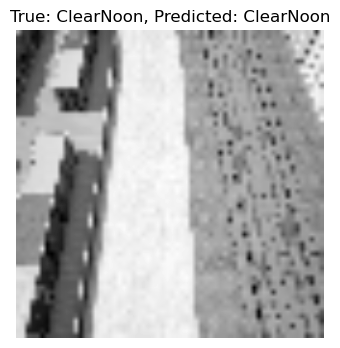

Sample Index: 283
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



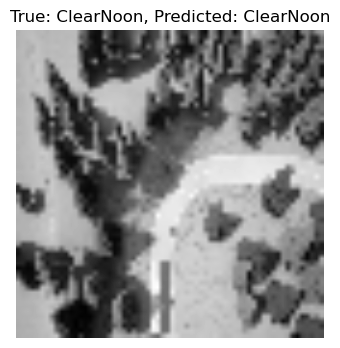

Sample Index: 284
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



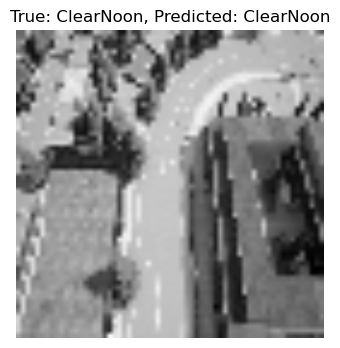

Sample Index: 285
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



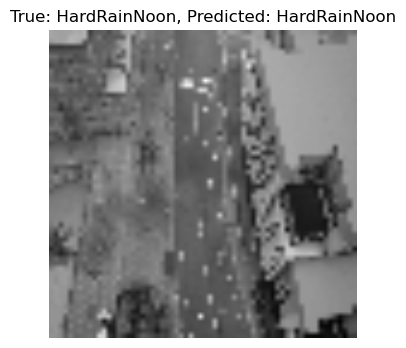

Sample Index: 286
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



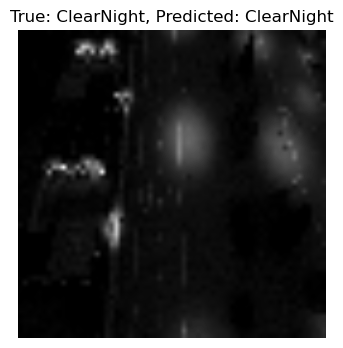

Sample Index: 287
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



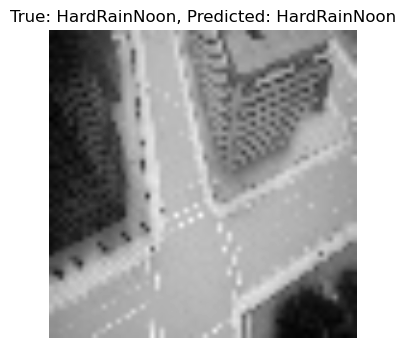

Sample Index: 288
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



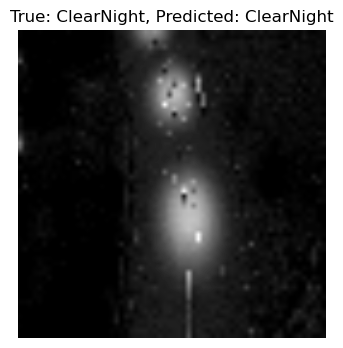

Sample Index: 289
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



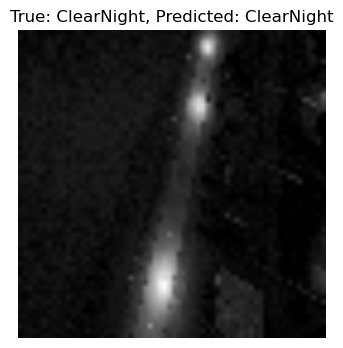

Sample Index: 290
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



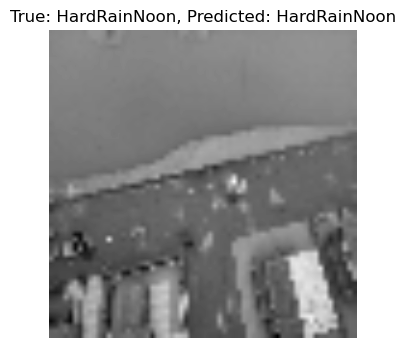

Sample Index: 291
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



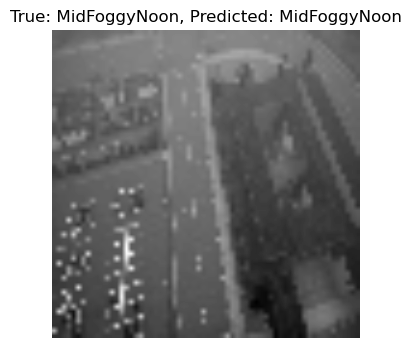

Sample Index: 292
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



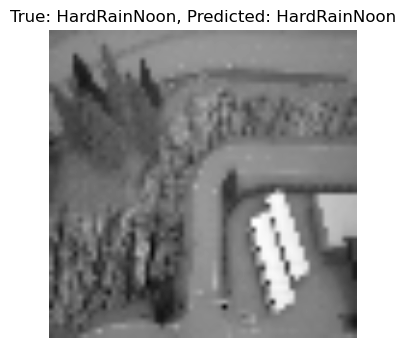

Sample Index: 293
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



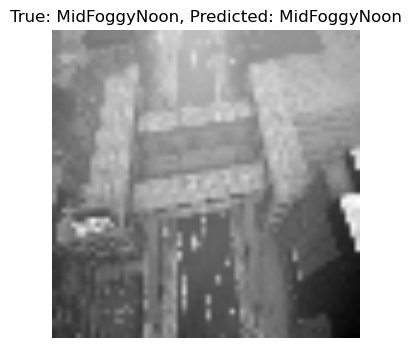

Sample Index: 294
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



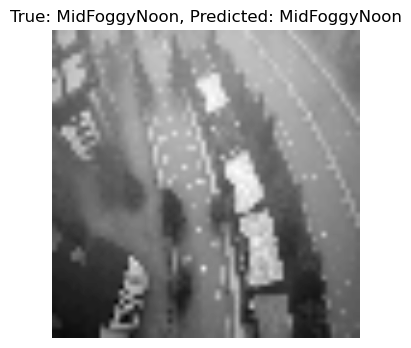

Sample Index: 295
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



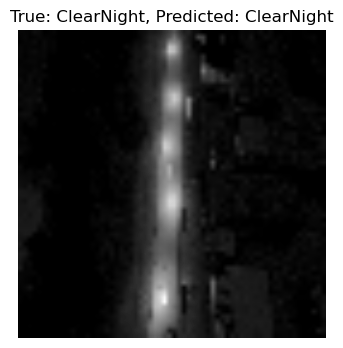

Sample Index: 296
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



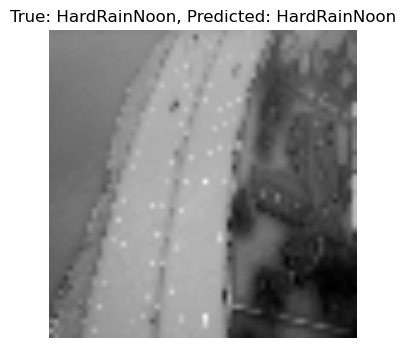

Sample Index: 297
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



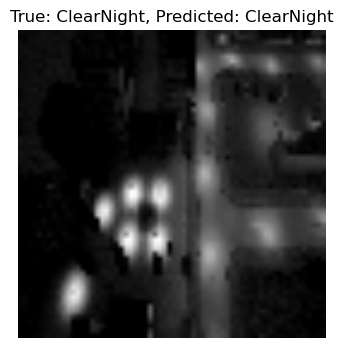

Sample Index: 298
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



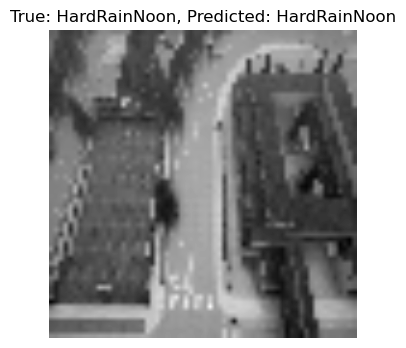

Sample Index: 299
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



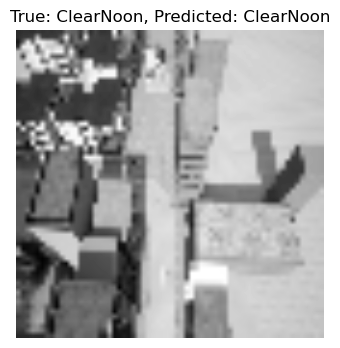

Sample Index: 300
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



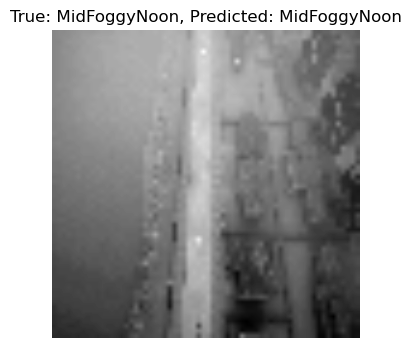

Sample Index: 301
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



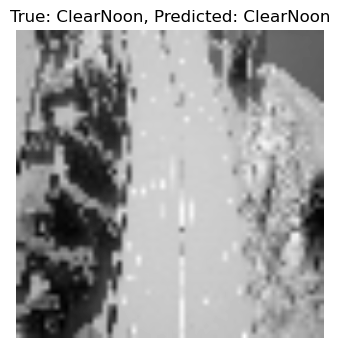

Sample Index: 302
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



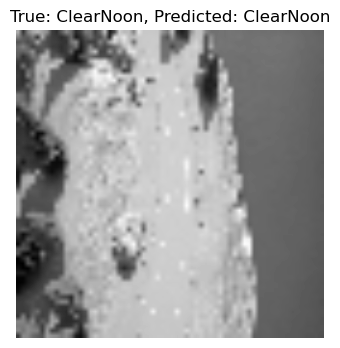

Sample Index: 303
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



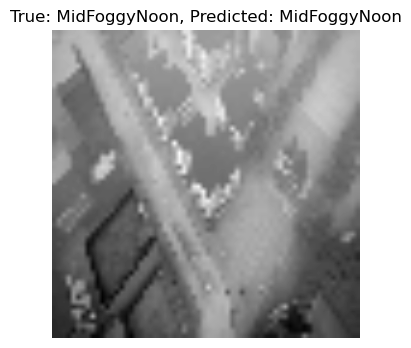

Sample Index: 304
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



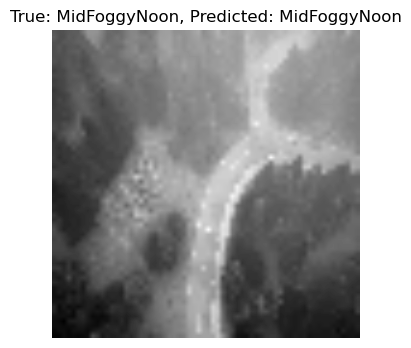

Sample Index: 305
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



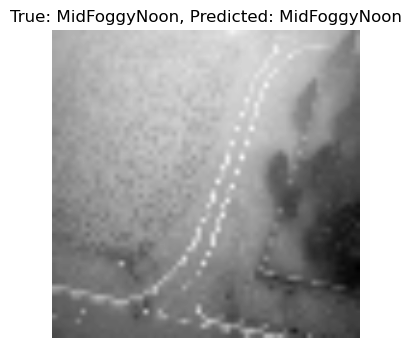

Sample Index: 306
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



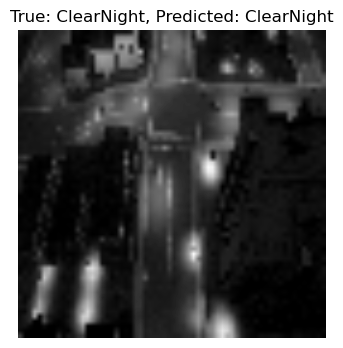

Sample Index: 307
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



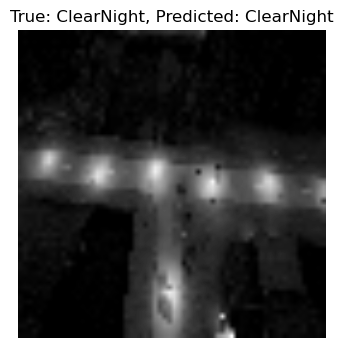

Sample Index: 308
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



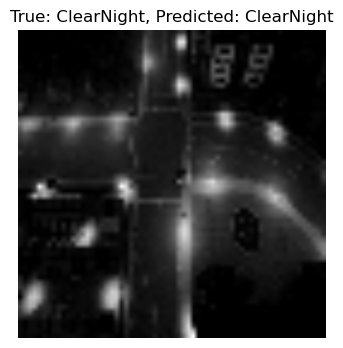

Sample Index: 309
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



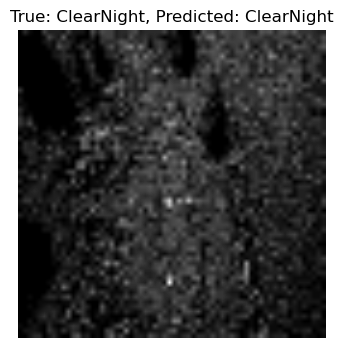

Sample Index: 310
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



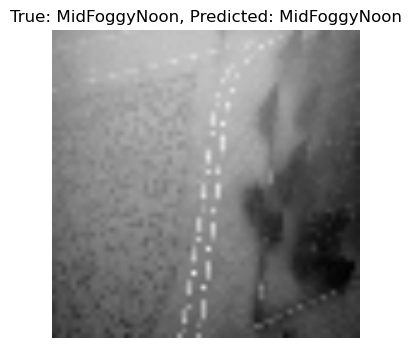

Sample Index: 311
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



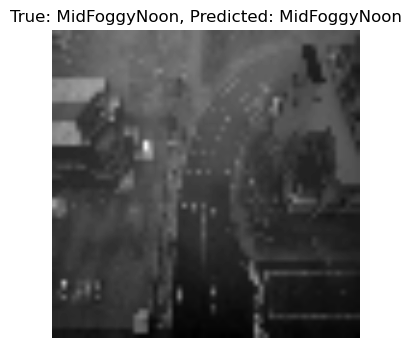

Sample Index: 312
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



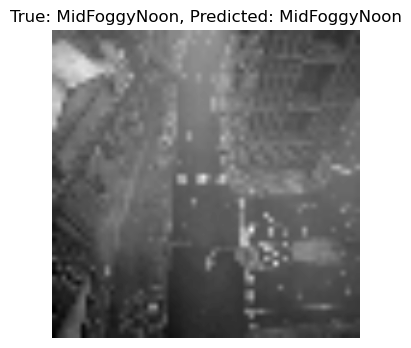

Sample Index: 313
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



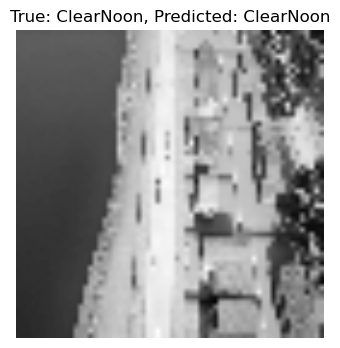

Sample Index: 314
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



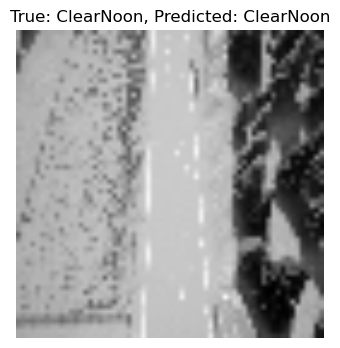

Sample Index: 315
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



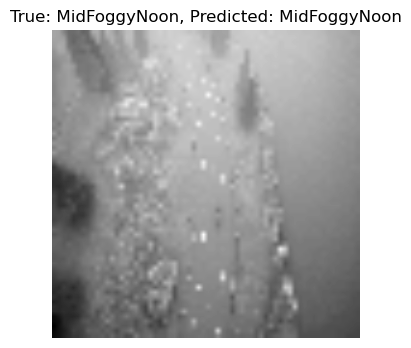

Sample Index: 316
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



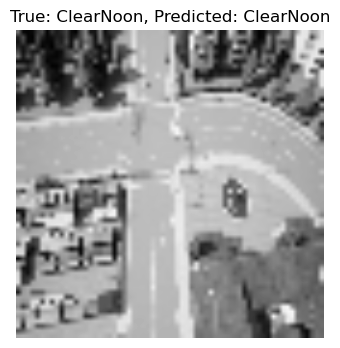

Sample Index: 317
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



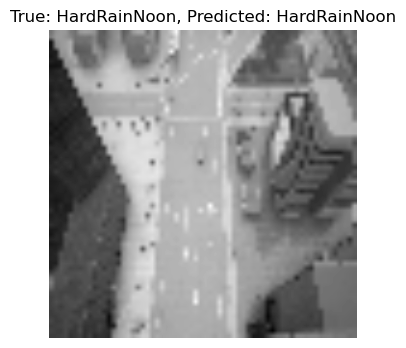

Sample Index: 318
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



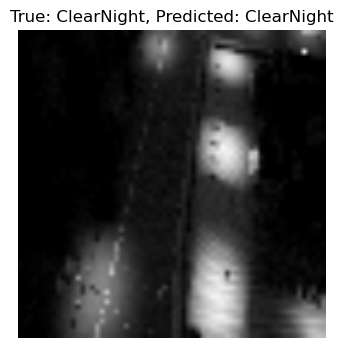

Sample Index: 319
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



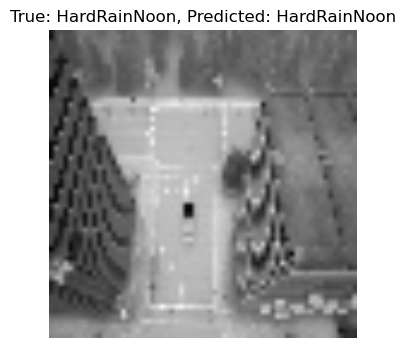

Sample Index: 320
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



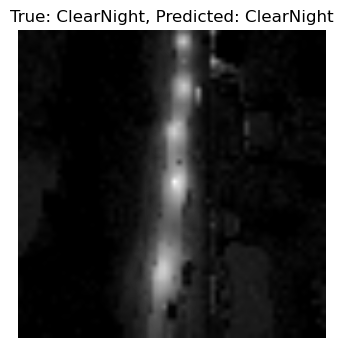

Sample Index: 321
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



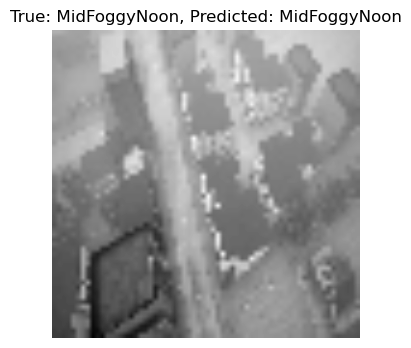

Sample Index: 322
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



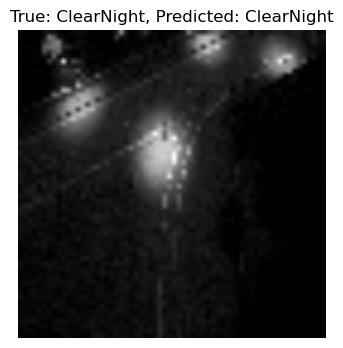

Sample Index: 323
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



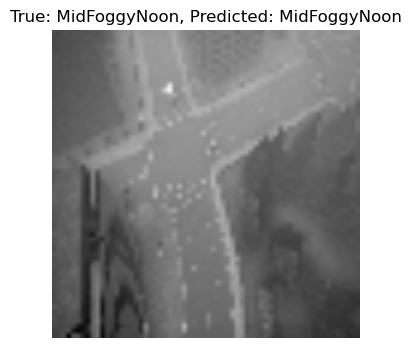

Sample Index: 324
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



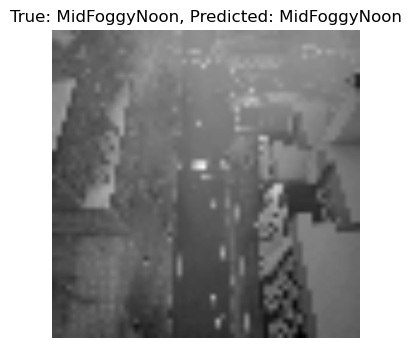

Sample Index: 325
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



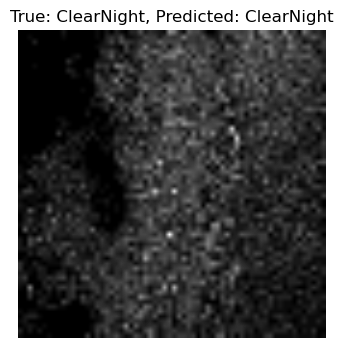

Sample Index: 326
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



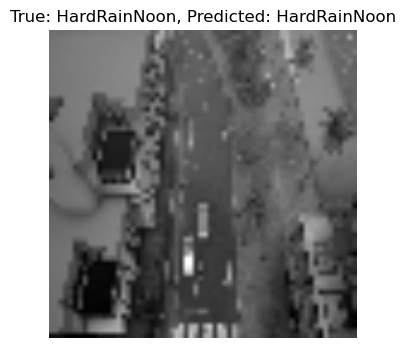

Sample Index: 327
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



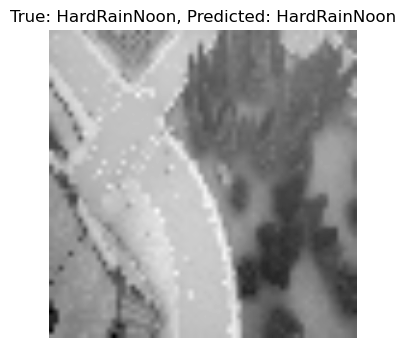

Sample Index: 328
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



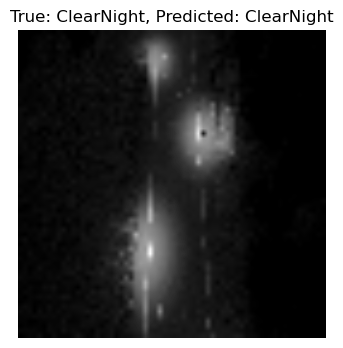

Sample Index: 329
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



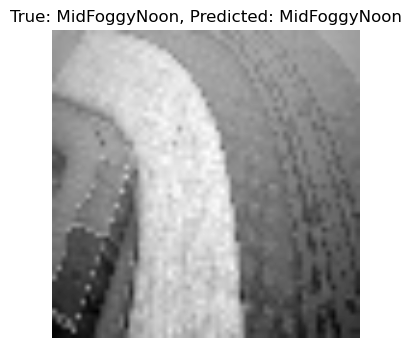

Sample Index: 330
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



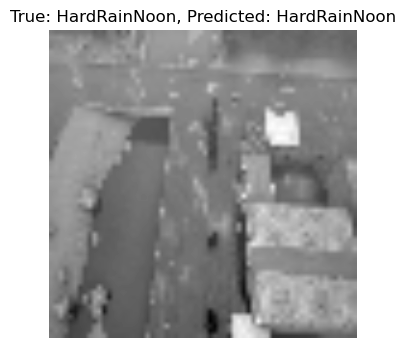

Sample Index: 331
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



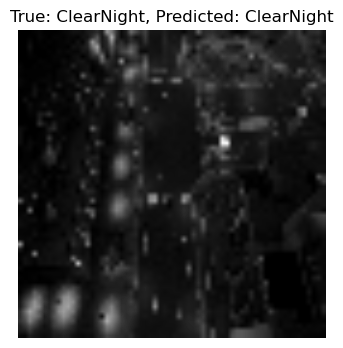

Sample Index: 332
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



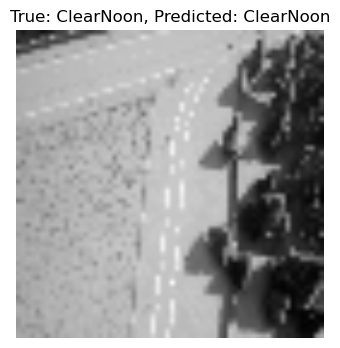

Sample Index: 333
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



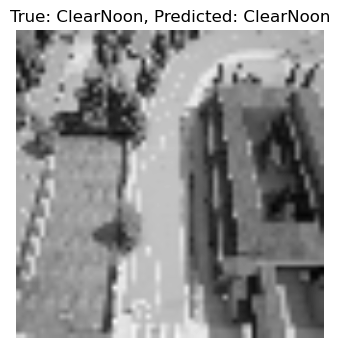

Sample Index: 334
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



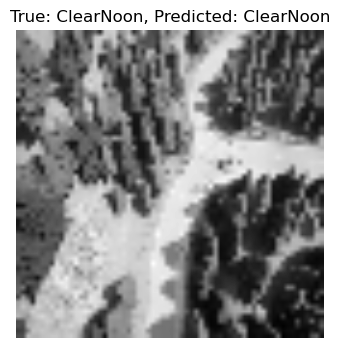

Sample Index: 335
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



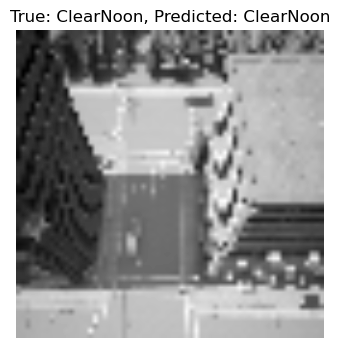

Sample Index: 336
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



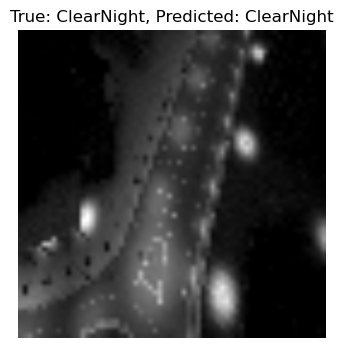

Sample Index: 337
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



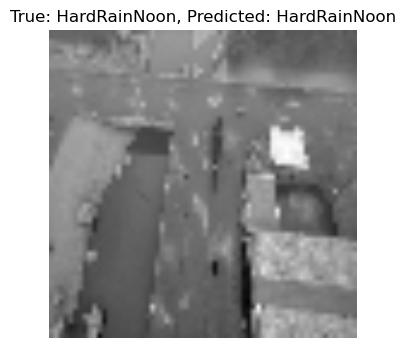

Sample Index: 338
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



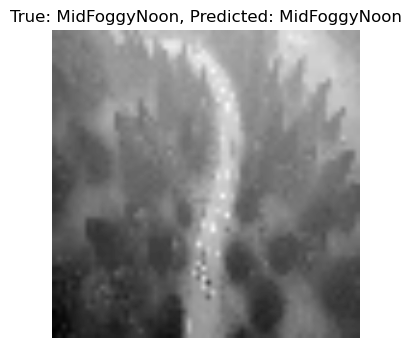

Sample Index: 339
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



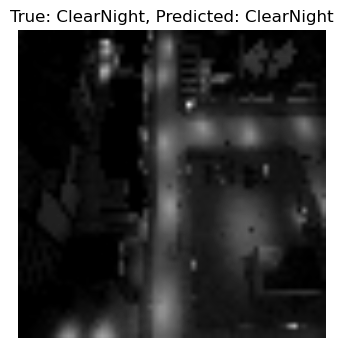

Sample Index: 340
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



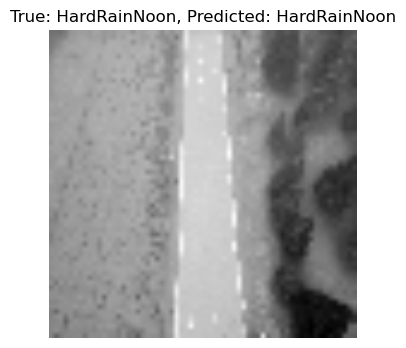

Sample Index: 341
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



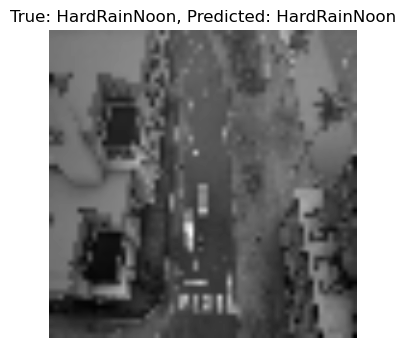

Sample Index: 342
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



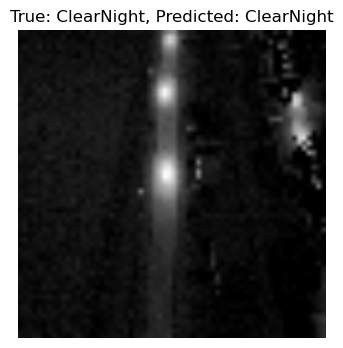

Sample Index: 343
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



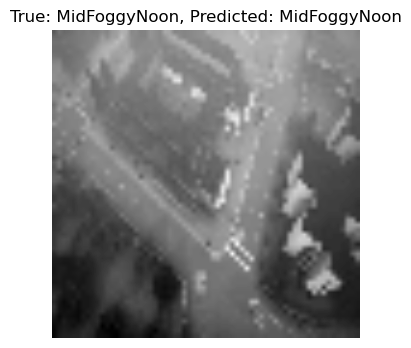

Sample Index: 344
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



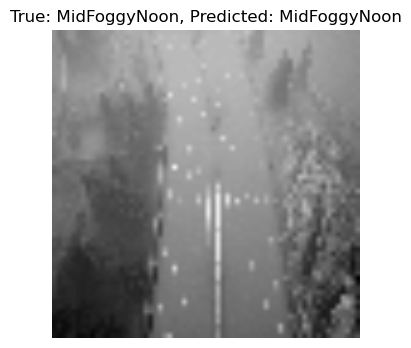

Sample Index: 345
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



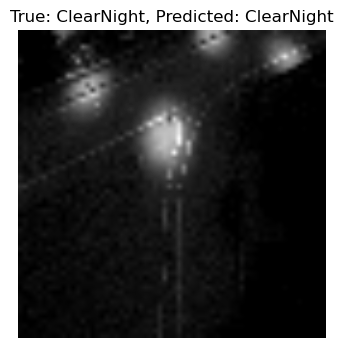

Sample Index: 346
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



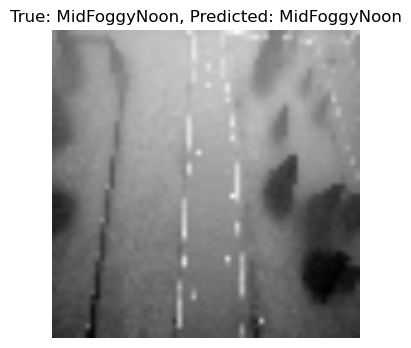

Sample Index: 347
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



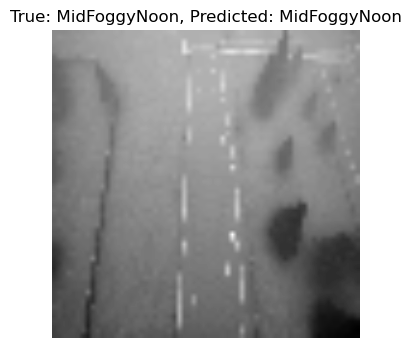

Sample Index: 348
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



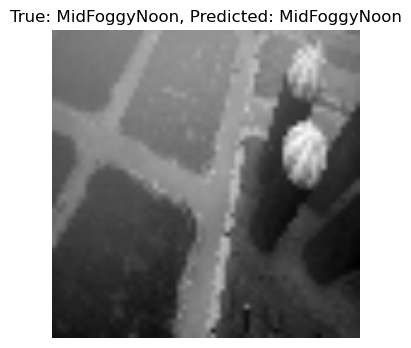

Sample Index: 349
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



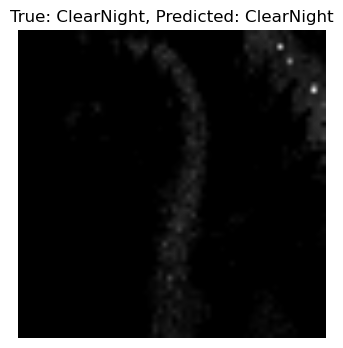

Sample Index: 350
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



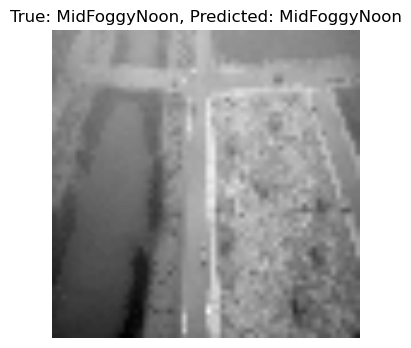

Sample Index: 351
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



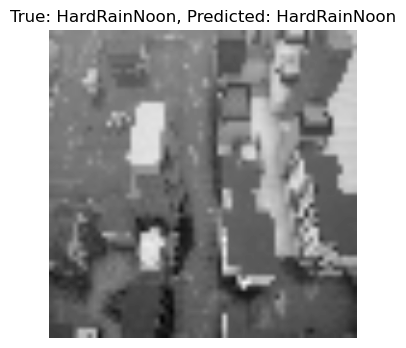

Sample Index: 352
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



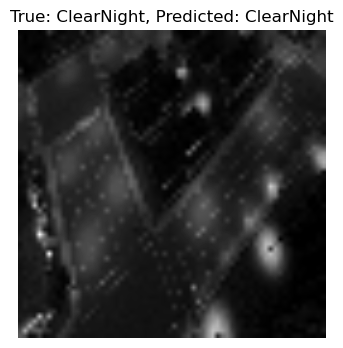

Sample Index: 353
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



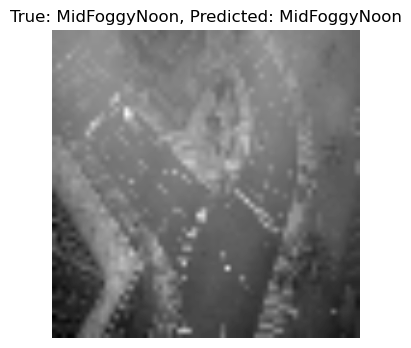

Sample Index: 354
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



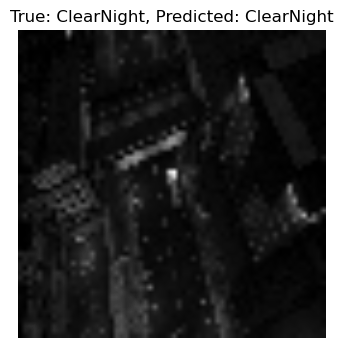

Sample Index: 355
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



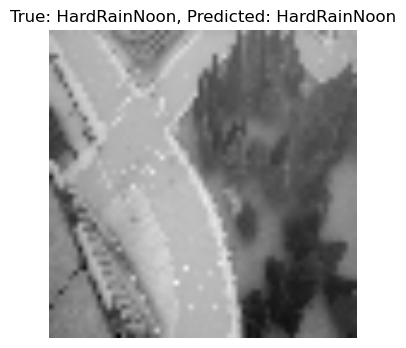

Sample Index: 356
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



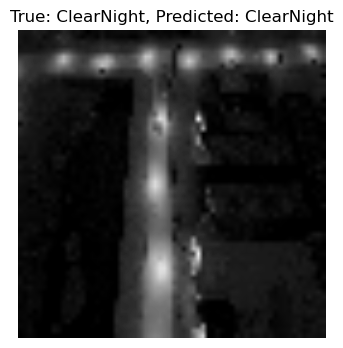

Sample Index: 357
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



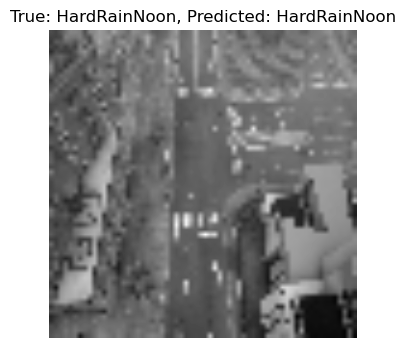

Sample Index: 358
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



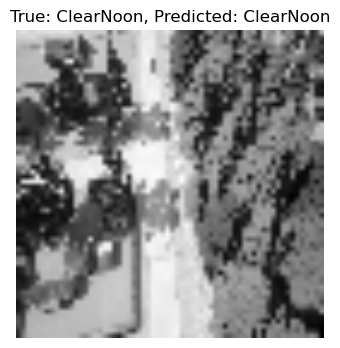

Sample Index: 359
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



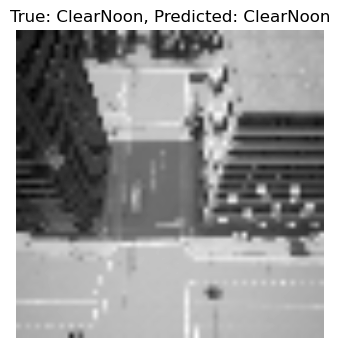

Sample Index: 360
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



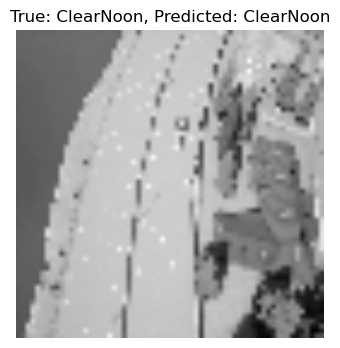

Sample Index: 361
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



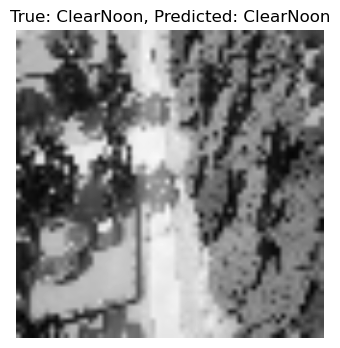

Sample Index: 362
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



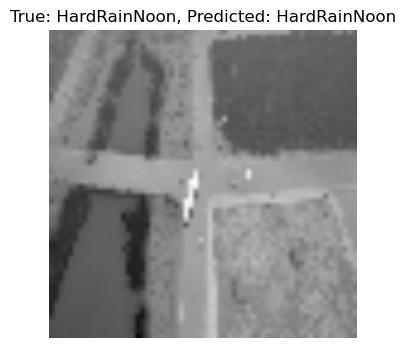

Sample Index: 363
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



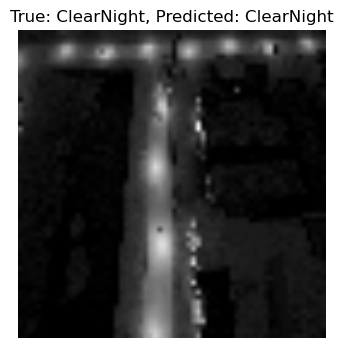

Sample Index: 364
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



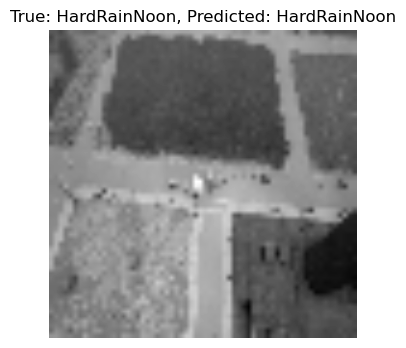

Sample Index: 365
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



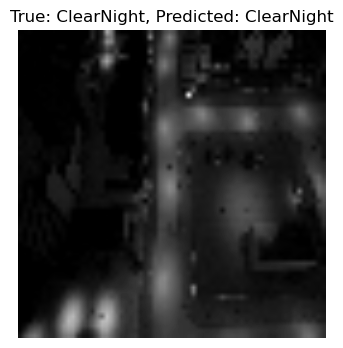

Sample Index: 366
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



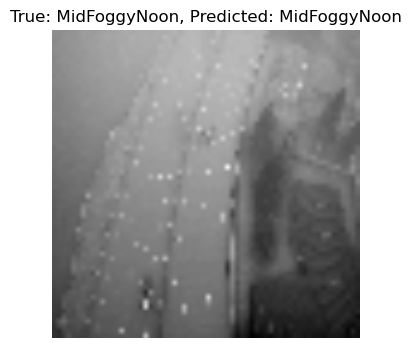

Sample Index: 367
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



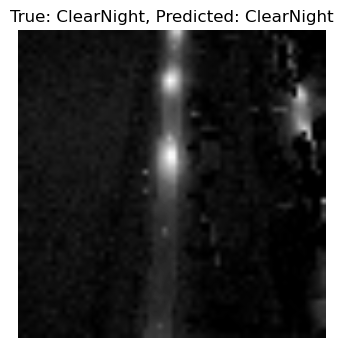

Sample Index: 368
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



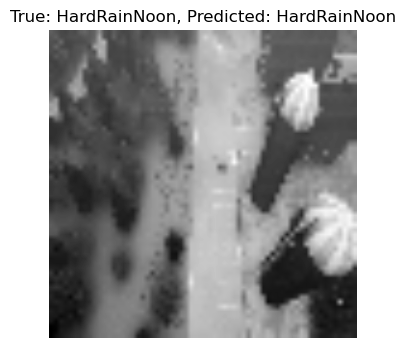

Sample Index: 369
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



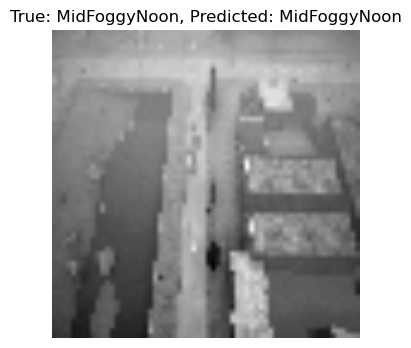

Sample Index: 370
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



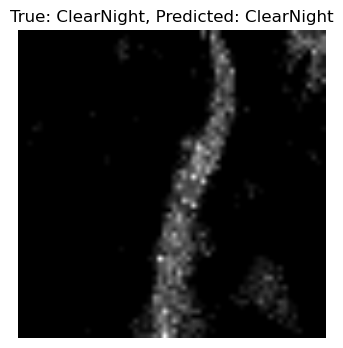

Sample Index: 371
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



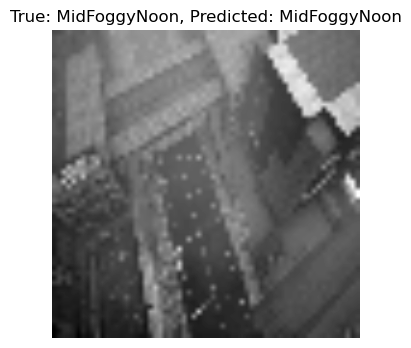

Sample Index: 372
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



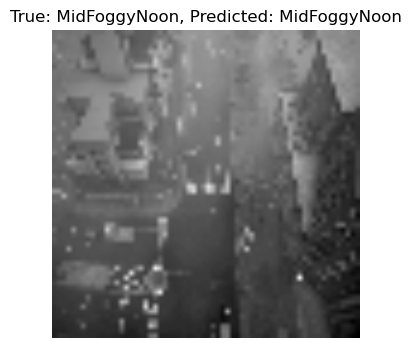

Sample Index: 373
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



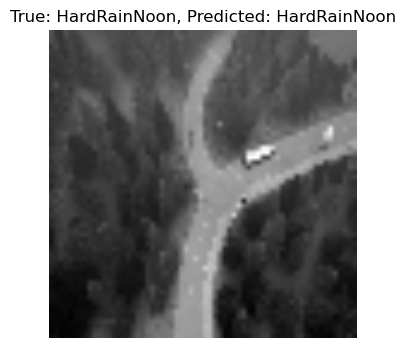

Sample Index: 374
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



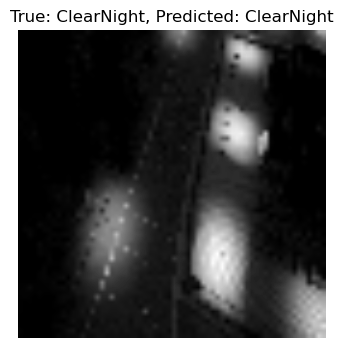

Sample Index: 375
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



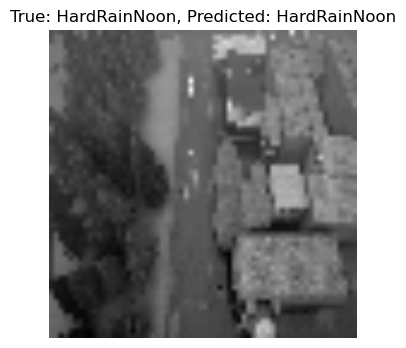

Sample Index: 376
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



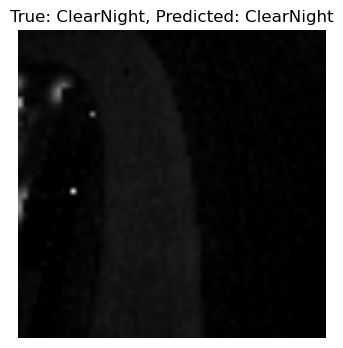

Sample Index: 377
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



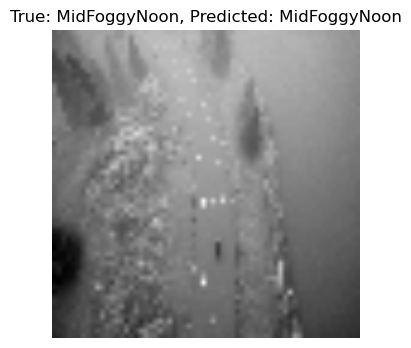

Sample Index: 378
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



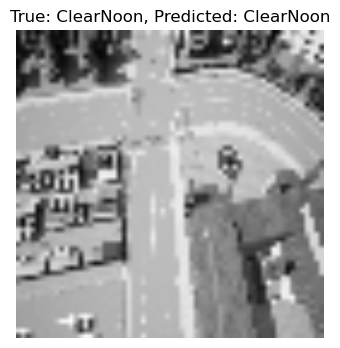

Sample Index: 379
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



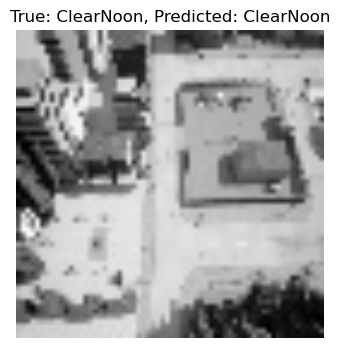

Sample Index: 380
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



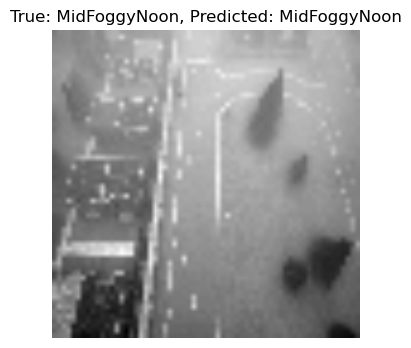

Sample Index: 381
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



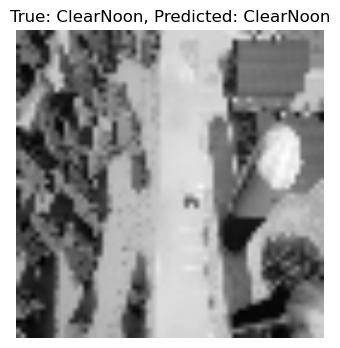

Sample Index: 382
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



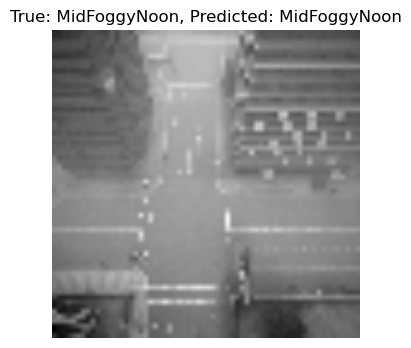

Sample Index: 383
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



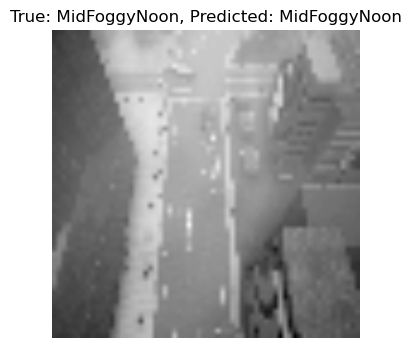

Sample Index: 384
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



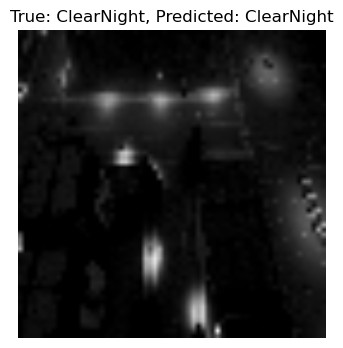

Sample Index: 385
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



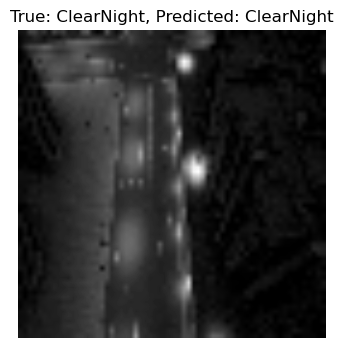

Sample Index: 386
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



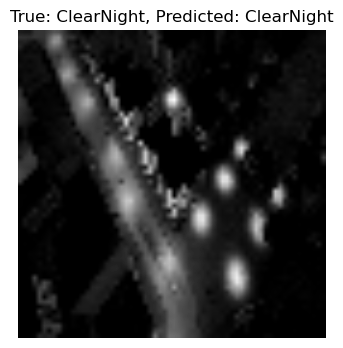

Sample Index: 387
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



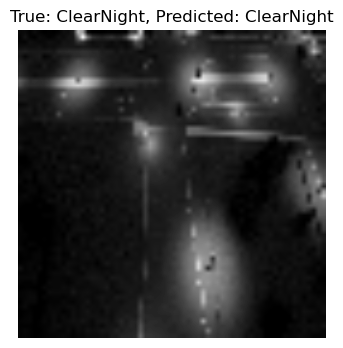

Sample Index: 388
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



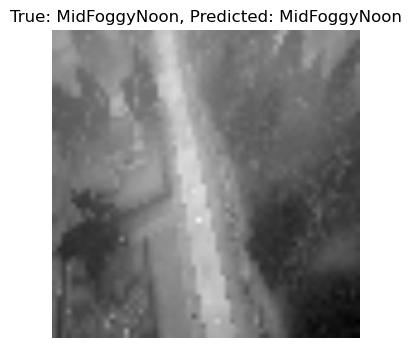

Sample Index: 389
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



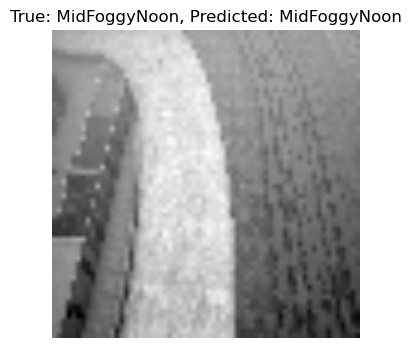

Sample Index: 390
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



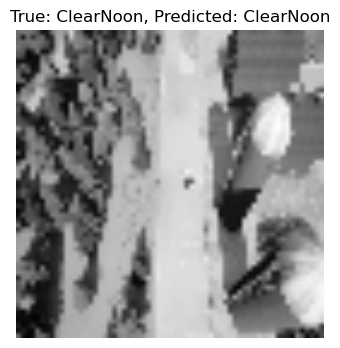

Sample Index: 391
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



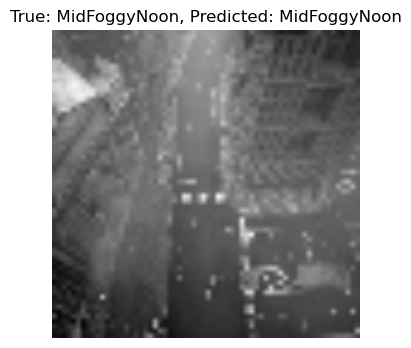

Sample Index: 392
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



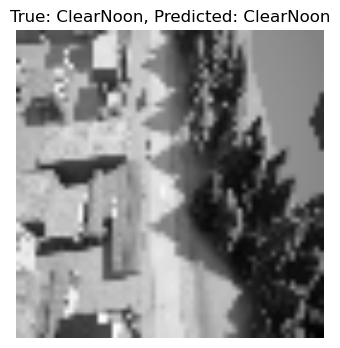

Sample Index: 393
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



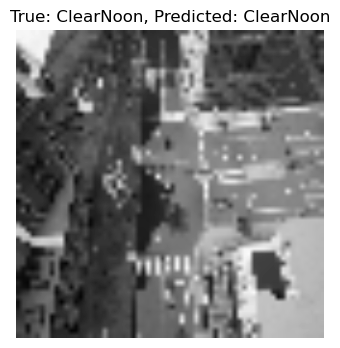

Sample Index: 394
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon



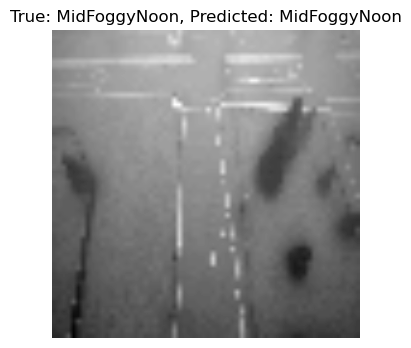

Sample Index: 395
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon



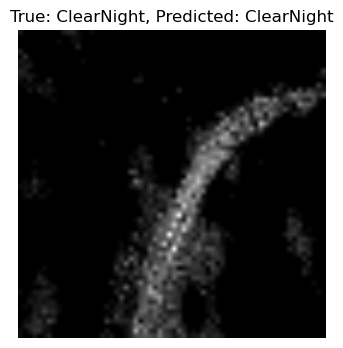

Sample Index: 396
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



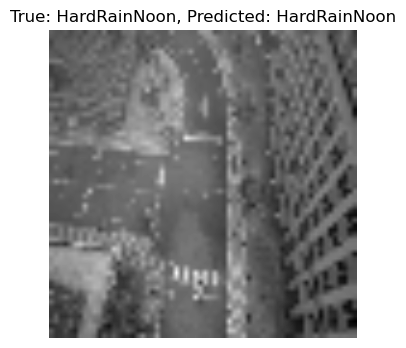

Sample Index: 397
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



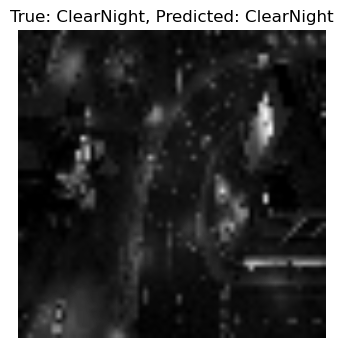

Sample Index: 398
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight



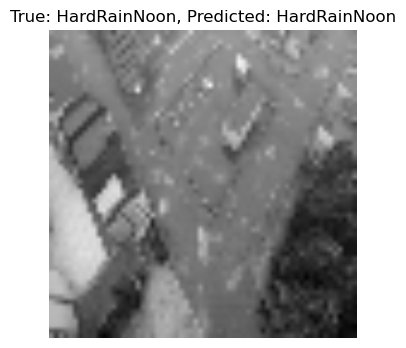

Sample Index: 399
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon



In [42]:
# Make predictions on the entire test set for Dataset 3
all_predictions_test_rbf = svm_model_rbf.predict(flat_images_test_scaled)
dpi_value = 100

# Show all test predictions for Dataset 3 (syndrone)
for i in range(len(labels3_test)):
    plt.figure(figsize=(4, 4))

    # Determine the dataset (Dataset 3 - syndrone)
    dataset_path = dataset3_path
    dataset_name = "Dataset 3 (syndrone)"
    img_path = os.path.join(dataset_path, 'test', labels3_test[i])

    plt.imshow(all_images_test[i].reshape(target_size), cmap='gray', interpolation='bilinear')
    plt.title(f"True: {label_encoder_train.classes_[encoded_labels_test[i]]}, Predicted: {label_encoder_train.classes_[all_predictions_test_rbf[i]]}")
    plt.axis('off')
    plt.show()

    print(f"Sample Index: {i}")
    print(f"True Label: {label_encoder_train.classes_[encoded_labels_test[i]]}")
    print(f"Predicted Label: {label_encoder_train.classes_[all_predictions_test_rbf[i]]}")
    print(f"{dataset_name} - Path: {img_path}")
    print()


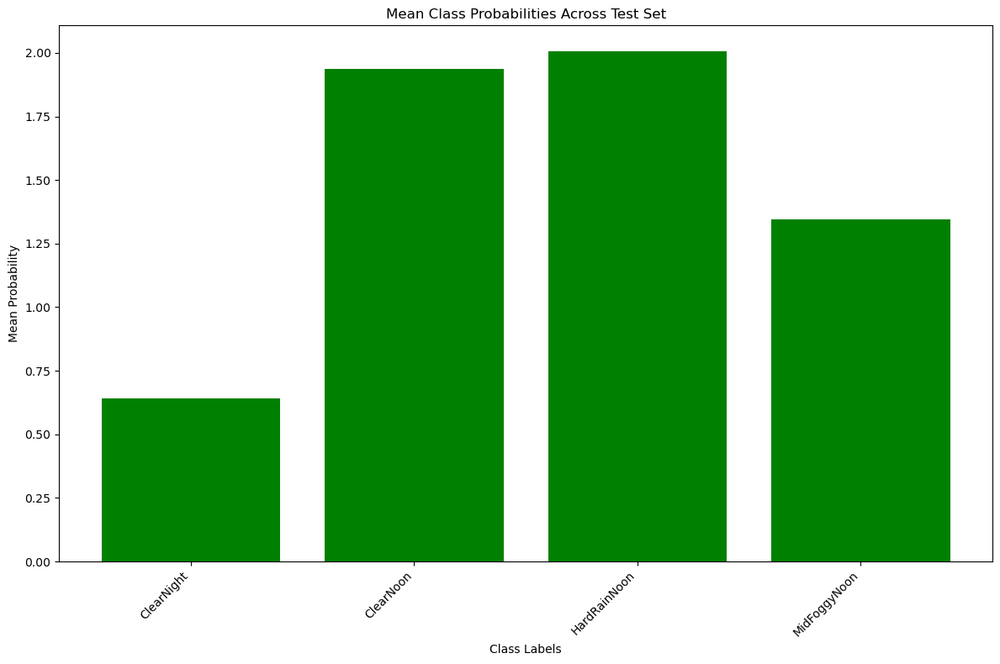

In [43]:
#calculate mean class probabilities across all samples
mean_class_probabilities = np.mean(svm_model_rbf.decision_function(flat_images_test_scaled), axis=0)

#plot the bar chart for mean class probabilities
plt.figure(figsize=(12, 8))
plt.bar(label_encoder_train.classes_, mean_class_probabilities, color='green')

#rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')  # Adjust the rotation angle and alignment as needed

plt.title("Mean Class Probabilities Across Test Set")
plt.xlabel("Class Labels")
plt.ylabel("Mean Probability")

#adjust layout to prevent label overlap
plt.tight_layout()

plt.show()


In [14]:
#make predictions on the entire test set
all_predictions_test_rbf = svm_model_rbf.predict(flat_images_test_scaled)

#create a directory to save the results
results_dir = 'test_results'
target_size=(64, 64)
os.makedirs(results_dir, exist_ok=True)

# Save all test predictions
for i in range(len(all_images_test)):
    plt.figure(figsize=(4, 4))

    # Determine the dataset based on the index
    if i < len(labels1_test):
        dataset_path = dataset1_path
        dataset_name = "Dataset 1 (MWD)"
        img_path = os.path.join(dataset_path, 'test', labels1_test[i], f'{i}.png')
    elif i < len(labels1_test) + len(labels2_test):
        dataset_path = dataset2_path
        dataset_name = "Dataset 2 (ACDC)"
        img_path = os.path.join(dataset_path, 'test', labels2_test[i - len(labels1_test)], f'{i}.png')
    elif i < len(labels1_test) + len(labels2_test) + len(labels3_test):
        dataset_path = dataset3_path
        dataset_name = "Dataset 3 (syndrone)"
        img_path = os.path.join(dataset_path, 'test', labels3_test[i - len(labels1_test) - len(labels2_test)], f'{i}.png')
    else:
        dataset_path = dataset4_path
        dataset_name = "Dataset 4 (UAVid)"
        img_path = os.path.join(dataset_path, 'test', labels4_test[i - len(labels1_test) - len(labels2_test) - len(labels3_test)], f'{i}.png')

    plt.imshow(all_images_test[i].reshape(target_size), cmap='gray')
    plt.title(f"True: {label_encoder_train.classes_[encoded_labels_test[i]]}, Predicted: {label_encoder_train.classes_[all_predictions_test_rbf[i]]}")
    plt.axis('off')

    # Save the figure
    result_filename = os.path.join(results_dir, f'result_{i}.png')
    plt.savefig(result_filename)
    plt.close()

    print(f"Sample Index: {i}")
    print(f"True Label: {label_encoder_train.classes_[encoded_labels_test[i]]}")
    print(f"Predicted Label: {label_encoder_train.classes_[all_predictions_test_rbf[i]]}")
    print(f"{dataset_name} - Path: {img_path}")
    print(f"Result saved to: {result_filename}")
    print()


Sample Index: 0
True Label: cloudy
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test/cloudy/0.png
Result saved to: test_results/result_0.png

Sample Index: 1
True Label: cloudy
Predicted Label: HardRainNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/1.png
Result saved to: test_results/result_1.png

Sample Index: 2
True Label: cloudy
Predicted Label: MidFoggyNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/2.png
Result saved to: test_results/result_2.png

Sample Index: 3
True Label: cloudy
Predicted Label: ClearNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/3.png
Result saved to: test_results/result_3.png

Sample Index: 4
True Label: cloudy
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test/cloudy/4.png
Result saved to: test_results/result_4.png

Sample Index: 5
True Label: cloudy
Predicted Label: rain
Dataset 1 (MWD) - Path: MWD/test/cloudy/5.png
Result saved to: test_results/result_5.png

Sample Index: 6
True Label: cloudy
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/

Sample Index: 57
True Label: cloudy
Predicted Label: ClearNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/57.png
Result saved to: test_results/result_57.png

Sample Index: 58
True Label: cloudy
Predicted Label: ClearNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/58.png
Result saved to: test_results/result_58.png

Sample Index: 59
True Label: cloudy
Predicted Label: HardRainNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/59.png
Result saved to: test_results/result_59.png

Sample Index: 60
True Label: cloudy
Predicted Label: MidFoggyNoon
Dataset 1 (MWD) - Path: MWD/test/cloudy/60.png
Result saved to: test_results/result_60.png

Sample Index: 61
True Label: cloudy
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test/cloudy/61.png
Result saved to: test_results/result_61.png

Sample Index: 62
True Label: cloudy
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/cloudy/62.png
Result saved to: test_results/result_62.png

Sample Index: 63
True Label: cloudy
Predicted Label: rain
Dataset 1 (

Sample Index: 113
True Label: rain
Predicted Label: ClearNoon
Dataset 1 (MWD) - Path: MWD/test/rain/113.png
Result saved to: test_results/result_113.png

Sample Index: 114
True Label: rain
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test/rain/114.png
Result saved to: test_results/result_114.png

Sample Index: 115
True Label: rain
Predicted Label: rain
Dataset 1 (MWD) - Path: MWD/test/rain/115.png
Result saved to: test_results/result_115.png

Sample Index: 116
True Label: rain
Predicted Label: clear
Dataset 1 (MWD) - Path: MWD/test/rain/116.png
Result saved to: test_results/result_116.png

Sample Index: 117
True Label: rain
Predicted Label: ClearNoon
Dataset 1 (MWD) - Path: MWD/test/rain/117.png
Result saved to: test_results/result_117.png

Sample Index: 118
True Label: rain
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test/rain/118.png
Result saved to: test_results/result_118.png

Sample Index: 119
True Label: rain
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test

Sample Index: 168
True Label: shine
Predicted Label: shine
Dataset 1 (MWD) - Path: MWD/test/shine/168.png
Result saved to: test_results/result_168.png

Sample Index: 169
True Label: shine
Predicted Label: shine
Dataset 1 (MWD) - Path: MWD/test/shine/169.png
Result saved to: test_results/result_169.png

Sample Index: 170
True Label: shine
Predicted Label: rain
Dataset 1 (MWD) - Path: MWD/test/shine/170.png
Result saved to: test_results/result_170.png

Sample Index: 171
True Label: shine
Predicted Label: shine
Dataset 1 (MWD) - Path: MWD/test/shine/171.png
Result saved to: test_results/result_171.png

Sample Index: 172
True Label: shine
Predicted Label: shine
Dataset 1 (MWD) - Path: MWD/test/shine/172.png
Result saved to: test_results/result_172.png

Sample Index: 173
True Label: shine
Predicted Label: shine
Dataset 1 (MWD) - Path: MWD/test/shine/173.png
Result saved to: test_results/result_173.png

Sample Index: 174
True Label: shine
Predicted Label: shine
Dataset 1 (MWD) - Path: MWD/te

Sample Index: 223
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/223.png
Result saved to: test_results/result_223.png

Sample Index: 224
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/224.png
Result saved to: test_results/result_224.png

Sample Index: 225
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/225.png
Result saved to: test_results/result_225.png

Sample Index: 226
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/226.png
Result saved to: test_results/result_226.png

Sample Index: 227
True Label: sunrise
Predicted Label: rain
Dataset 1 (MWD) - Path: MWD/test/sunrise/227.png
Result saved to: test_results/result_227.png

Sample Index: 228
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/228.png
Result saved to: test_results/result_228.png

Sample Index: 229
True Label: sunrise
Predicted Label: 

Sample Index: 275
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/275.png
Result saved to: test_results/result_275.png

Sample Index: 276
True Label: sunrise
Predicted Label: cloudy
Dataset 1 (MWD) - Path: MWD/test/sunrise/276.png
Result saved to: test_results/result_276.png

Sample Index: 277
True Label: sunrise
Predicted Label: sunrise
Dataset 1 (MWD) - Path: MWD/test/sunrise/277.png
Result saved to: test_results/result_277.png

Sample Index: 278
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/278.png
Result saved to: test_results/result_278.png

Sample Index: 279
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/279.png
Result saved to: test_results/result_279.png

Sample Index: 280
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/280.png
Result saved to: test_results/result_280.png

Sample Index: 281
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) 

Sample Index: 330
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACDC/test/clear/330.png
Result saved to: test_results/result_330.png

Sample Index: 331
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACDC/test/clear/331.png
Result saved to: test_results/result_331.png

Sample Index: 332
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/332.png
Result saved to: test_results/result_332.png

Sample Index: 333
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/333.png
Result saved to: test_results/result_333.png

Sample Index: 334
True Label: fog
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/fog/334.png
Result saved to: test_results/result_334.png

Sample Index: 335
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/335.png
Result saved to: test_results/result_335.png

Sample Index: 336
True Label: rain
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/rain/

Sample Index: 388
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/388.png
Result saved to: test_results/result_388.png

Sample Index: 389
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/389.png
Result saved to: test_results/result_389.png

Sample Index: 390
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/390.png
Result saved to: test_results/result_390.png

Sample Index: 391
True Label: clear
Predicted Label: cloudy
Dataset 2 (ACDC) - Path: ACDC/test/clear/391.png
Result saved to: test_results/result_391.png

Sample Index: 392
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/392.png
Result saved to: test_results/result_392.png

Sample Index: 393
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACDC/test/clear/393.png
Result saved to: test_results/result_393.png

Sample Index: 394
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACD

Sample Index: 444
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/444.png
Result saved to: test_results/result_444.png

Sample Index: 445
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACDC/test/clear/445.png
Result saved to: test_results/result_445.png

Sample Index: 446
True Label: night
Predicted Label: ClearNight
Dataset 2 (ACDC) - Path: ACDC/test/night/446.png
Result saved to: test_results/result_446.png

Sample Index: 447
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/447.png
Result saved to: test_results/result_447.png

Sample Index: 448
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/448.png
Result saved to: test_results/result_448.png

Sample Index: 449
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/449.png
Result saved to: test_results/result_449.png

Sample Index: 450
True Label: night
Predicted Label: ClearNight
Dataset 2 (AC

Sample Index: 500
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/500.png
Result saved to: test_results/result_500.png

Sample Index: 501
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/501.png
Result saved to: test_results/result_501.png

Sample Index: 502
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/502.png
Result saved to: test_results/result_502.png

Sample Index: 503
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/503.png
Result saved to: test_results/result_503.png

Sample Index: 504
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/504.png
Result saved to: test_results/result_504.png

Sample Index: 505
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/505.png
Result saved to: test_results/result_505.png

Sample Index: 506
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/ra

Sample Index: 557
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/557.png
Result saved to: test_results/result_557.png

Sample Index: 558
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/558.png
Result saved to: test_results/result_558.png

Sample Index: 559
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/559.png
Result saved to: test_results/result_559.png

Sample Index: 560
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/560.png
Result saved to: test_results/result_560.png

Sample Index: 561
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/561.png
Result saved to: test_results/result_561.png

Sample Index: 562
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/562.png
Result saved to: test_results/result_562.png

Sample Index: 563
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/ra

Sample Index: 613
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/613.png
Result saved to: test_results/result_613.png

Sample Index: 614
True Label: snow
Predicted Label: snow
Dataset 2 (ACDC) - Path: ACDC/test/snow/614.png
Result saved to: test_results/result_614.png

Sample Index: 615
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/615.png
Result saved to: test_results/result_615.png

Sample Index: 616
True Label: snow
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/snow/616.png
Result saved to: test_results/result_616.png

Sample Index: 617
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/617.png
Result saved to: test_results/result_617.png

Sample Index: 618
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/618.png
Result saved to: test_results/result_618.png

Sample Index: 619
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/ra

Sample Index: 669
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACDC/test/clear/669.png
Result saved to: test_results/result_669.png

Sample Index: 670
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/670.png
Result saved to: test_results/result_670.png

Sample Index: 671
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/671.png
Result saved to: test_results/result_671.png

Sample Index: 672
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/672.png
Result saved to: test_results/result_672.png

Sample Index: 673
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/673.png
Result saved to: test_results/result_673.png

Sample Index: 674
True Label: rain
Predicted Label: rain
Dataset 2 (ACDC) - Path: ACDC/test/rain/674.png
Result saved to: test_results/result_674.png

Sample Index: 675
True Label: snow
Predicted Label: cloudy
Dataset 2 (ACDC) - Path: ACDC/test/sno

Sample Index: 725
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/725.png
Result saved to: test_results/result_725.png

Sample Index: 726
True Label: night
Predicted Label: night
Dataset 2 (ACDC) - Path: ACDC/test/night/726.png
Result saved to: test_results/result_726.png

Sample Index: 727
True Label: night
Predicted Label: ClearNight
Dataset 2 (ACDC) - Path: ACDC/test/night/727.png
Result saved to: test_results/result_727.png

Sample Index: 728
True Label: fog
Predicted Label: sunrise
Dataset 2 (ACDC) - Path: ACDC/test/fog/728.png
Result saved to: test_results/result_728.png

Sample Index: 729
True Label: fog
Predicted Label: fog
Dataset 2 (ACDC) - Path: ACDC/test/fog/729.png
Result saved to: test_results/result_729.png

Sample Index: 730
True Label: clear
Predicted Label: clear
Dataset 2 (ACDC) - Path: ACDC/test/clear/730.png
Result saved to: test_results/result_730.png

Sample Index: 731
True Label: clear
Predicted Label: rain
Dataset 2 (ACDC) - Pa

Sample Index: 781
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/781.png
Result saved to: test_results/result_781.png

Sample Index: 782
True Label: ClearNoon
Predicted Label: shine
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/782.png
Result saved to: test_results/result_782.png

Sample Index: 783
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/783.png
Result saved to: test_results/result_783.png

Sample Index: 784
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/784.png
Result saved to: test_results/result_784.png

Sample Index: 785
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/785.png
Result saved to: test_results/result_785.png

Sample Index: 786
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/

Sample Index: 829
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/829.png
Result saved to: test_results/result_829.png

Sample Index: 830
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/830.png
Result saved to: test_results/result_830.png

Sample Index: 831
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/831.png
Result saved to: test_results/result_831.png

Sample Index: 832
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/832.png
Result saved to: test_results/result_832.png

Sample Index: 833
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/833.png
Result saved to: test_results/result_833.png

Sample Index: 834
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: s

Sample Index: 877
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/877.png
Result saved to: test_results/result_877.png

Sample Index: 878
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/878.png
Result saved to: test_results/result_878.png

Sample Index: 879
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/879.png
Result saved to: test_results/result_879.png

Sample Index: 880
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/880.png
Result saved to: test_results/result_880.png

Sample Index: 881
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/881.png
Result saved to: test_results/result_881.png

Sample Index: 882
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: synd

Sample Index: 925
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/925.png
Result saved to: test_results/result_925.png

Sample Index: 926
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/926.png
Result saved to: test_results/result_926.png

Sample Index: 927
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/927.png
Result saved to: test_results/result_927.png

Sample Index: 928
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/928.png
Result saved to: test_results/result_928.png

Sample Index: 929
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/929.png
Result saved to: test_results/result_929.png

Sample Index: 930
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: synd

Sample Index: 973
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone) - Path: syndrone/test/ClearNoon/973.png
Result saved to: test_results/result_973.png

Sample Index: 974
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/974.png
Result saved to: test_results/result_974.png

Sample Index: 975
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/975.png
Result saved to: test_results/result_975.png

Sample Index: 976
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/976.png
Result saved to: test_results/result_976.png

Sample Index: 977
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/977.png
Result saved to: test_results/result_977.png

Sample Index: 978
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path

Sample Index: 1021
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1021.png
Result saved to: test_results/result_1021.png

Sample Index: 1022
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1022.png
Result saved to: test_results/result_1022.png

Sample Index: 1023
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/1023.png
Result saved to: test_results/result_1023.png

Sample Index: 1024
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1024.png
Result saved to: test_results/result_1024.png

Sample Index: 1025
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/1025.png
Result saved to: test_results/result_1025.png

Sample Index: 1026
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 

Sample Index: 1069
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1069.png
Result saved to: test_results/result_1069.png

Sample Index: 1070
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1070.png
Result saved to: test_results/result_1070.png

Sample Index: 1071
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1071.png
Result saved to: test_results/result_1071.png

Sample Index: 1072
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1072.png
Result saved to: test_results/result_1072.png

Sample Index: 1073
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1073.png
Result saved to: test_results/result_1073.png

Sample Index: 1074
True Label: ClearNight
Predicted Label: ClearNight


Sample Index: 1116
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1116.png
Result saved to: test_results/result_1116.png

Sample Index: 1117
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1117.png
Result saved to: test_results/result_1117.png

Sample Index: 1118
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/1118.png
Result saved to: test_results/result_1118.png

Sample Index: 1119
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1119.png
Result saved to: test_results/result_1119.png

Sample Index: 1120
True Label: HardRainNoon
Predicted Label: HardRainNoon
Dataset 3 (syndrone) - Path: syndrone/test/HardRainNoon/1120.png
Result saved to: test_results/result_1120.png

Sample Index: 1121
True Label: ClearNight
Predicted Label: ClearNight
Datase

Sample Index: 1164
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/1164.png
Result saved to: test_results/result_1164.png

Sample Index: 1165
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/1165.png
Result saved to: test_results/result_1165.png

Sample Index: 1166
True Label: ClearNight
Predicted Label: ClearNight
Dataset 3 (syndrone) - Path: syndrone/test/ClearNight/1166.png
Result saved to: test_results/result_1166.png

Sample Index: 1167
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1167.png
Result saved to: test_results/result_1167.png

Sample Index: 1168
True Label: MidFoggyNoon
Predicted Label: MidFoggyNoon
Dataset 3 (syndrone) - Path: syndrone/test/MidFoggyNoon/1168.png
Result saved to: test_results/result_1168.png

Sample Index: 1169
True Label: ClearNoon
Predicted Label: ClearNoon
Dataset 3 (syndrone)

Sample Index: 1216
True Label: day
Predicted Label: rain
Dataset 4 (UAVid) - Path: UAVid/test/day/1216.png
Result saved to: test_results/result_1216.png

Sample Index: 1217
True Label: day
Predicted Label: rain
Dataset 4 (UAVid) - Path: UAVid/test/day/1217.png
Result saved to: test_results/result_1217.png

